# Stripe 82 Low-Variability Sources

Zeljko has given me some data of Stripe 82 sources. Some of them should be variable, but at a low level. 
I'm going to play around with the data and see where I get to:

In [1]:
%matplotlib notebook
import matplotlib.pyplot as plt
import seaborn as sns

import glob

import numpy as np
import pandas as pd

import altair

Here's the directory with the data:

In [2]:
datadir = "/Users/danielahuppenkothen/work/data/Stripe82/"

There's a file in there describing all the data:

In [22]:
lst = pd.read_csv(datadir+"LC_dirs_fils_new.lst", sep='\s+', skiprows=0, index_col=0)

/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/numpy/lib/arraysetops.py:472: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [5]:
lst.head()

,RA,Dec,RAdir,DecDir,LCfilename,N,ndata,rms_r,med_r
SSctr,,,,,,,,,
1,308.500214,-1.227721,RAm051,Dm012,LC_RA308.500214_Dm1.227721.dat,9,7.0,0.055227,20.8439
2,308.500092,-1.240264,RAm051,Dm012,LC_RA308.500092_Dm1.240264.dat,9,7.0,0.051743,19.7725
3,308.500092,-1.217156,RAm051,Dm012,LC_RA308.500092_Dm1.217156.dat,9,7.0,0.009044,17.3291
4,308.501892,-1.176492,RAm051,Dm011,LC_RA308.501892_Dm1.176492.dat,9,7.0,0.021720,17.5600
5,308.504608,-1.174189,RAm051,Dm011,LC_RA308.504608_Dm1.174189.dat,9,7.0,0.059675,21.3103


Let's read out the first light curve:

In [6]:
ra_dir = lst.loc[1, "RAdir"]
dec_dir = lst.loc[1, "DecDir"]
fname = lst.loc[1, "LCfilename"]

In [7]:
f = datadir + "/" + "testLCdir/" + ra_dir + "/" + dec_dir + "/" + fname

These may be some of the columns, but I'm not really sure?

In [8]:
columns =  ["obj_ctr", "SSC_RA", "SSC_Dec", "MJD", "objc_type", "objc_rowc", "objc_colc", "nchild", "rowc[5]", 
            "rowcerr[5]", "colc[5]", "colcerr[5]", "psfmag[5]", "psfmagerr[5]", "modelmag[5]", "modelmagerr[5]",
            "tai[5]", "taifrac[5]", "airmass[5]", "psf_fwhm[5]", "skyflux[5]"]

In [9]:
d = np.loadtxt(f, skiprows=2)

In [10]:
ra = d[:, 1]
dec = d[:, 2]
mjd = d[:, 3]
objctype = d[:, 4]
objc_rowc = d[:, 5]
objc_colc = d[:, 6]
nchild = d[:, 7]
rowc = d[:, 8:13]
rowcerr = d[:, 13:18]
colc = d[:, 18:23]
colcerr = d[:, 23:28]
psfmag = d[:, 28:33]
psfmagerr = d[:, 33:38]
modelmag = d[:, 38:43]
modelmagerr = d[:, 43:48]
tai = d[:, 48:53]
taifrac = d[:, 53:58]
airmass = d[:, 58:63]
psf_fwhm = d[:, 63:68]
skyflux = d[:, 68:73]

In [11]:
time = tai + taifrac

<IPython.core.display.Javascript object>


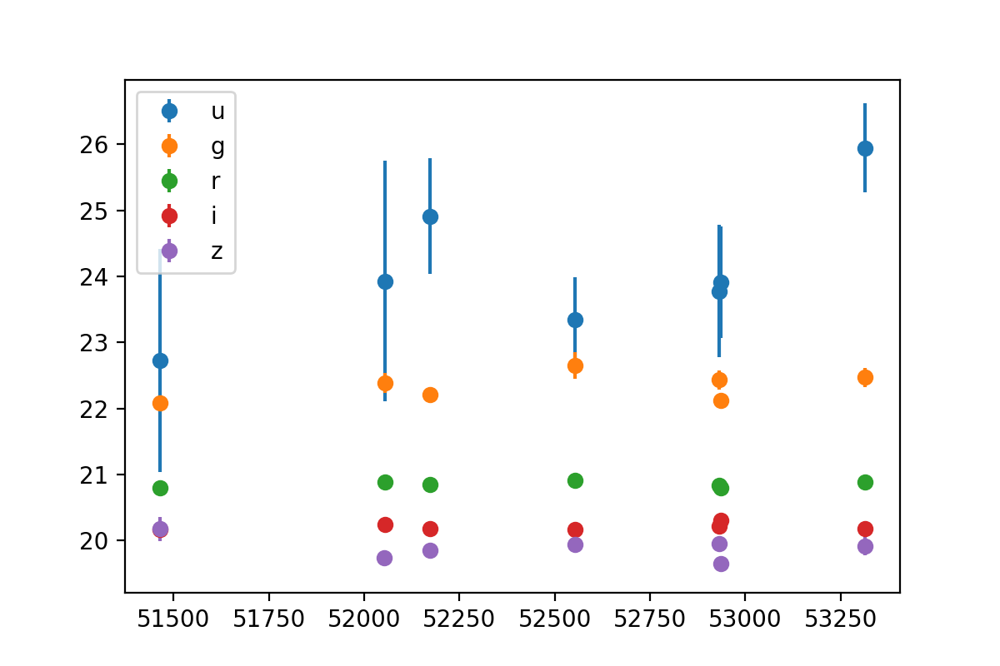

In [12]:
filters = ["u", "g", "r", "i", "z"]

fig, ax = plt.subplots(1, 1, figsize=(6,4))
for i in range(time.shape[1]):
    t = time[:,i]
    mag = psfmag[:,i]
    magerr = psfmagerr[:,i]
    
    ax.errorbar(t, mag, yerr=magerr, fmt="o", label=filters[i])
    
ax.legend()

Ok, cool, so I have a vague idea how this data works. 

Let's write a couple of function to read out r-band magnitudes:

In [13]:
def make_path(datadir, ra_dir, dec_dir, fname):
    f = datadir + "testLCdir/" + ra_dir + "/" + dec_dir + "/" + fname
    return f

In [14]:
def read_lc(fpath):
    d = np.loadtxt(fpath, skiprows=2)
    if len(d) == 0:
        return None
    if len(d.shape) < 2:
        return None
    ra = d[:, 1]
    dec = d[:, 2]
    mjd = d[:, 3]
    objctype = d[:, 4]
    objc_rowc = d[:, 5]
    objc_colc = d[:, 6]
    nchild = d[:, 7]
    rowc = d[:, 8:13]
    rowcerr = d[:, 13:18]
    colc = d[:, 18:23]
    colcerr = d[:, 23:28]
    psfmag = d[:, 28:33]
    psfmagerr = d[:, 33:38]
    modelmag = d[:, 38:43]
    modelmagerr = d[:, 43:48]
    tai = d[:, 48:53]
    taifrac = d[:, 53:58]
    airmass = d[:, 58:63]
    psf_fwhm = d[:, 63:68]
    skyflux = d[:, 68:73]
    
    data_dict = {"ra": ra, "dec":dec, "mjd":mjd, "tai":tai+taifrac, 
                 "u":psfmag[:,0], "g":psfmag[:,1], "r":psfmag[:,2], "i":psfmag[:,3], "z":psfmag[:,4],
                 "u_err":psfmagerr[:,0], "g_err":psfmagerr[:,1], "r_err":psfmagerr[:,2], "i_err":psfmagerr[:,3], 
                 "z_err":psfmagerr[:,4]}
    
    return data_dict

In [15]:
f = make_path(datadir, ra_dir, dec_dir, fname)

In [16]:
d = read_lc(f)

In [17]:
d

{'dec': array([-1.227721, -1.227721, -1.227721, -1.227721, -1.227721, -1.227721,
        -1.227721]),
 'g': array([22.0779, 22.4323, 22.3881, 22.6522, 22.4678, 22.1247, 22.2059]),
 'g_err': array([0.1132, 0.1429, 0.1495, 0.2022, 0.1435, 0.0964, 0.0892]),
 'i': array([20.1647, 20.2174, 20.2437, 20.1682, 20.1733, 20.3062, 20.1735]),
 'i_err': array([0.0478, 0.0398, 0.0437, 0.0343, 0.0472, 0.0376, 0.0327]),
 'mjd': array([51465., 52931., 52053., 52552., 53313., 52935., 52172.]),
 'r': array([20.7918, 20.8347, 20.8895, 20.9039, 20.8889, 20.7947, 20.8439]),
 'r_err': array([0.0548, 0.046 , 0.0557, 0.0473, 0.0546, 0.0405, 0.0358]),
 'ra': array([308.5002136, 308.5002136, 308.5002136, 308.5002136, 308.5002136,
        308.5002136, 308.5002136]),
 'tai': array([[51465.2612, 51465.2645, 51465.2579, 51465.2596, 51465.1315],
        [52931.1578, 52931.1612, 52931.1545, 52931.1562, 52931.0798],
        [52053.8546, 52053.8579, 52053.8513, 52053.8529, 52053.4283],
        [52552.335 , 52552.3384, 5

Ok, cool. Let's read out some light curves!

In [18]:
lst.shape

(1006849, 9)

In [19]:
# read out *all* light curves
n_lc = lst.shape[0]


In [20]:
lst.head()

,RA,Dec,RAdir,DecDir,LCfilename,N,ndata,rms_r,med_r
SSctr,,,,,,,,,
1,308.500214,-1.227721,RAm051,Dm012,LC_RA308.500214_Dm1.227721.dat,9,7.0,0.055227,20.8439
2,308.500092,-1.240264,RAm051,Dm012,LC_RA308.500092_Dm1.240264.dat,9,7.0,0.051743,19.7725
3,308.500092,-1.217156,RAm051,Dm012,LC_RA308.500092_Dm1.217156.dat,9,7.0,0.009044,17.3291
4,308.501892,-1.176492,RAm051,Dm011,LC_RA308.501892_Dm1.176492.dat,9,7.0,0.021720,17.5600
5,308.504608,-1.174189,RAm051,Dm011,LC_RA308.504608_Dm1.174189.dat,9,7.0,0.059675,21.3103


In [21]:
lst.loc[lst.index, "ndata"] = np.zeros(len(lst))

In [492]:
lst.loc[lst.index, "rms_r"] = np.zeros(len(lst))
lst.loc[lst.index, "med_r"] = np.zeros(len(lst))

In [493]:
lst.head()

,RA,Dec,RAdir,DecDir,LCfilename,N,ndata,rms_r,med_r
SSctr,,,,,,,,,
1,308.500214,-1.227721,RAm051,Dm012,LC_RA308.500214_Dm1.227721.dat,9,0.0,0.0,0.0
2,308.500092,-1.240264,RAm051,Dm012,LC_RA308.500092_Dm1.240264.dat,9,0.0,0.0,0.0
3,308.500092,-1.217156,RAm051,Dm012,LC_RA308.500092_Dm1.217156.dat,9,0.0,0.0,0.0
4,308.501892,-1.176492,RAm051,Dm011,LC_RA308.501892_Dm1.176492.dat,9,0.0,0.0,0.0
5,308.504608,-1.174189,RAm051,Dm011,LC_RA308.504608_Dm1.174189.dat,9,0.0,0.0,0.0


Let's update the file with the number of (good) data points in each data set, the rms and the median in the r-band, so I can easily filter the light curves I'm interested in without looping through the entire thing every time:

In [32]:
def read_lc(fpath):
    d = np.loadtxt(fpath, skiprows=2)
    if len(d) == 0:
        return None
    if len(d.shape) < 2:
        return None
    ra = d[:, 1]
    dec = d[:, 2]
    mjd = d[:, 3]
    objctype = d[:, 4]
    objc_rowc = d[:, 5]
    objc_colc = d[:, 6]
    nchild = d[:, 7]
    rowc = d[:, 8:13]
    rowcerr = d[:, 13:18]
    colc = d[:, 18:23]
    colcerr = d[:, 23:28]
    psfmag = d[:, 28:33]
    psfmagerr = d[:, 33:38]
    modelmag = d[:, 38:43]
    modelmagerr = d[:, 43:48]
    tai = d[:, 48:53]
    taifrac = d[:, 53:58]
    airmass = d[:, 58:63]
    psf_fwhm = d[:, 63:68]
    skyflux = d[:, 68:73]

    # get out only data points that are real:
    mask_u = (psfmag[:,0] >= 13) & (psfmag[:,0] <= 23)
    mask_g = (psfmag[:,1] >= 13) & (psfmag[:,1] <= 23)
    mask_r = (psfmag[:,2] >= 13) & (psfmag[:,2] <= 23)
    mask_i = (psfmag[:,3] >= 13) & (psfmag[:,3] <= 23)
    mask_z = (psfmag[:,4] >= 13) & (psfmag[:,4] <= 23)


    data_dict = {"ra": ra, "dec":dec,  "tai_u": tai[mask_u,0]+taifrac[mask_u, 0],
                 "tai_g": tai[mask_g,0]+taifrac[mask_g, 0],
                 "tai_r": tai[mask_r,0]+taifrac[mask_r, 0],
                 "tai_i": tai[mask_i,0]+taifrac[mask_i, 0],
                 "tai_z": tai[mask_z,0]+taifrac[mask_z, 0],
                 "u":psfmag[mask_u,0], "g":psfmag[mask_g,1], "r":psfmag[mask_r,2], "i":psfmag[mask_i,3], "z":psfmag[mask_z,4],
                 "u_err":psfmagerr[mask_u,0], "g_err":psfmagerr[mask_g,1], "r_err":psfmagerr[mask_r,2], "i_err":psfmagerr[mask_i,3],
                 "z_err":psfmagerr[mask_z,4]}

    data_dict = calculate_variability_measures(data_dict)

    return data_dict

def calculate_variability_measures(d):
    """
    Calculate median, mean and rms of each band in the data set.

    Parameters
    ----------
    d : dict
        Dictionary with the magnitudes

    """

    if len(d["u"]) > 1:
        d["mean_u"] = np.mean(d["u"])
        d["var_u"] = np.var(d["u"])
        d["rms_u"] = 0.7413*(np.percentile(d["u"], 75)-np.percentile(d["u"], 25))
        d["med_u"] = np.median(d["u"])

    if len(d["g"]) > 1:
        d["mean_g"] = np.mean(d["g"])
        d["var_g"] = np.var(d["g"])
        d["rms_g"] = 0.7413*(np.percentile(d["g"], 75)-np.percentile(d["g"], 25))
        d["med_g"] = np.median(d["g"])


    if len(d["r"]) > 1:
        d["mean_r"] = np.mean(d["r"])
        d["var_r"] = np.var(d["r"])
        d["rms_r"] = 0.7413*(np.percentile(d["r"], 75)-np.percentile(d["r"], 25))
        d["med_r"] = np.median(d["r"])

    if len(d["i"]) > 1:
        d["mean_i"] = np.mean(d["i"])
        d["var_i"] = np.var(d["i"])
        d["rms_i"] = 0.7413*(np.percentile(d["i"], 75)-np.percentile(d["i"], 25))
        d["med_i"] = np.median(d["i"])

    if len(d["z"]) > 1:
        d["mean_z"] = np.mean(d["z"])
        d["var_z"] = np.var(d["z"])
        d["rms_z"] = 0.7413*(np.percentile(d["z"], 75)-np.percentile(d["z"], 25))
        d["med_z"] = np.median(d["z"])

    return d


In [33]:
data_all = []
# loop over all light curves:
for i in range(1, n_lc):
    # sub-dir named after RA
    ra_dir = lst.loc[i, "RAdir"]
    # sub-dir named after Dec
    dec_dir = lst.loc[i, "DecDir"]
    # actual name of the file
    fname = lst.loc[i, "LCfilename"]

    # put together the path
    f = make_path(datadir, ra_dir, dec_dir, fname)

    # read the data and return as dictionary
    data = read_lc(f)

    # if there's actual data in the file, 
    # check whether it contains at least 50 
    # data points, and if it does, include in 
    # data set        
    if data is not None:
        if len(data["r"]) > 1:
            # first try bright stars with lots of data points, but not 
            # such a high rms
            #print("data keys: " + str(data.keys()) + "\n")
            lst.loc[i, "ndata"] = len(data["r"])
            lst.loc[i, "rms_r"] = data["rms_r"]
            lst.loc[i, "med_r"] = data["med_r"]
    else:
        continue

KeyboardInterrupt: 

In [523]:
lst.to_csv(datadir+"LC_dirs_fils_new.lst", sep="\t")

Ok, cool, let's get out a few light curves that have some useful properties and look at them:

In [23]:
lst_new = lst[(lst["ndata"] >= 40) & (lst["rms_r"] <= 0.01) & (lst["med_r"] <= 20)]

In [24]:
len(lst_new)

41

First we need to read out those light curves from file:

In [34]:
data_all = []
# loop over all light curves:
for i in lst_new.index:
    # sub-dir named after RA
    ra_dir = lst_new.loc[i, "RAdir"]
    # sub-dir named after Dec
    dec_dir = lst_new.loc[i, "DecDir"]
    # actual name of the file
    fname = lst_new.loc[i, "LCfilename"]

    # put together the path
    f = make_path(datadir, ra_dir, dec_dir, fname)

    # read the data and return as dictionary
    data = read_lc(f)

    # if there's actual data in the file, 
    # check whether it contains at least 50 
    # data points, and if it does, include in 
    # data set
    data["filename"] = f
    data_all.append(data)


In [35]:
len(data_all)

41

In [36]:
data_all[0].keys()

dict_keys(['ra', 'dec', 'tai_u', 'tai_g', 'tai_r', 'tai_i', 'tai_z', 'u', 'g', 'r', 'i', 'z', 'u_err', 'g_err', 'r_err', 'i_err', 'z_err', 'mean_u', 'var_u', 'rms_u', 'med_u', 'mean_g', 'var_g', 'rms_g', 'med_g', 'mean_r', 'var_r', 'rms_r', 'med_r', 'mean_i', 'var_i', 'rms_i', 'med_i', 'mean_z', 'var_z', 'rms_z', 'med_z', 'filename'])

Let's plot those light curves:

<IPython.core.display.Javascript object>


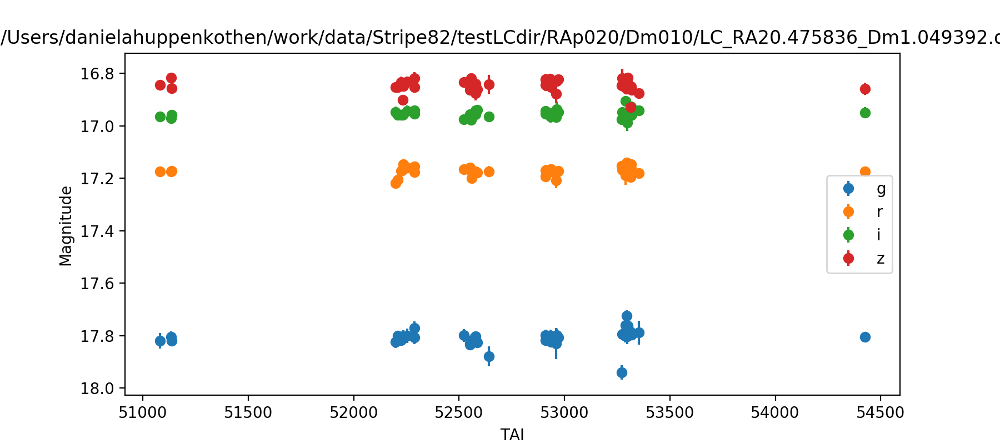

<IPython.core.display.Javascript object>


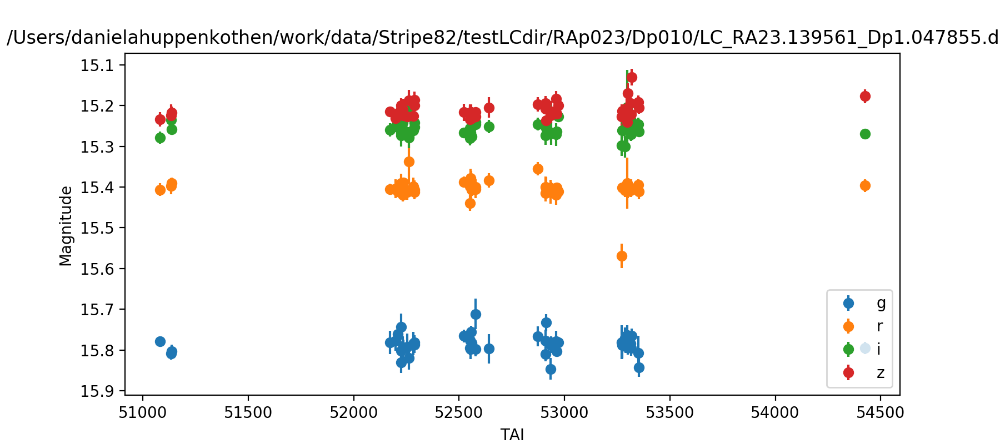

<IPython.core.display.Javascript object>


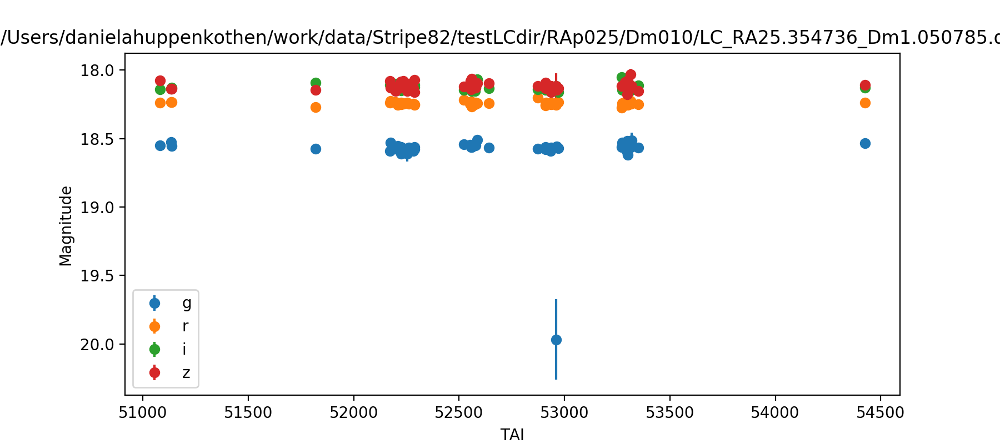

<IPython.core.display.Javascript object>


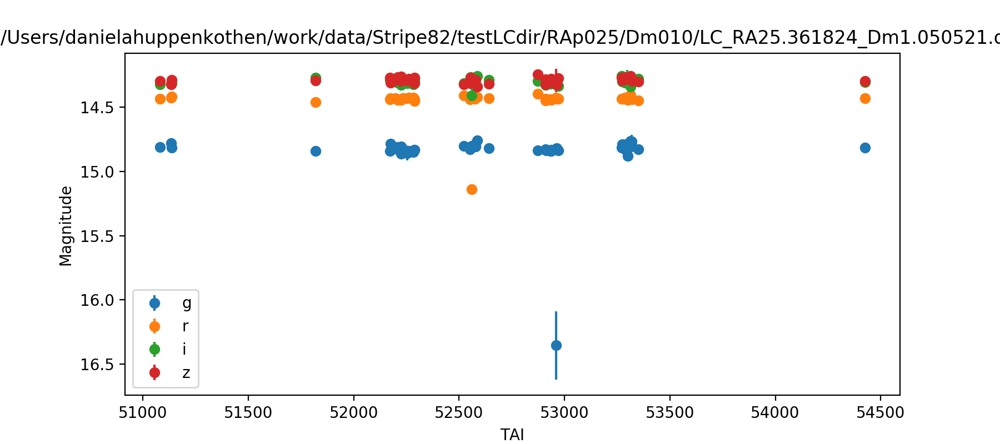

<IPython.core.display.Javascript object>


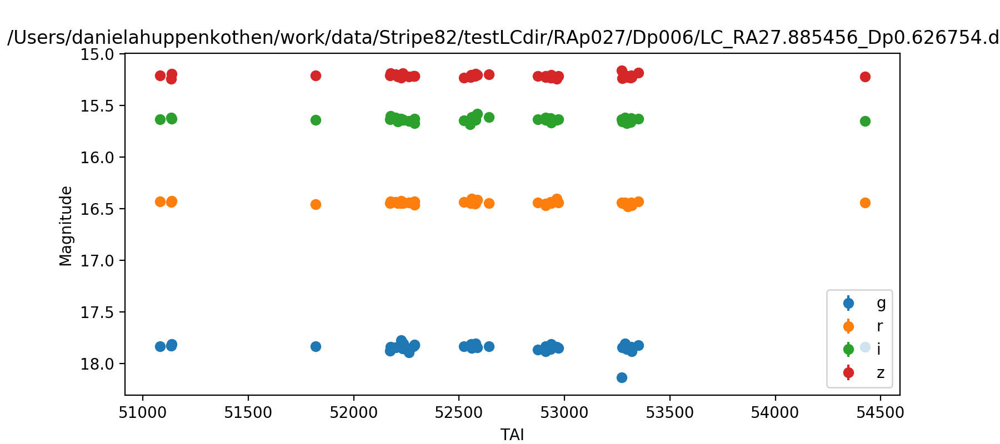

<IPython.core.display.Javascript object>


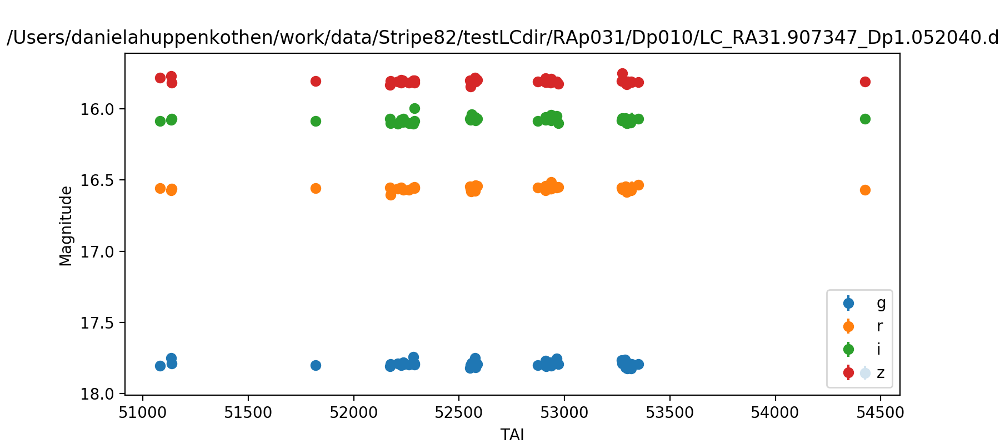

<IPython.core.display.Javascript object>


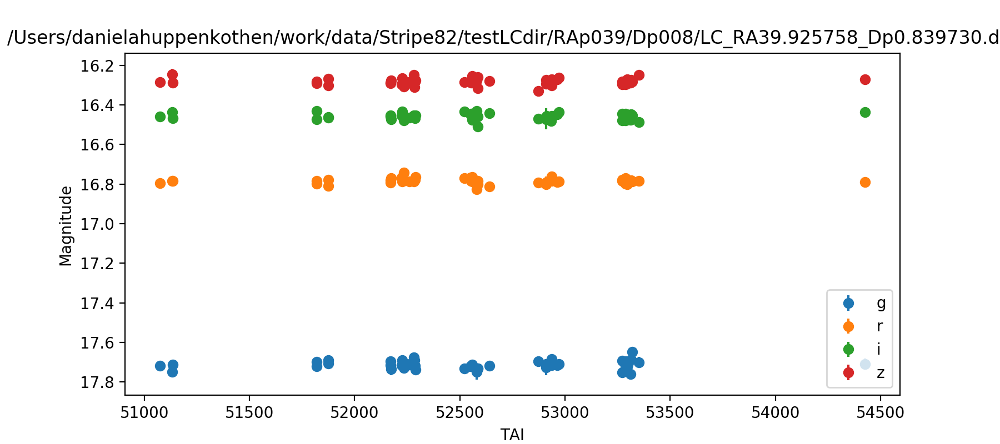

<IPython.core.display.Javascript object>


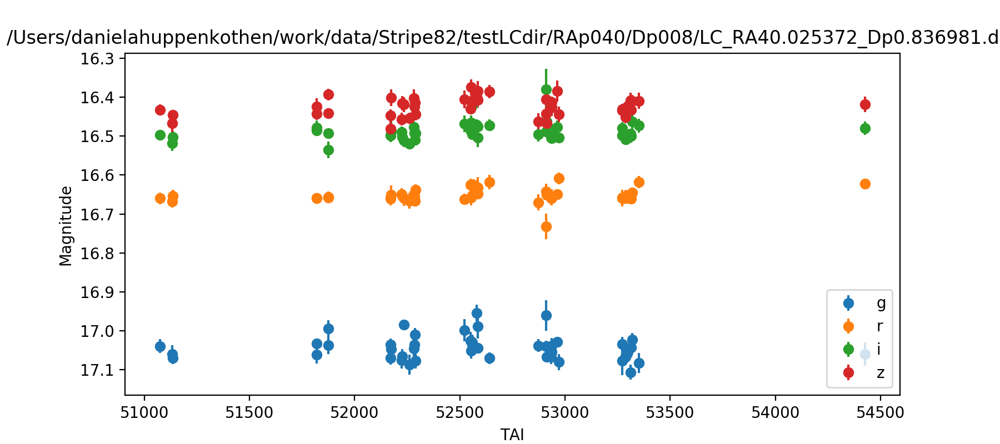

<IPython.core.display.Javascript object>


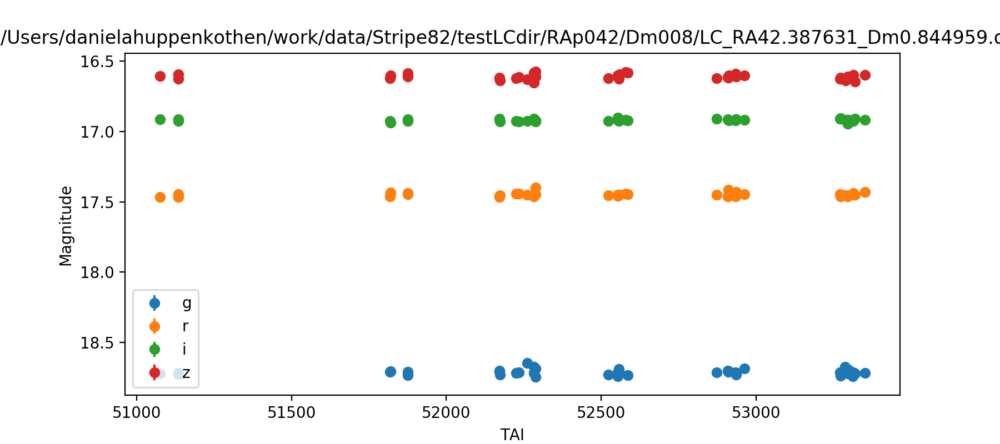

<IPython.core.display.Javascript object>


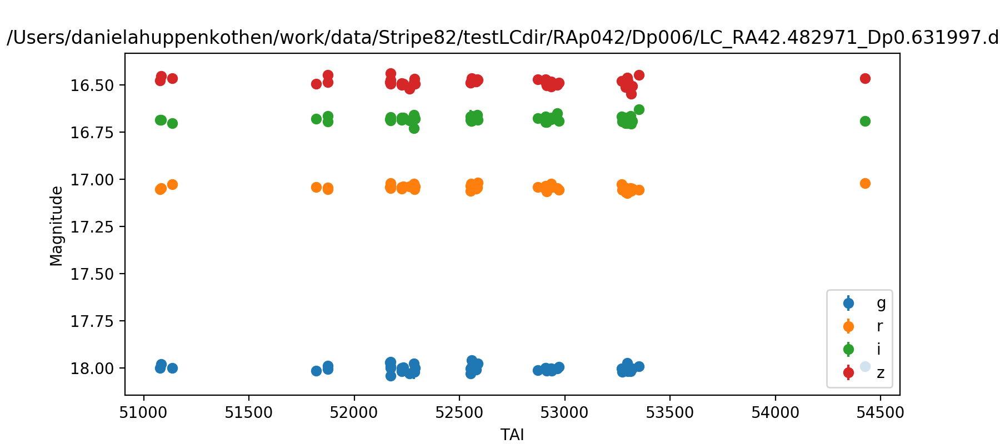

<IPython.core.display.Javascript object>


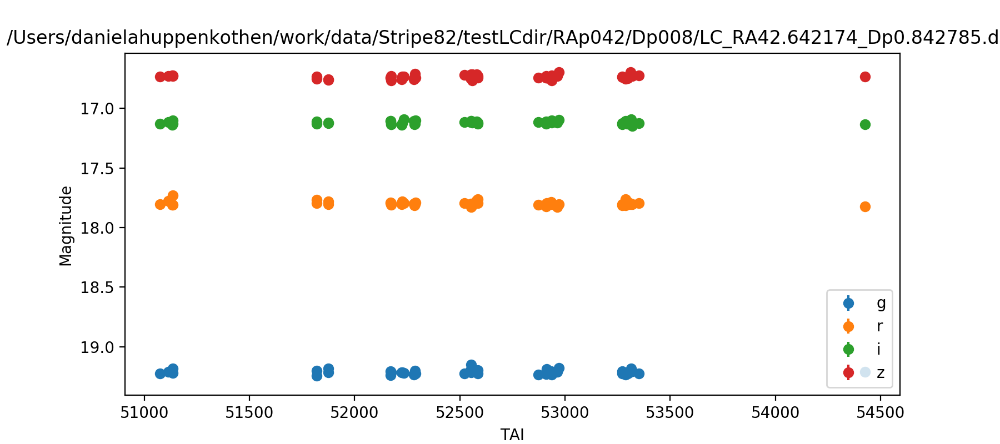

<IPython.core.display.Javascript object>


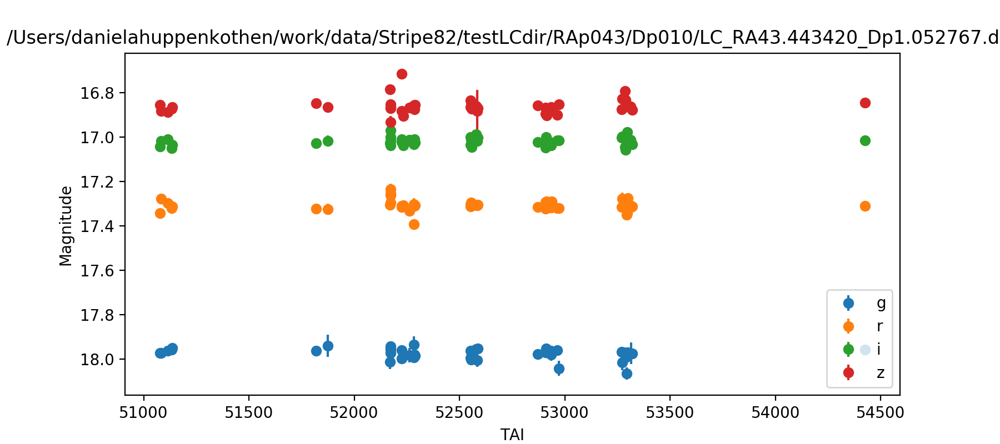

<IPython.core.display.Javascript object>


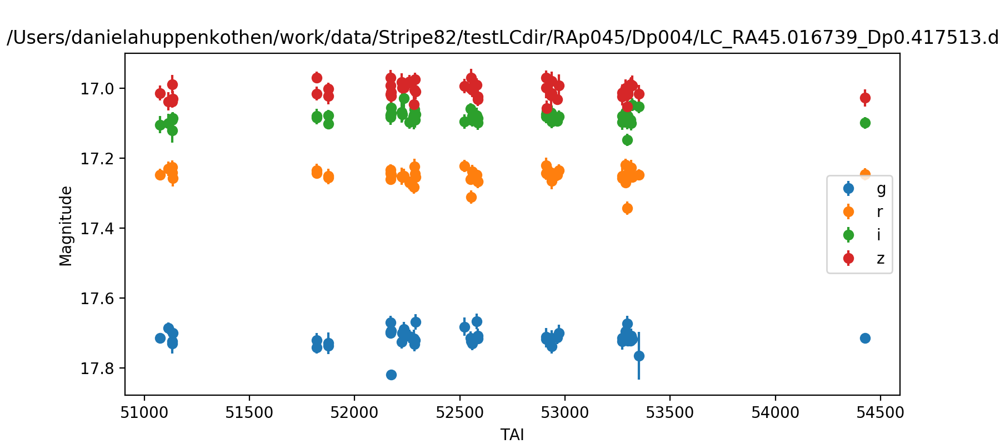

<IPython.core.display.Javascript object>


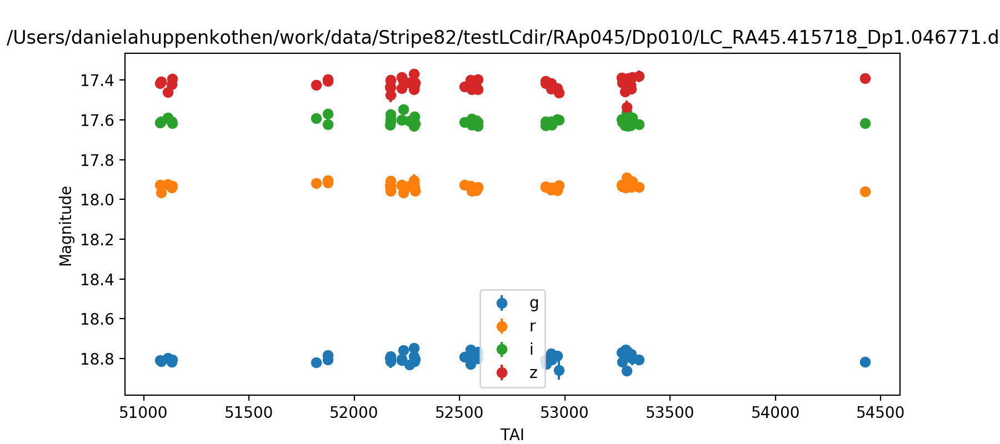

<IPython.core.display.Javascript object>


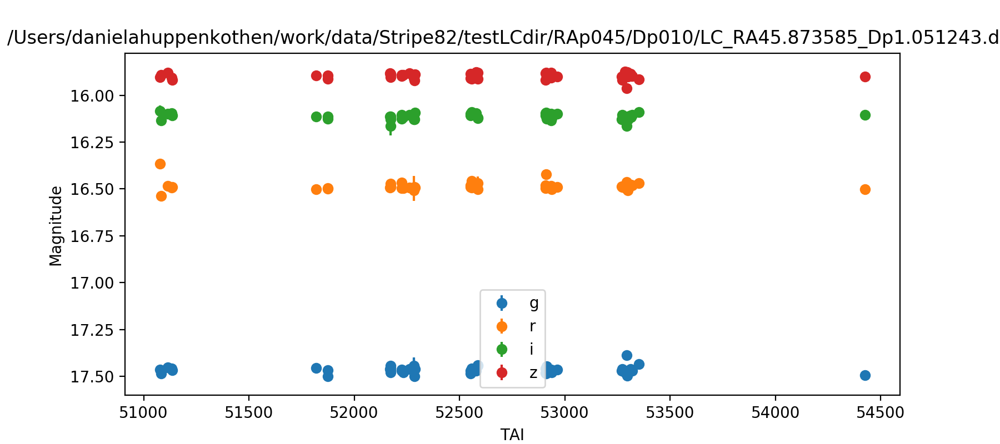

<IPython.core.display.Javascript object>


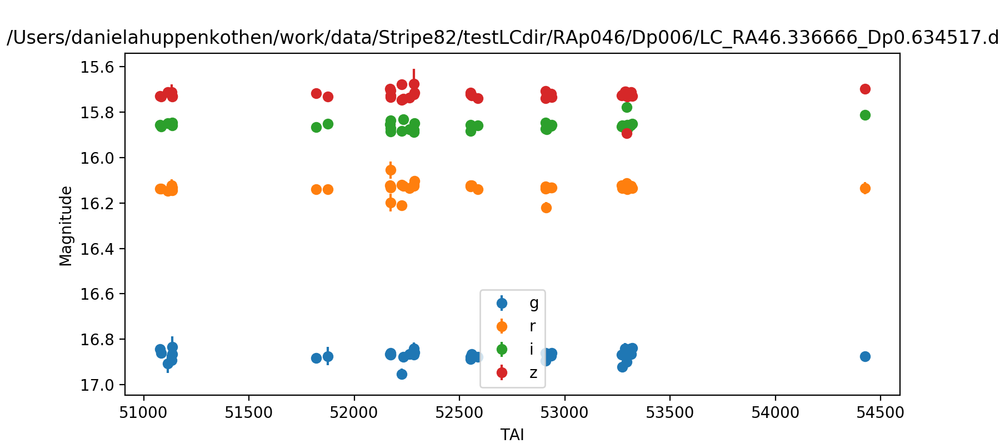

<IPython.core.display.Javascript object>


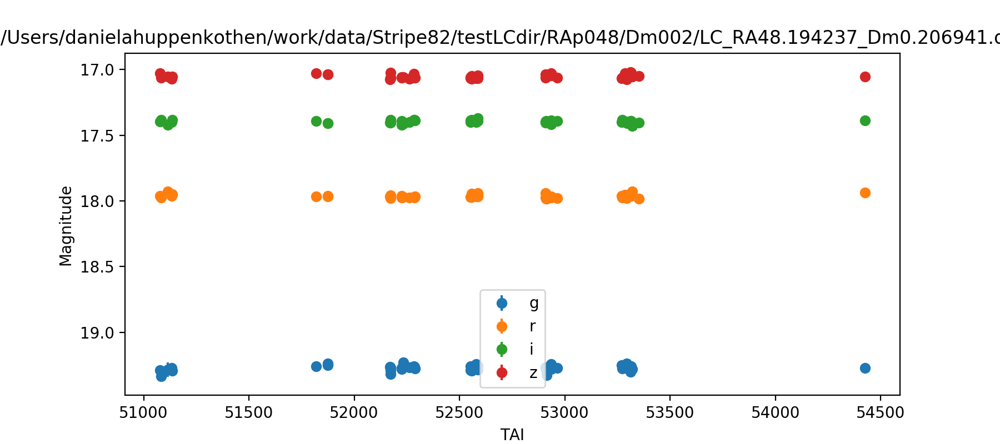

<IPython.core.display.Javascript object>


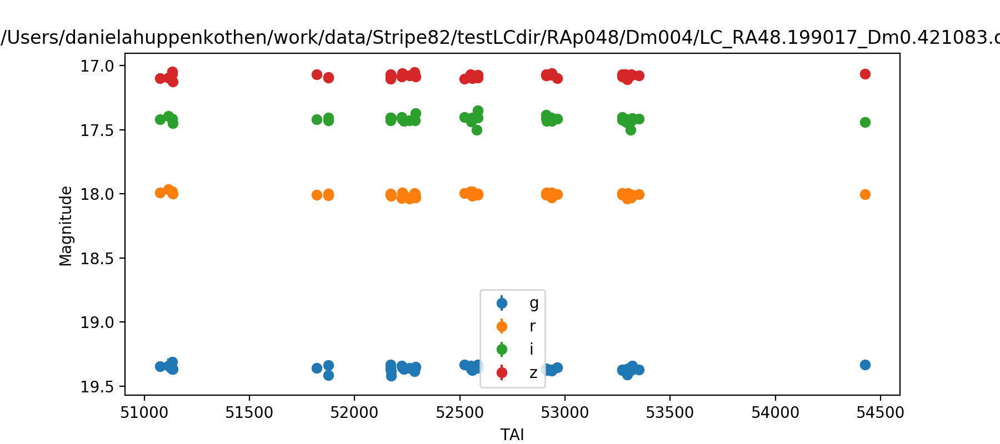

<IPython.core.display.Javascript object>


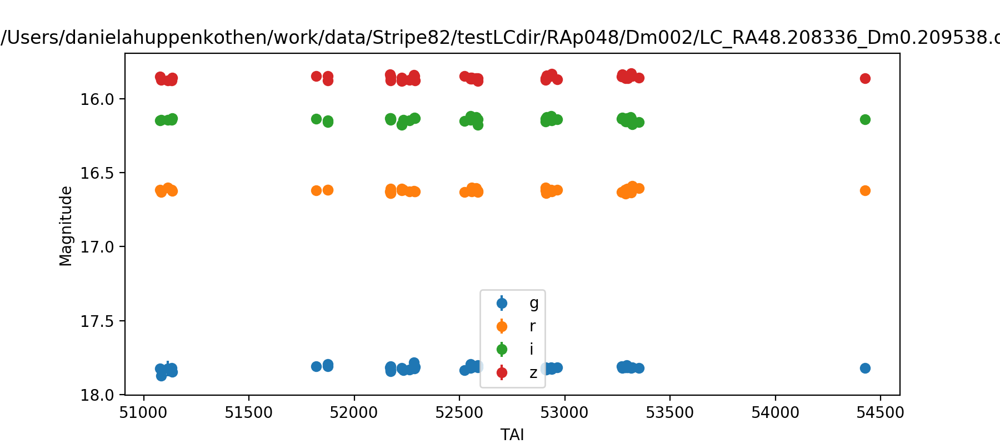

/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


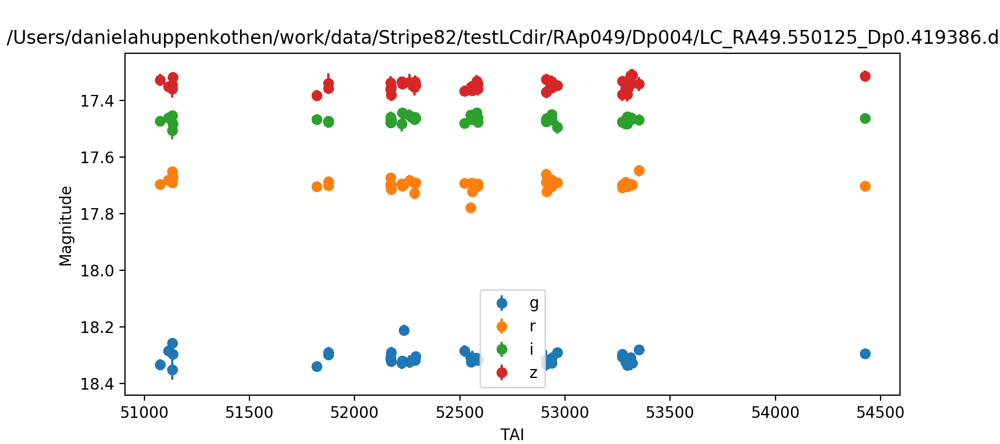

<IPython.core.display.Javascript object>


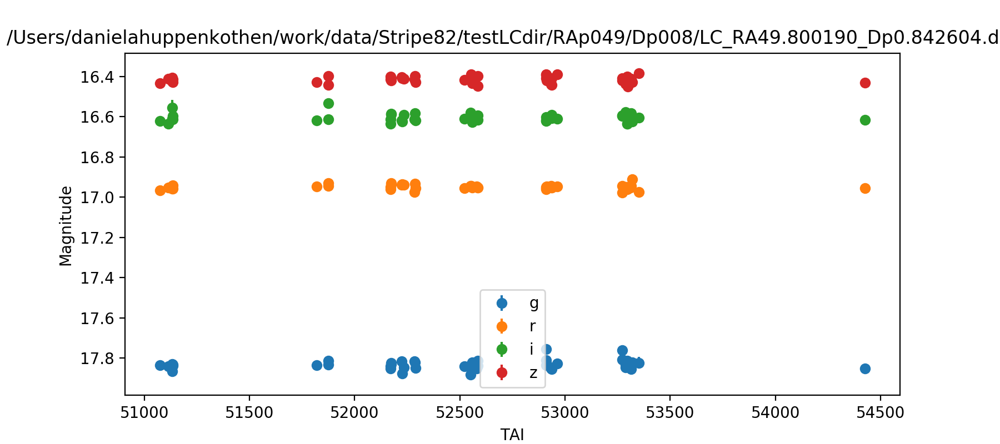

<IPython.core.display.Javascript object>


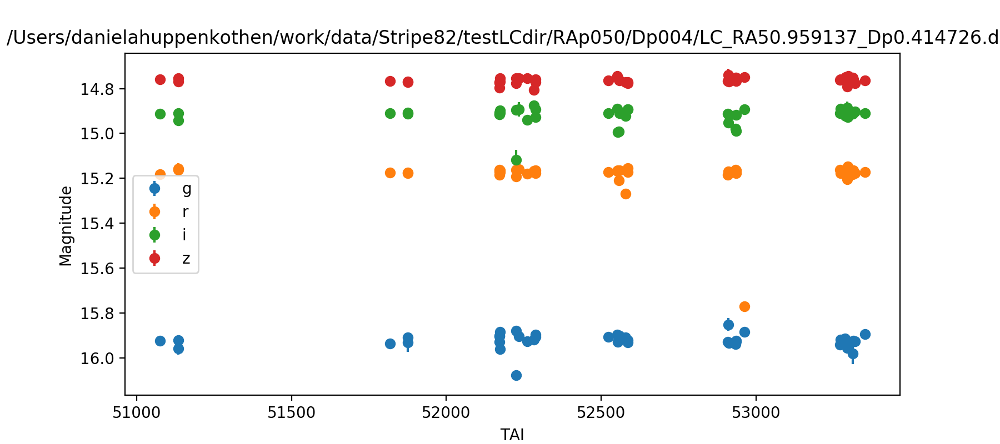

<IPython.core.display.Javascript object>


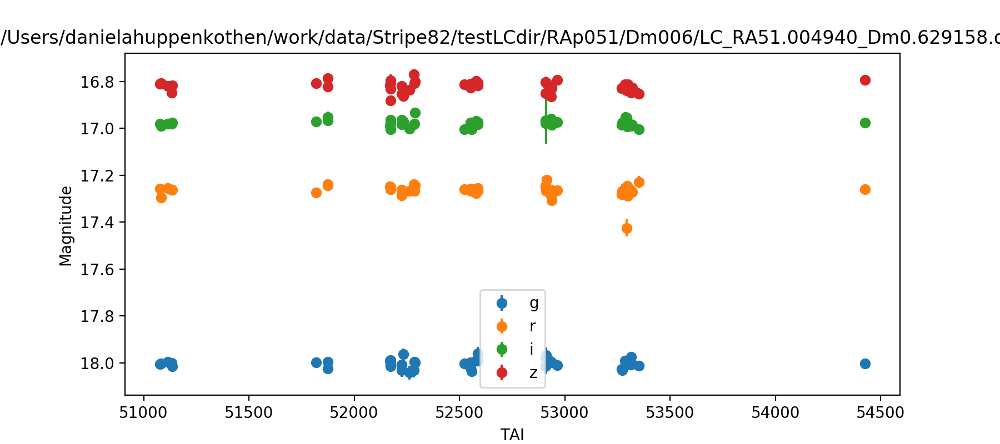

<IPython.core.display.Javascript object>


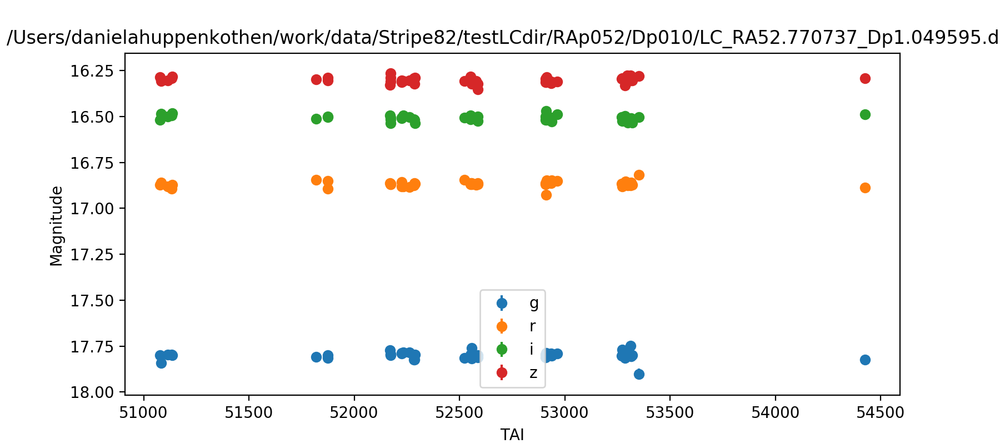

<IPython.core.display.Javascript object>


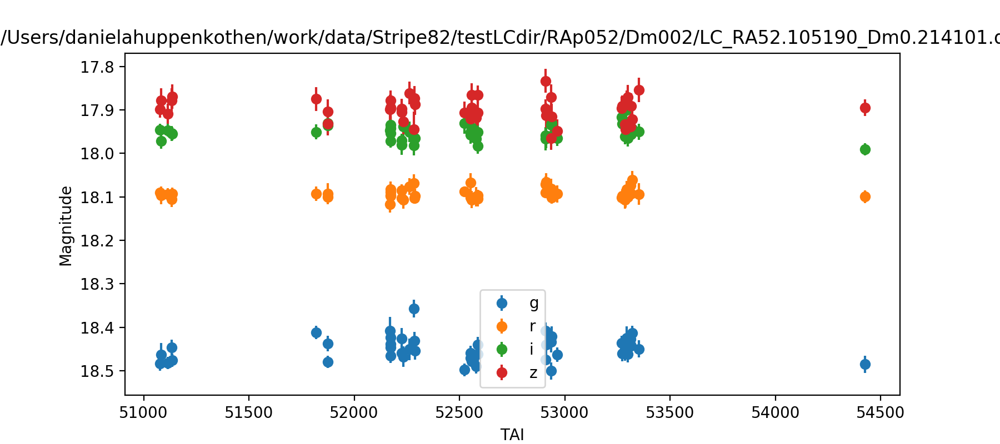

<IPython.core.display.Javascript object>


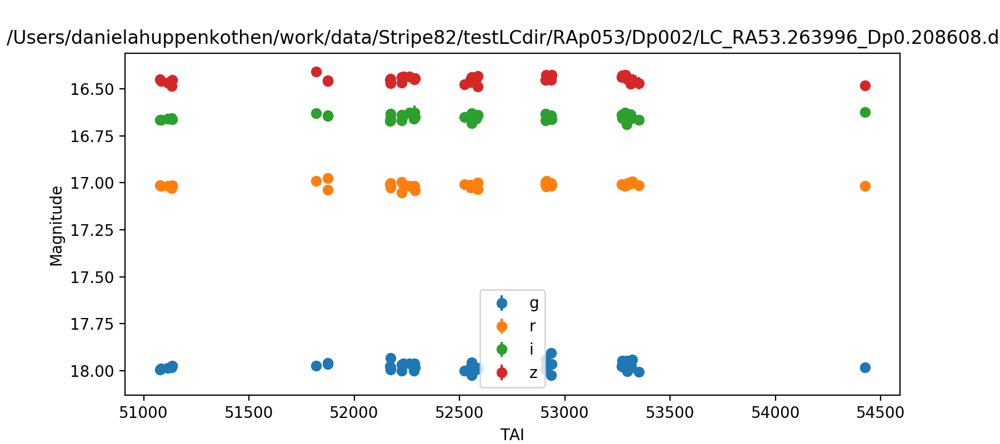

<IPython.core.display.Javascript object>


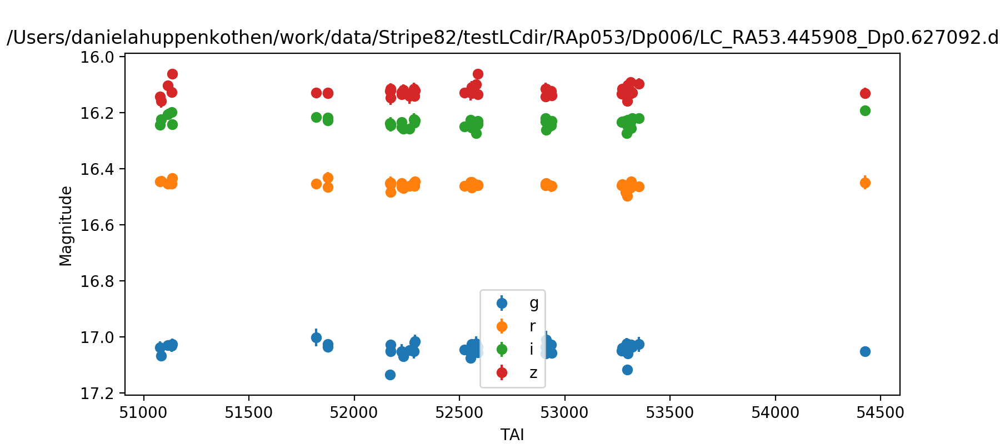

<IPython.core.display.Javascript object>


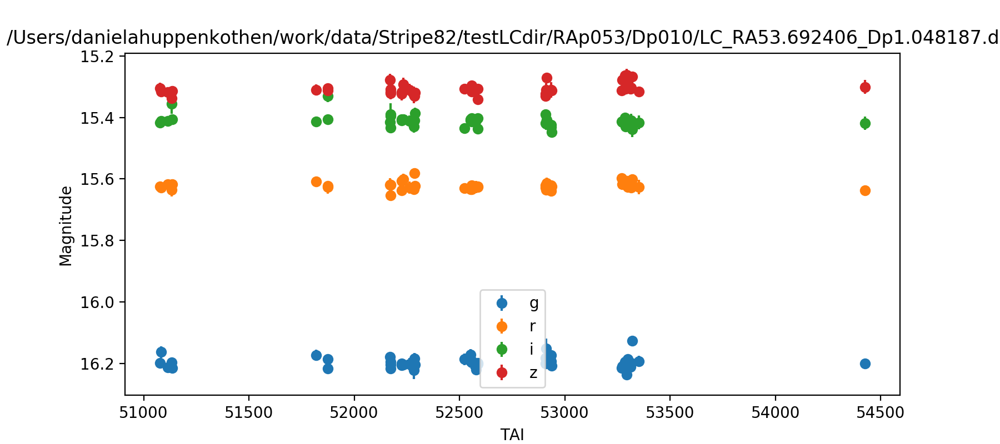

<IPython.core.display.Javascript object>


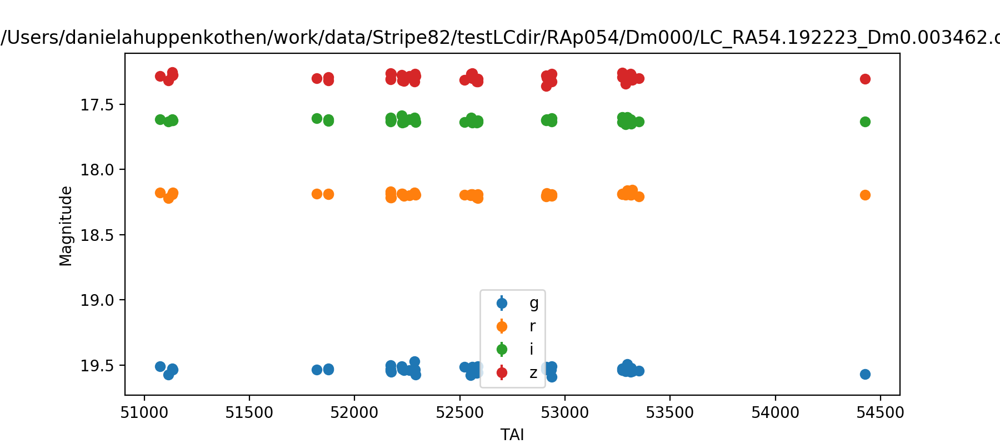

<IPython.core.display.Javascript object>


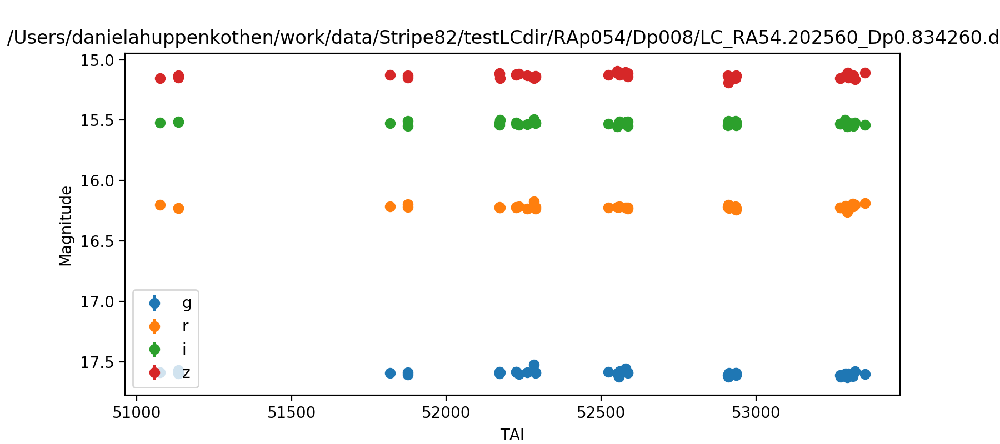

<IPython.core.display.Javascript object>


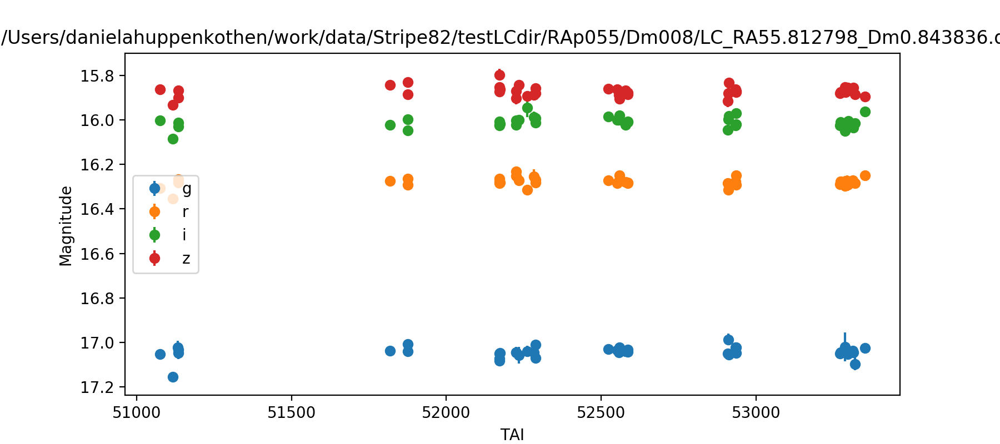

<IPython.core.display.Javascript object>


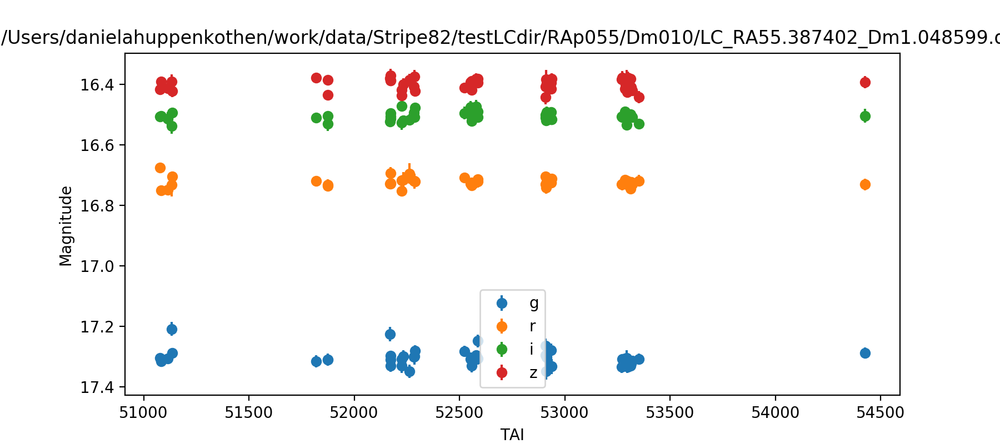

<IPython.core.display.Javascript object>


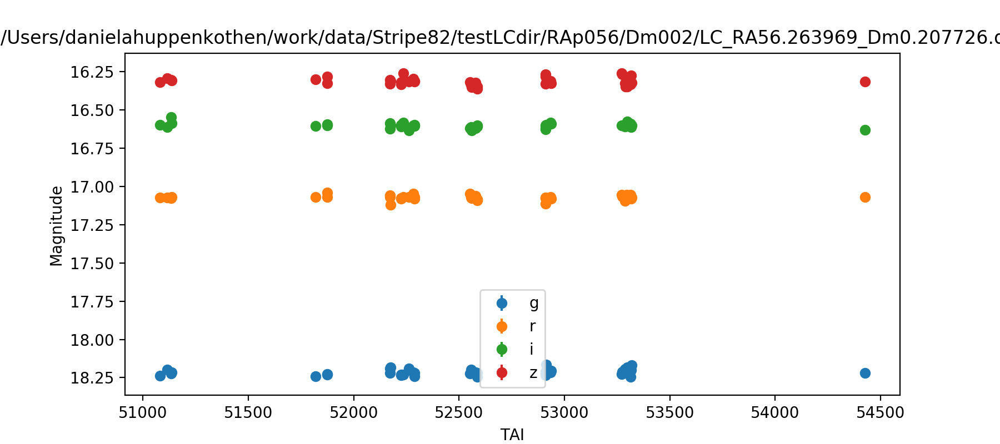

<IPython.core.display.Javascript object>


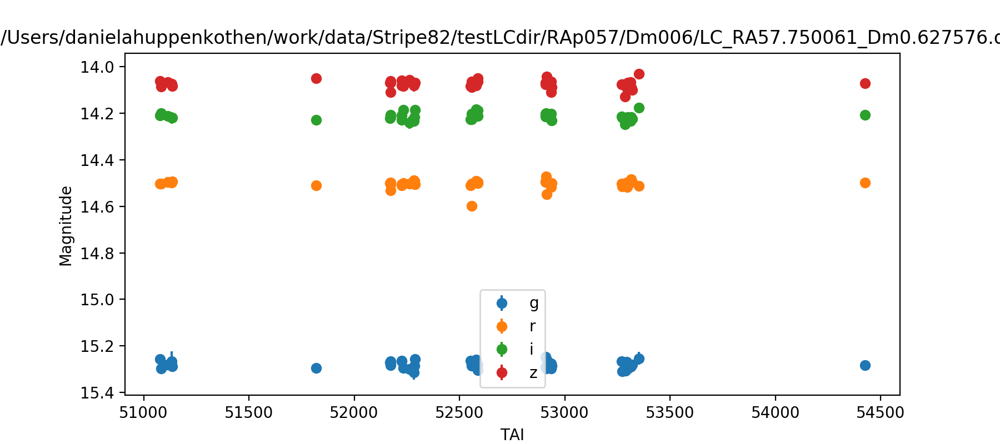

<IPython.core.display.Javascript object>


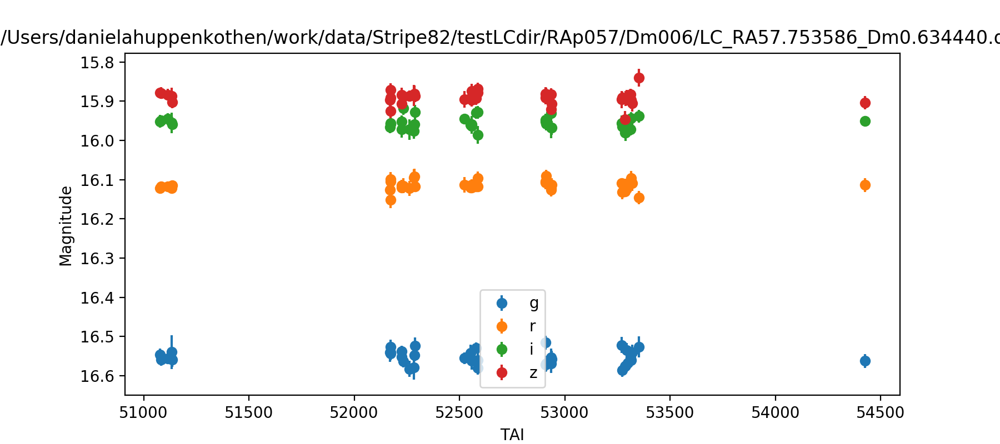

<IPython.core.display.Javascript object>


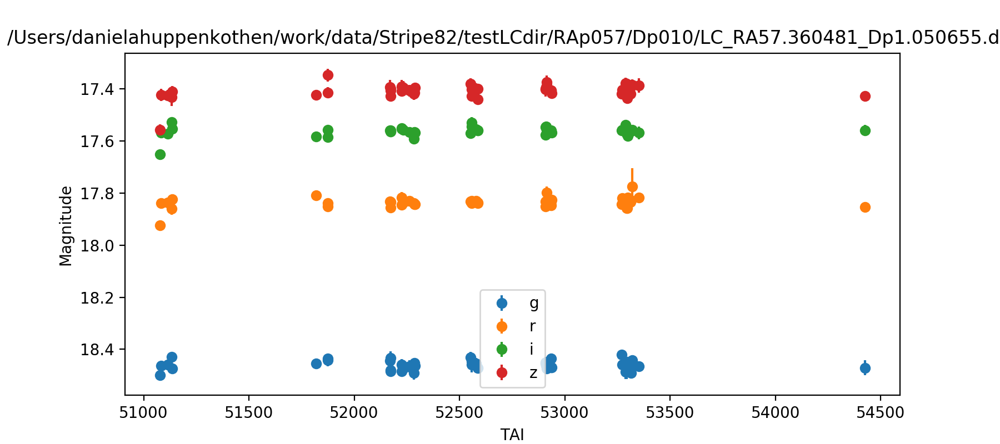

<IPython.core.display.Javascript object>


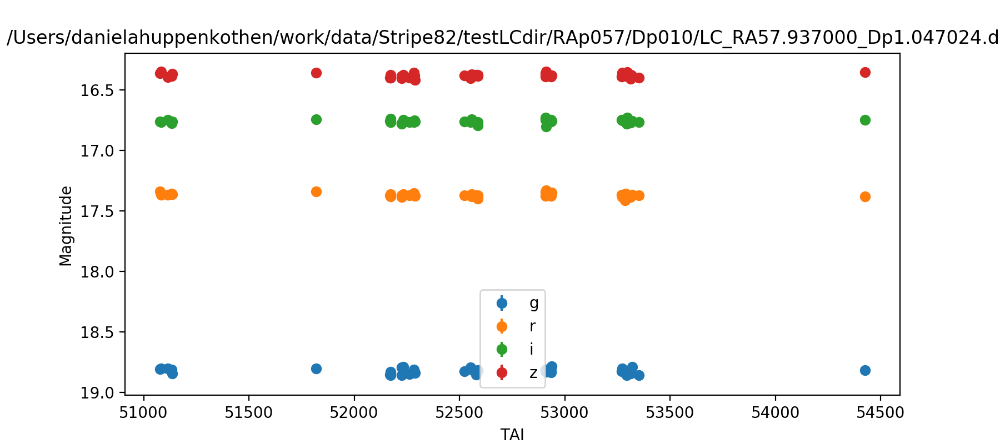

<IPython.core.display.Javascript object>


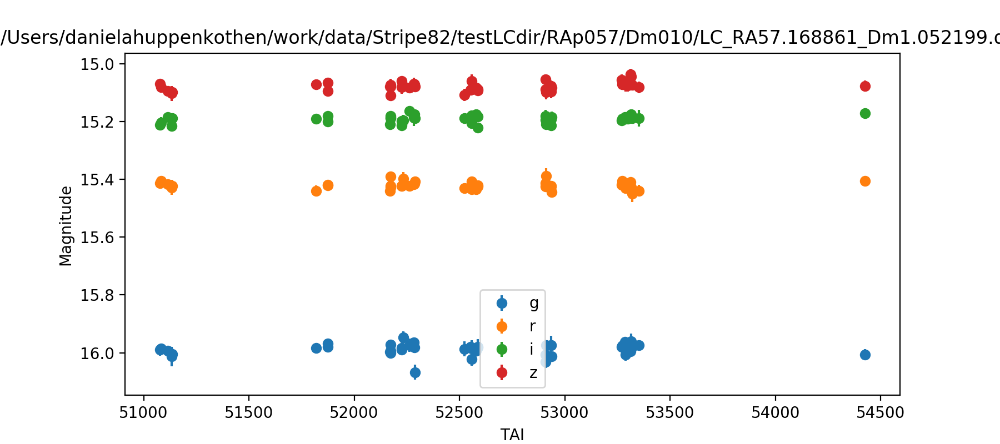

<IPython.core.display.Javascript object>


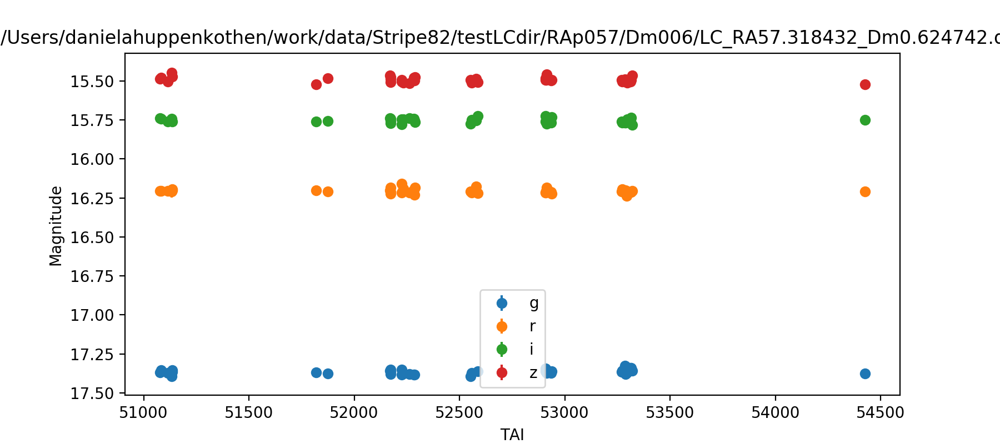

<IPython.core.display.Javascript object>


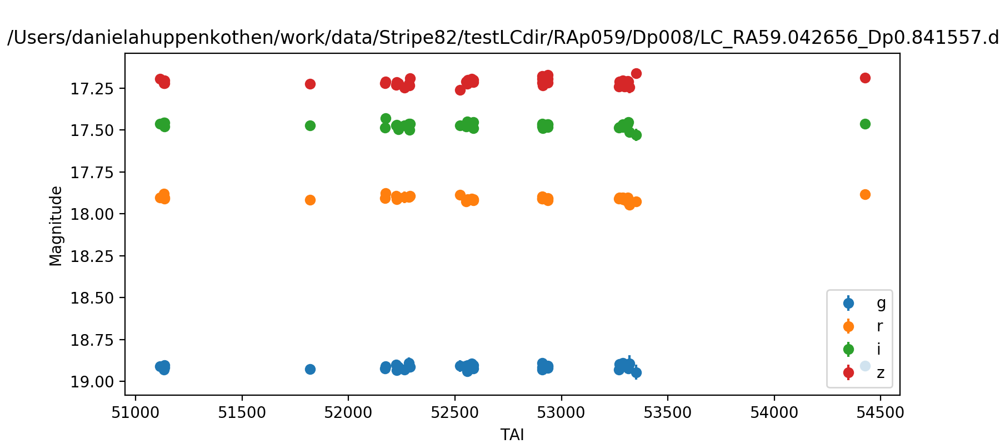

<IPython.core.display.Javascript object>


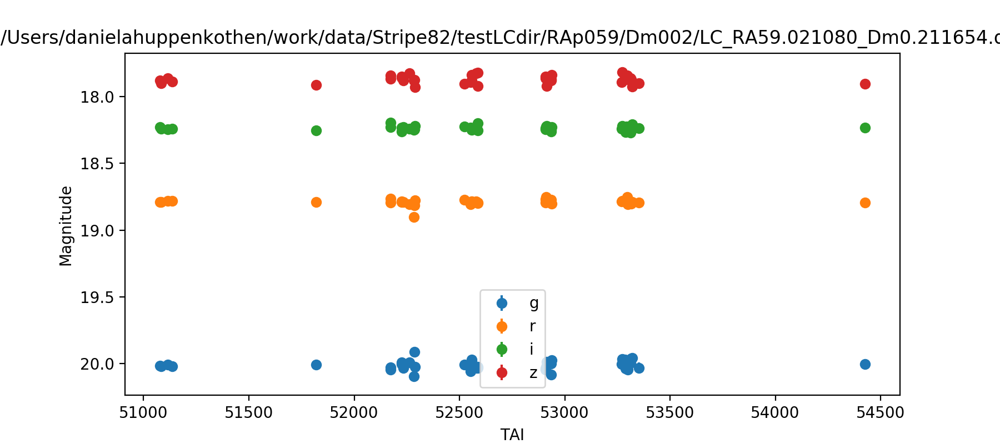

In [39]:
for d in data_all:
    fig, ax = plt.subplots(1,1, figsize=(9,4))
    #ax.errorbar(d["tai"][:,0], d["u"], yerr=d["u_err"], fmt="o", label="u")
    ax.errorbar(d["tai_g"], d["g"], yerr=d["g_err"], fmt="o", label="g")
    ax.errorbar(d["tai_r"], d["r"], yerr=d["r_err"], fmt="o", label="r")
    ax.errorbar(d["tai_i"], d["i"], yerr=d["i_err"], fmt="o", label="i")
    ax.errorbar(d["tai_z"], d["z"], yerr=d["z_err"], fmt="o", label="z")
    ax.set_ylim(ax.get_ylim()[::-1])
    ax.set_xlabel("TAI")
    ax.set_ylabel("Magnitude")
    ax.set_title(d["filename"])
    ax.legend()
    #fig.savefig(datadir+d["filename"][:-4]+".pdf", format="pdf")
    #plt.close()

Awesome. Now we want to make a Lomb-Scargle periodogram and look at it.

In [40]:
d = data_all[0]

In [41]:
tai = d["tai_r"]
rmag = d["r"]
rerr = d["r_err"]

In [42]:
from gatspy import periodic

In [80]:
from astropy.stats import LombScargle

In [81]:
ls = LombScargle(tai, rmag, rerr)

In [90]:
p_min = 1.0/24.0 # smallest period to search is 1 hour
p_max = np.max(tai) - np.min(tai) # largest period to search is T

In [91]:
oversampling = 5 # factor of oversampling the peaks
nfreq = int(oversampling*(p_max - p_min)/p_min) # number of frequencies

In [93]:
freq = np.linspace(1/p_max, 1/p_min, nfreq)

In [94]:
power = ls.power(freq)

Let's compare the implementation to gatspy:

In [45]:
model = periodic.LombScargle(fit_period=True, center_data=True, fit_offset=True)
model.optimizer.period_range = (p_min, p_max)

In [46]:
model.fit(tai, rmag, rerr)

Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000376
 - User-specified period range:  0.042 to 3.3e+03
 - Computing periods at 401129 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps


In [65]:
freqs = np.linspace(1/p_max, 1/p_min, nfreq)

In [66]:
1/p_max

0.00029915265011853974

In [67]:
periods = 1/freqs

In [68]:
import warnings

In [69]:
with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        scores = model.score(periods)

In [70]:
per = model.periodogram(periods)

/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


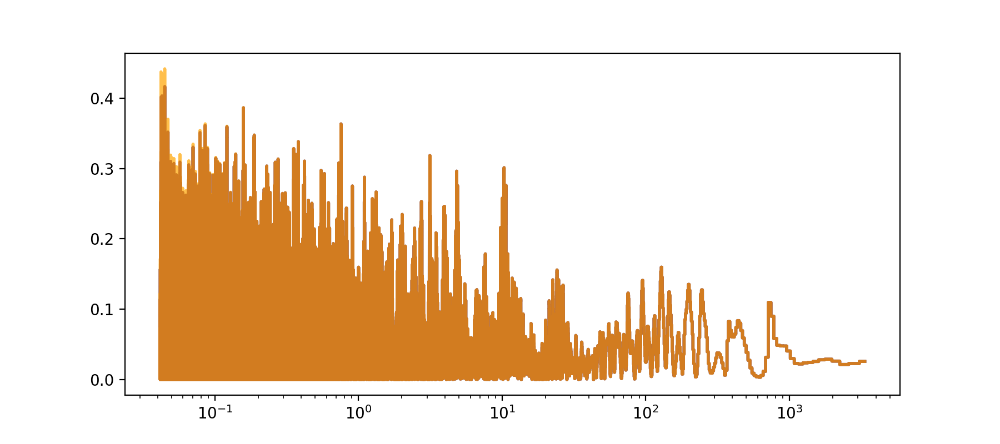

In [96]:
fix, ax = plt.subplots(1, 1, figsize=(9,4))

ax.semilogx(periods, scores, lw=2, color="black", linestyle="steps-mid", alpha=0.7)
ax.semilogx(periods, per, lw=2, color="purple", linestyle="steps-mid", alpha=0.6)

ax.semilogx(periods, power, lw=2, color="orange", linestyle="steps-mid", alpha=0.7)

Let's continue with the astropy implementation so that we can figure out how to determine the false-alarm probability:

In [100]:
ls.false_alarm_probability(power.max(), minimum_frequency=1/p_max, maximum_frequency=1/p_min)

0.9668740432553596

In [98]:
power.max()

0.44161084929601796

In [102]:
lev = ls.false_alarm_level(0.01, minimum_frequency=1/p_max, maximum_frequency=1/p_min)

In [103]:
lev

array(0.59574747)

/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


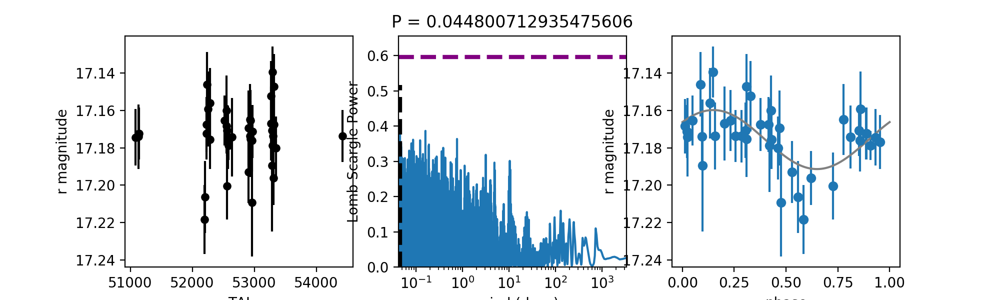

In [108]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10, 3))
ax1.errorbar(tai, rmag, yerr=rerr, fmt="o", markersize=5, c="black")
ax1.invert_yaxis()
ax1.set_xlabel("TAI")
ax1.set_ylabel("r magnitude")

ax2.plot(periods, scores)
ax2.set(xlabel='period (days)', ylabel='Lomb Scargle Power',
       xlim=(p_min, p_max))
ax2.set_xscale("log")
ax2.vlines(model.best_period, 0, np.max(scores)+0.1, lw=3, linestyle="dashed", color="black", zorder=10)
ax2.set_title("P = " + str(model.best_period))
ax2.hlines(lev, p_min, p_max, lw=3, color="purple", linestyle="dashed")
ax2.set_ylim(0, np.max([np.max(scores), lev])*1.1)

period = model.best_period

tfit = np.linspace(0, period, 1000)
magfit = model.predict(tfit)

# Plot the results
phase = (tai / period) % 1
phasefit = (tfit / period)

ax3.errorbar(phase, rmag, rerr, fmt='o')
ax3.plot(phasefit, magfit, '-', color='gray')
ax3.set(xlabel='phase', ylabel='r magnitude')
ax3.invert_yaxis()



In [ ]:
for i,d in enumerate(data_tosearch):

    tai = d["tai"][mask,2]
    rmag = d["r"][mask]
    rerr = d["r_err"][mask]

    model = periodic.LombScargle(fit_period=True)
    model.optimizer.period_range = (p_min, p_max)
    model.fit(tai, rmag, rerr)
    print("Best period estimate: " + str(model.best_period))
    
    periods = np.linspace(p_min, p_max, 10000)

    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        scores = model.score(periods)

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10, 3))
    ax1.errorbar(tai, rmag, yerr=rerr, fmt="o", markersize=5, c="black")
    ax1.invert_yaxis()
    ax1.set_xlabel("TAI")
    ax1.set_ylabel("r magnitude")
    
    ax2.plot(periods, scores)
    ax2.set(xlabel='period (days)', ylabel='Lomb Scargle Power',
           xlim=(p_min, p_max), ylim=(0, np.max(scores)+0.1))
    ax2.set_xscale("log")
    ax2.vlines(model.best_period, 0, np.max(scores)+0.1, lw=3, linestyle="dashed", color="black")
    ax2.set_title("P = " + str(model.best_period))
    
    period = model.best_period

    tfit = np.linspace(0, period, 1000)
    magfit = model.predict(tfit)

    # Plot the results
    phase = (tai / period) % 1
    phasefit = (tfit / period)

    ax3.errorbar(phase, rmag, rerr, fmt='o')
    ax3.plot(phasefit, magfit, '-', color='gray')
    ax3.set(xlabel='phase', ylabel='r magnitude')
    ax3.invert_yaxis()

    plt.tight_layout()
    print("\n")
    

What are the overall properties of the data I just read out?

In [ ]:
# need to get out means and medians

<IPython.core.display.Javascript object>


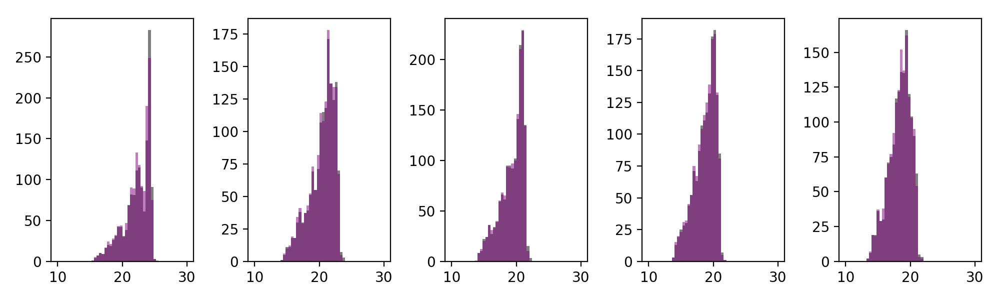

In [263]:
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize=(10,3))

ax1.hist(mean_u, bins=50, color="black", alpha=0.5, range=[10, 30])
ax1.hist(med_u, bins=50, color="purple", alpha=0.5, range=[10, 30])

ax2.hist(mean_g, bins=50,  color="black", alpha=0.5, range=[10, 30])
ax2.hist(med_g, bins=50,  color="purple", alpha=0.5, range=[10, 30])

ax3.hist(mean_r, bins=50,  color="black", alpha=0.5, range=[10, 30])
ax3.hist(med_r, bins=50,  color="purple", alpha=0.5, range=[10, 30])

ax4.hist(mean_i, bins=50,  color="black", alpha=0.5, range=[10, 30])
ax4.hist(med_i, bins=50,  color="purple", alpha=0.5, range=[10, 30])

ax5.hist(mean_z, bins=50,  color="black", alpha=0.5, range=[10, 30]);
ax5.hist(med_z, bins=50,  color="purple", alpha=0.5, range=[10, 30]);



plt.tight_layout()

In [269]:
mean_u = np.array(mean_u)
mean_g = np.array(mean_g)
mean_r = np.array(mean_r)
mean_i = np.array(mean_i)
mean_z = np.array(mean_z)

med_u = np.array(med_u)
med_g = np.array(med_g)
med_r = np.array(med_r)
med_i = np.array(med_i)
med_z = np.array(med_z)

var_u = np.array(var_u)
var_g = np.array(var_g)
var_r = np.array(var_r)
var_i = np.array(var_i)
var_z = np.array(var_z)

rms_u = np.array(rms_u)
rms_g = np.array(rms_g)
rms_r = np.array(rms_r)
rms_i = np.array(rms_i)
rms_z = np.array(rms_z)

<IPython.core.display.Javascript object>


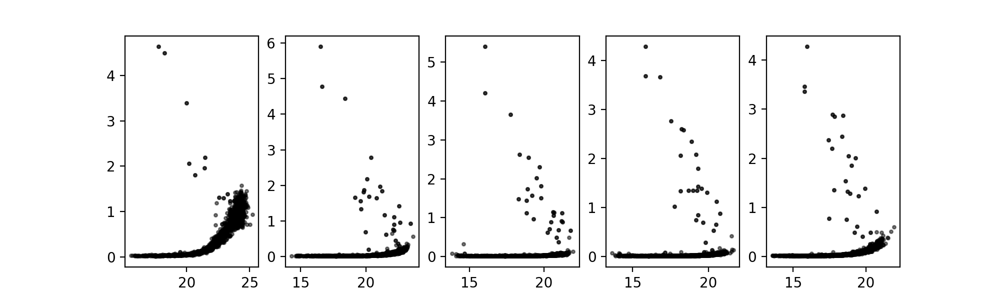

In [274]:
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize=(10,3))

ax1.scatter(med_u, rms_u, s=5, c="black", alpha=0.5)
ax2.scatter(med_g, rms_g, s=5, c="black", alpha=0.5)
ax3.scatter(med_r, rms_r, s=5, c="black", alpha=0.5)
ax4.scatter(med_i, rms_i, s=5, c="black", alpha=0.5)
ax5.scatter(med_z, rms_z, s=5, c="black", alpha=0.5)

<IPython.core.display.Javascript object>


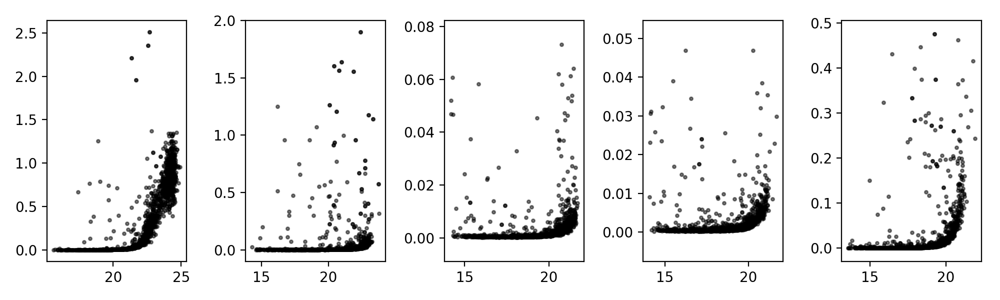

In [275]:
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize=(10,3))

ax1.scatter(mean_u[var_u < 5], var_u[var_u < 5], s=5, color="black", alpha=0.5)
ax2.scatter(mean_g[var_g < 2], var_g[var_g < 2], s=5, color="black", alpha=0.5)
ax3.scatter(mean_r[var_r < 0.08], var_r[var_r < 0.08], s=5, color="black", alpha=0.5)
ax4.scatter(mean_i[var_i < 0.05], var_i[var_i < 0.05], s=5, color="black", alpha=0.5)
ax5.scatter(mean_z[var_z < 0.5], var_z[var_z < 0.5], s=5, color="black", alpha=0.5);

plt.tight_layout()

<IPython.core.display.Javascript object>


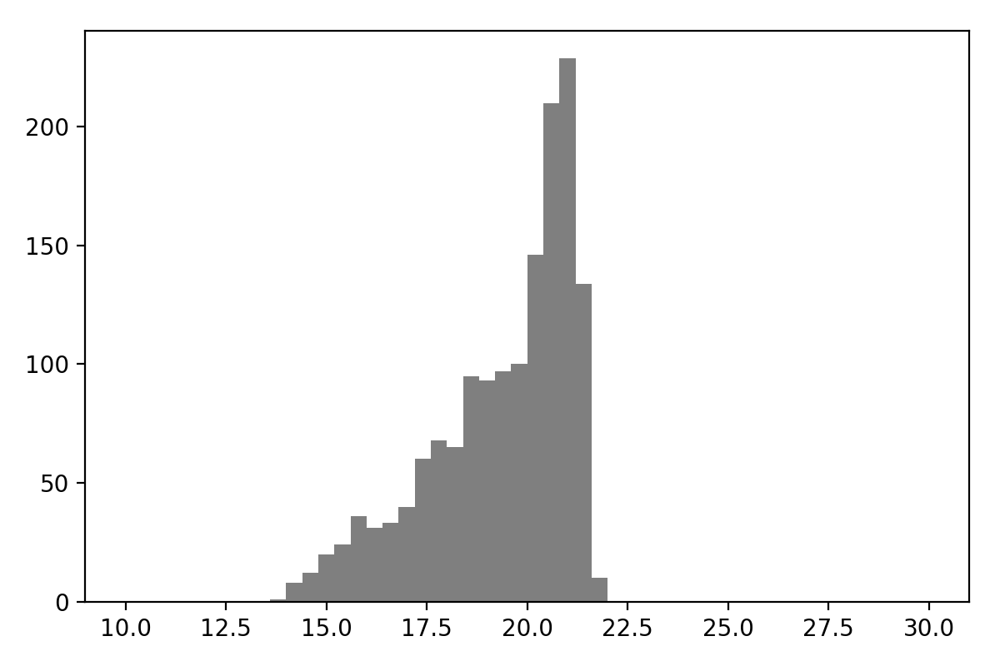

In [276]:
fig, ax1 = plt.subplots(1, 1, figsize=(6,4))

ax1.hist(med_r, bins=50,  color="black", alpha=0.5, range=[10,30])

plt.tight_layout()

## Bright variable sources

What about sources that are brighter than 20 magnitude and have an r-band rms > 0.1?

<IPython.core.display.Javascript object>


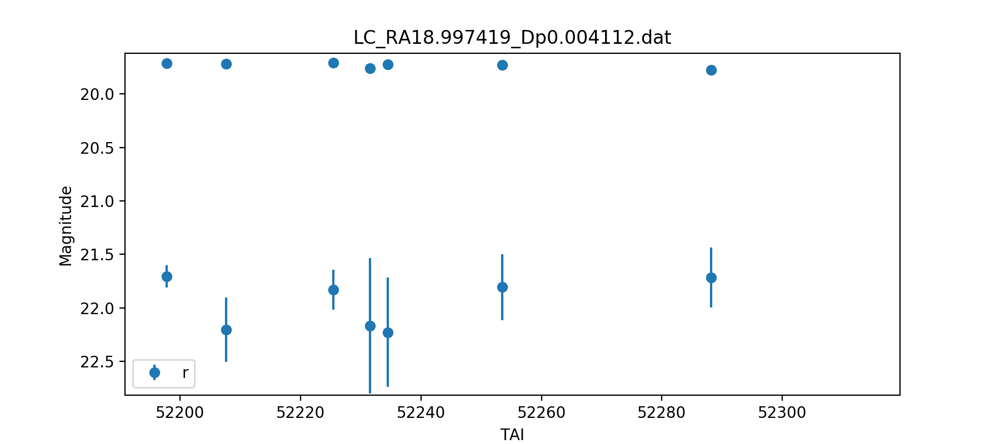

<IPython.core.display.Javascript object>


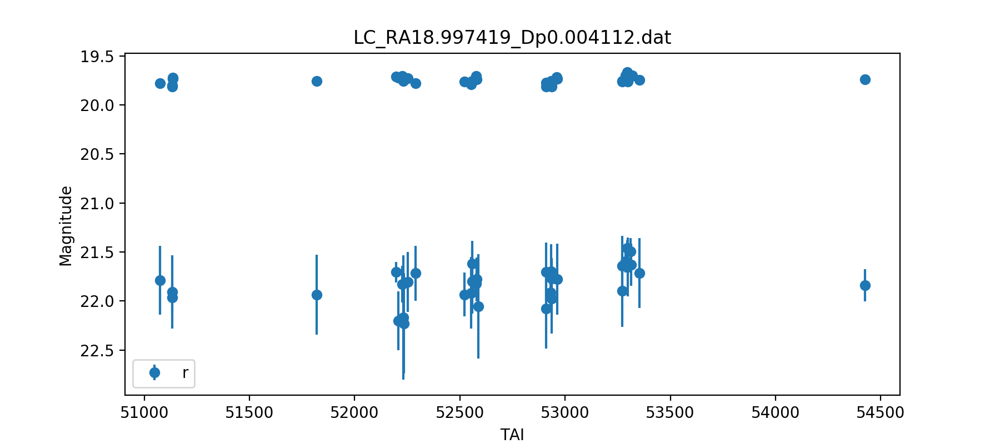

<IPython.core.display.Javascript object>


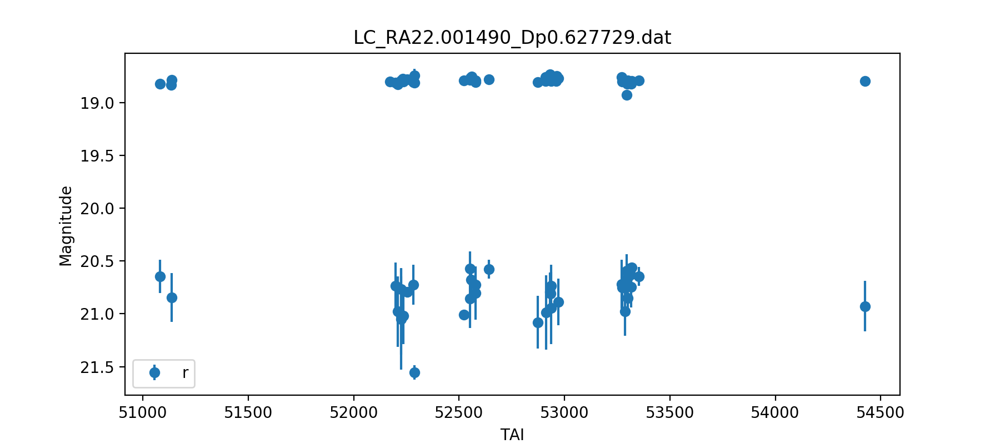

<IPython.core.display.Javascript object>


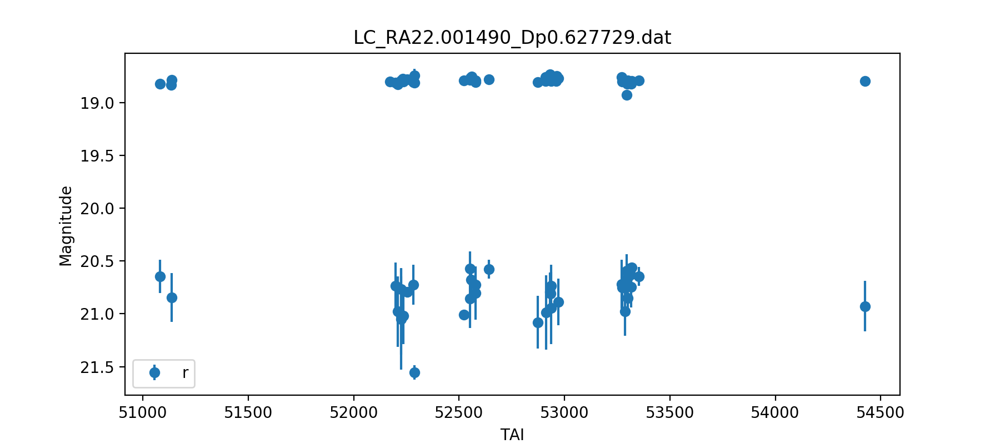

<IPython.core.display.Javascript object>


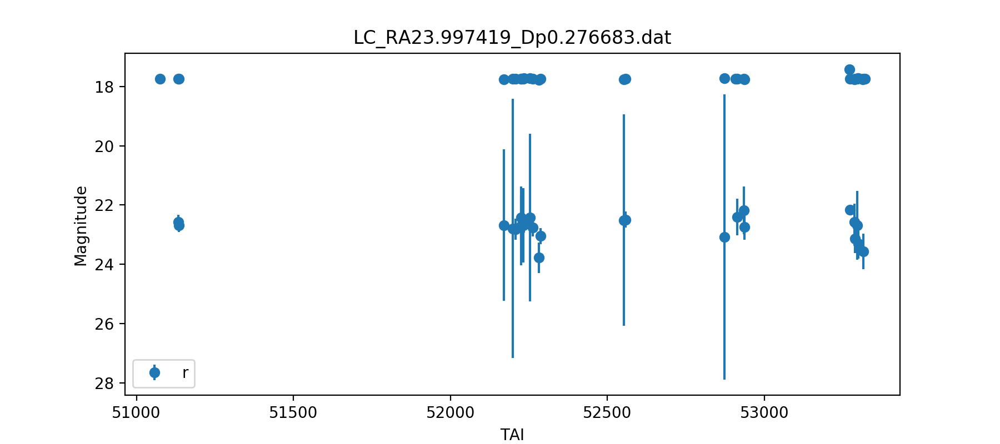

<IPython.core.display.Javascript object>


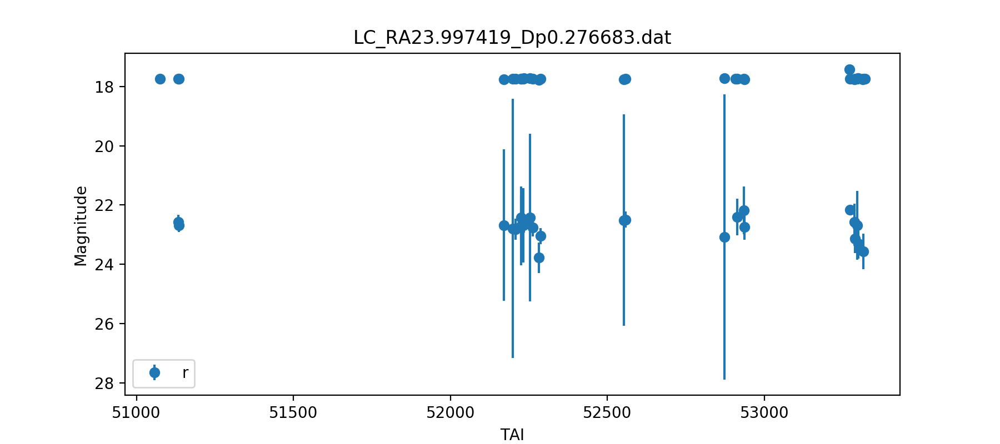

<IPython.core.display.Javascript object>


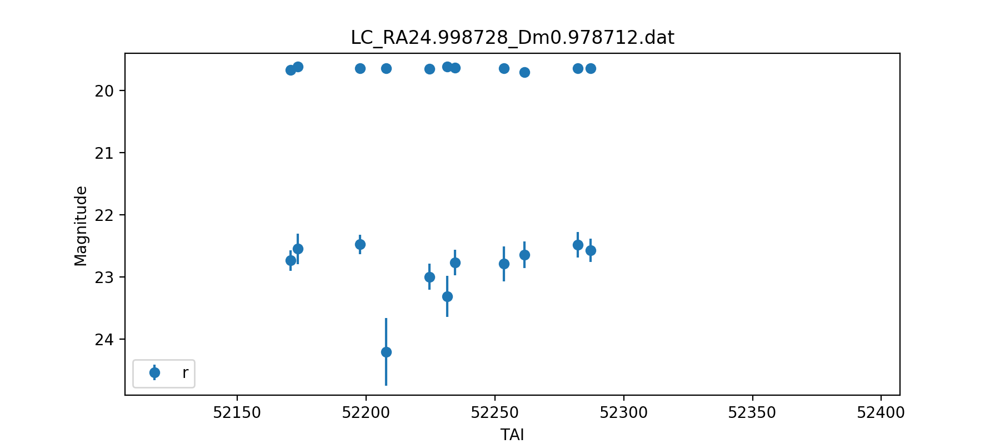

<IPython.core.display.Javascript object>


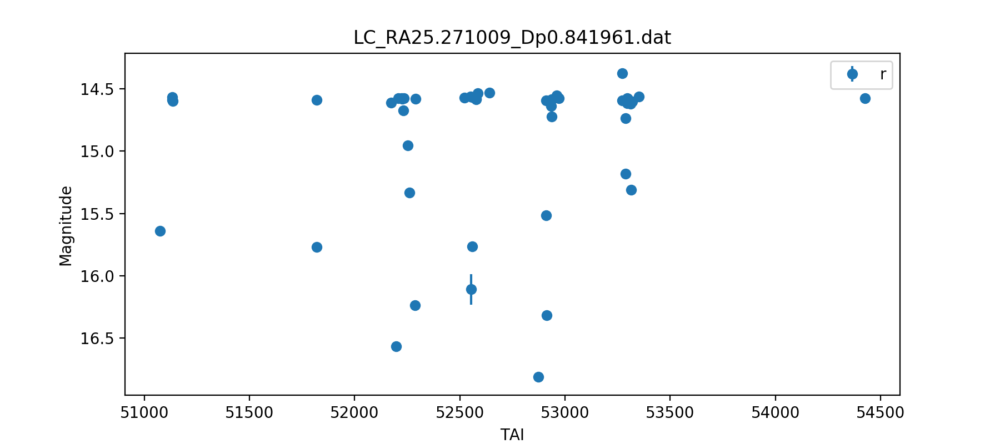

<IPython.core.display.Javascript object>


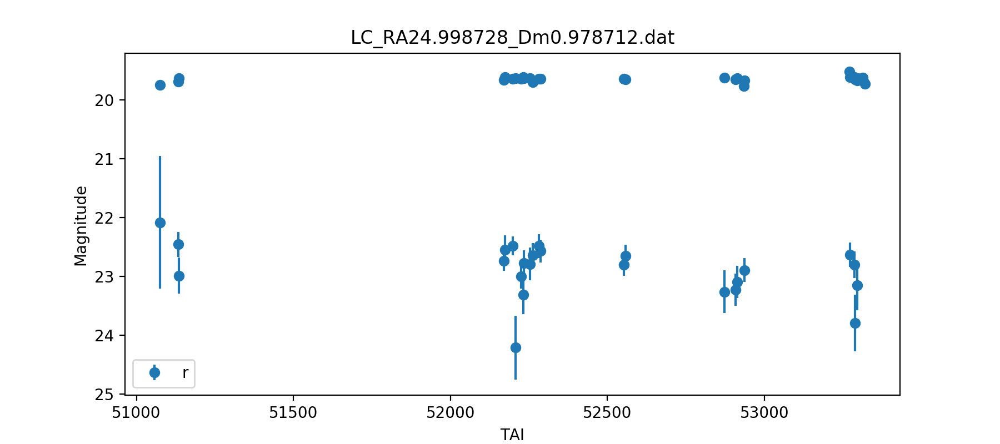

<IPython.core.display.Javascript object>


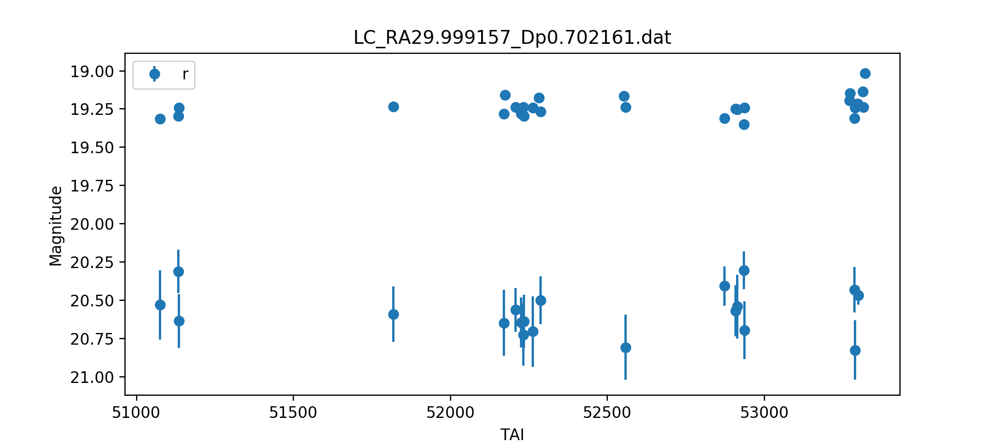

<IPython.core.display.Javascript object>


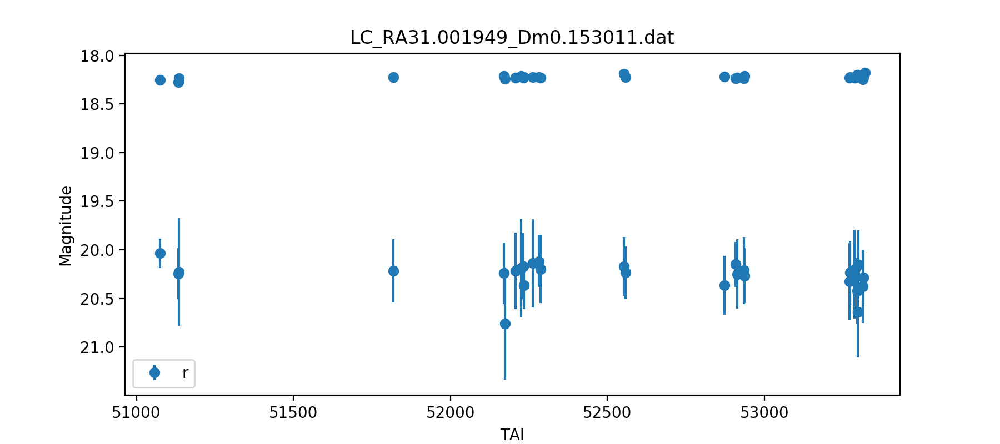

<IPython.core.display.Javascript object>


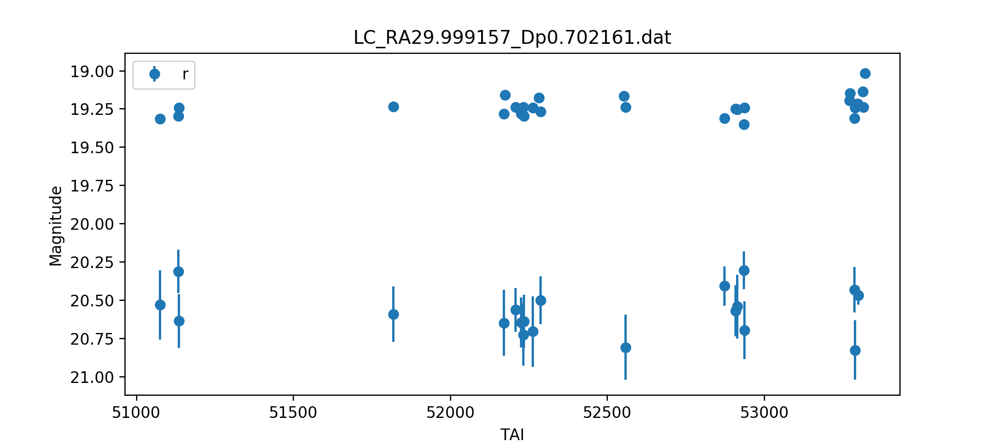

<IPython.core.display.Javascript object>


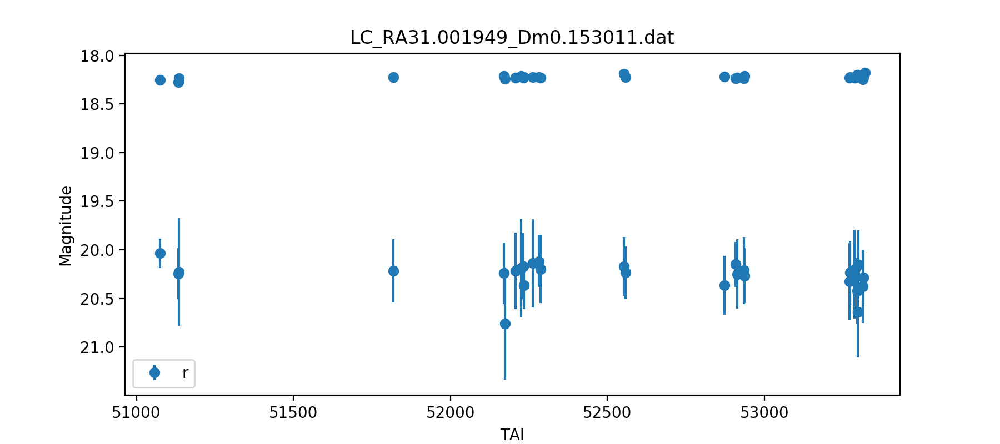

<IPython.core.display.Javascript object>


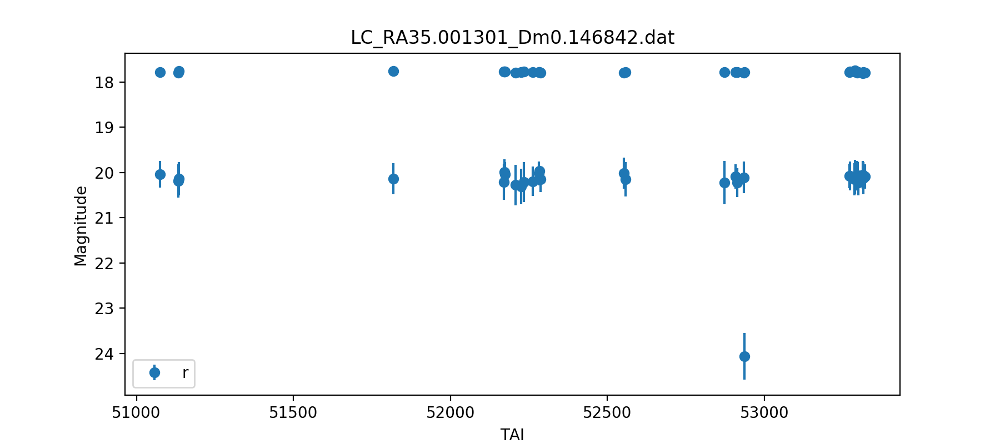

<IPython.core.display.Javascript object>


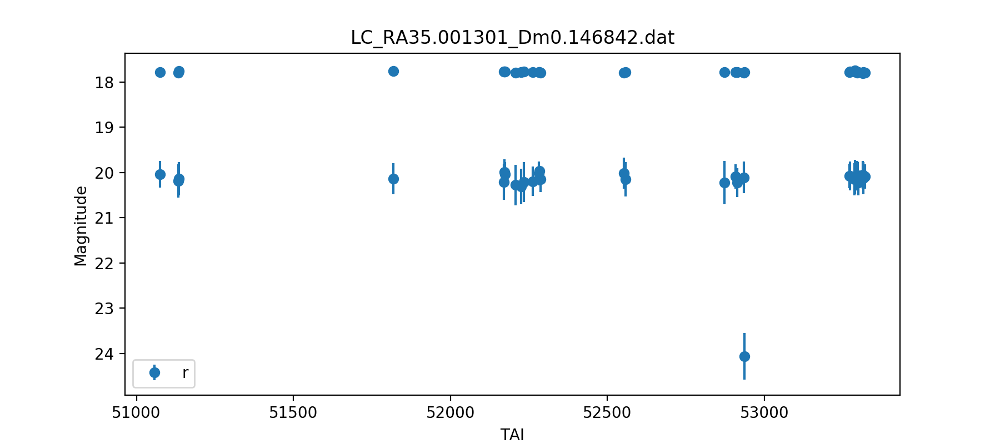

/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


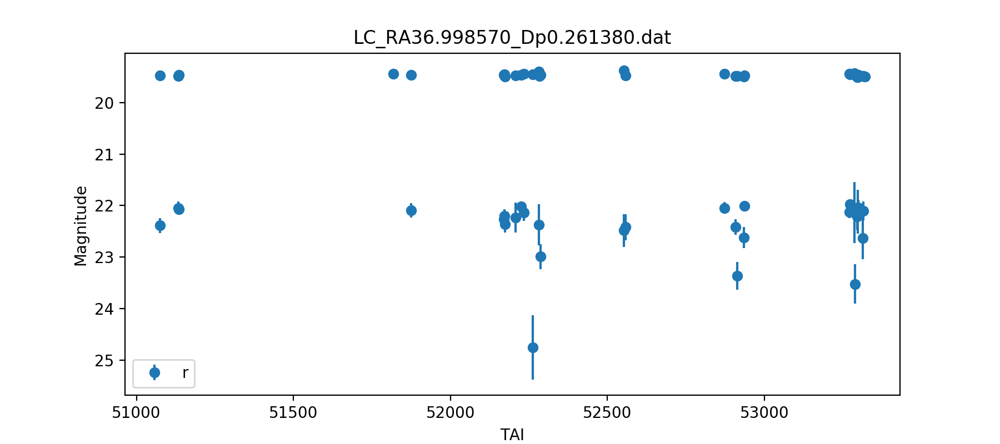

<IPython.core.display.Javascript object>


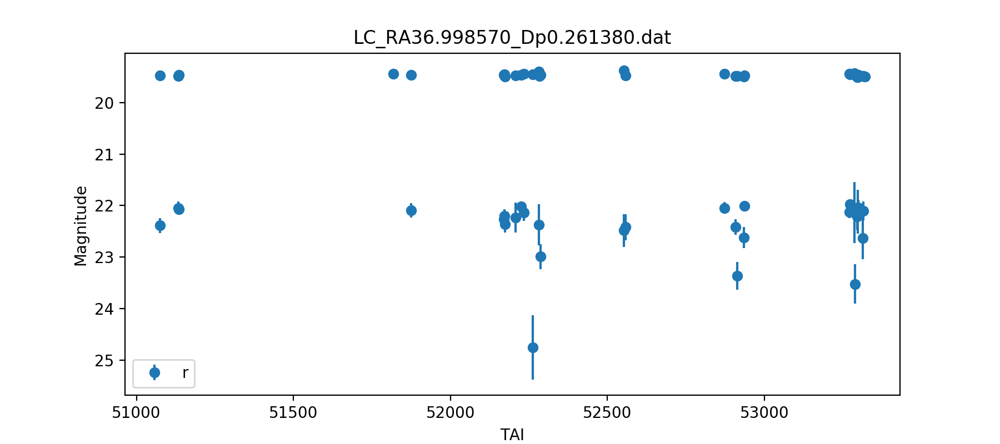

<IPython.core.display.Javascript object>


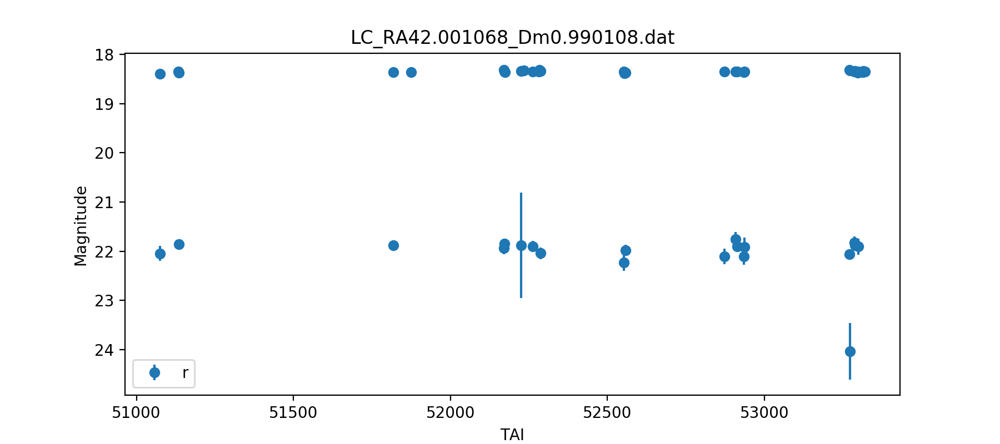

<IPython.core.display.Javascript object>


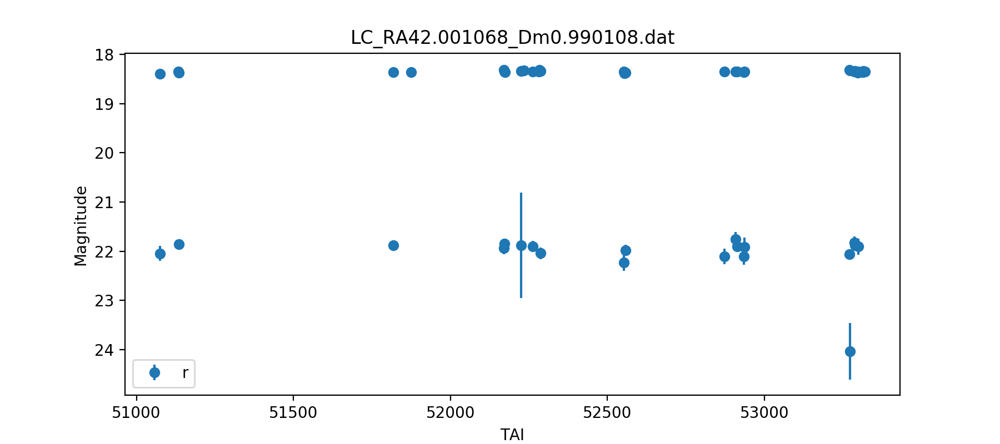

<IPython.core.display.Javascript object>


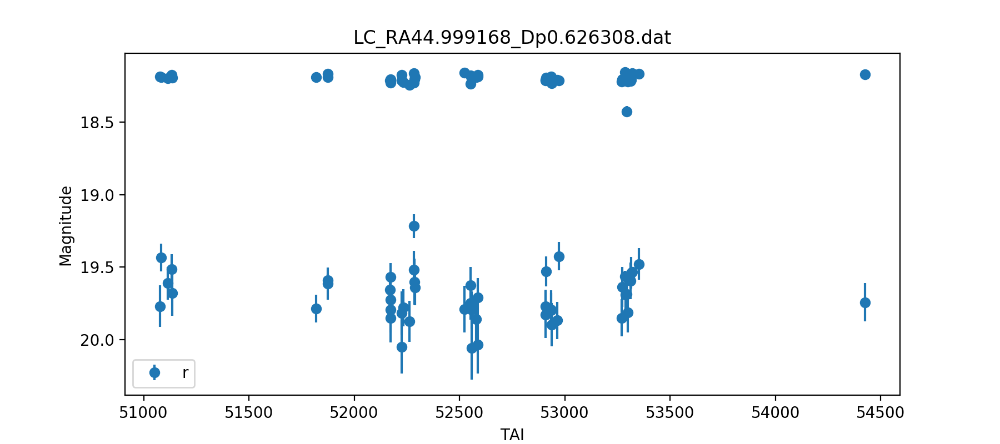

<IPython.core.display.Javascript object>


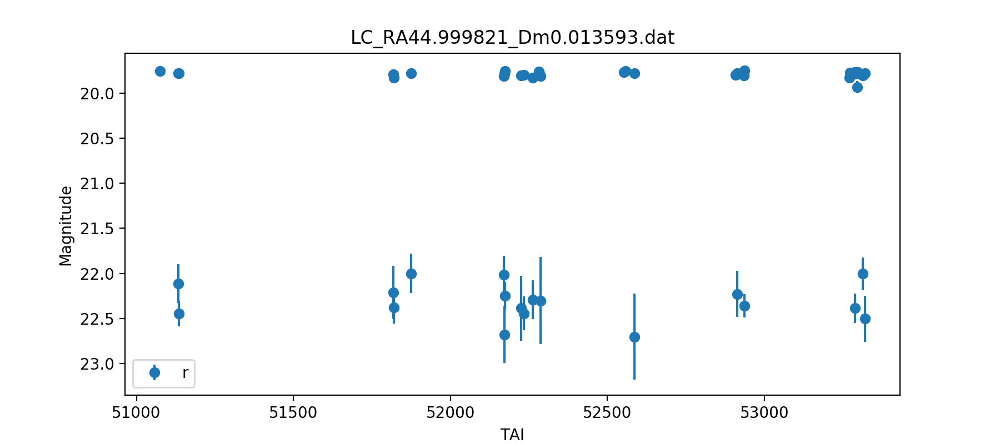

<IPython.core.display.Javascript object>


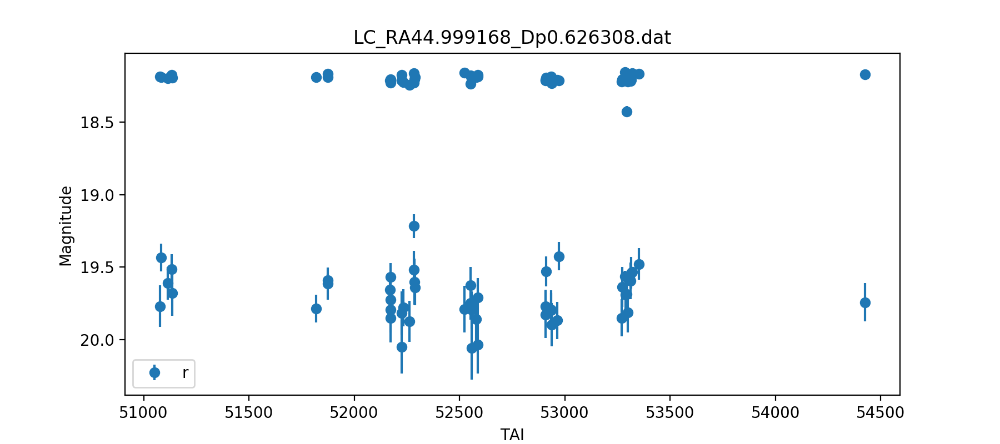

<IPython.core.display.Javascript object>


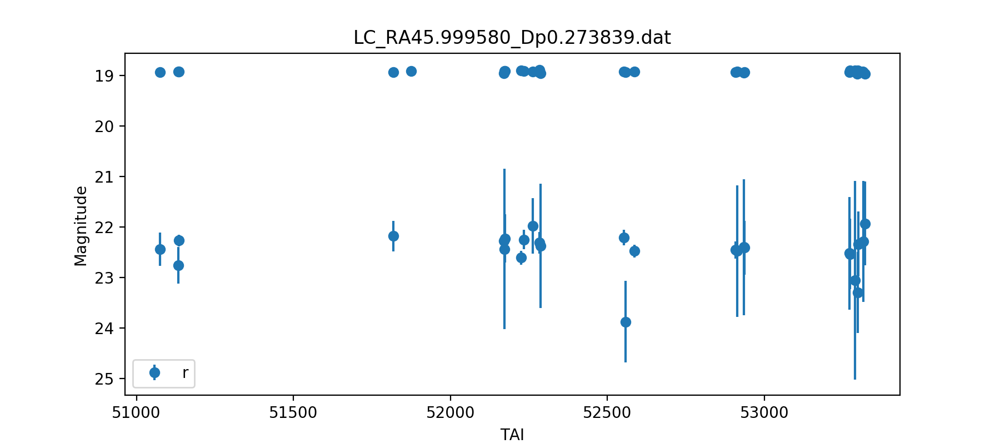

<IPython.core.display.Javascript object>


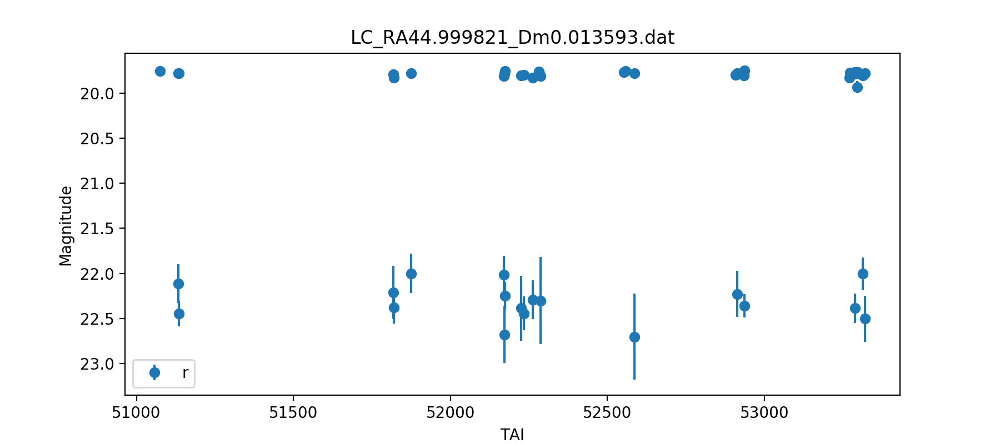

<IPython.core.display.Javascript object>


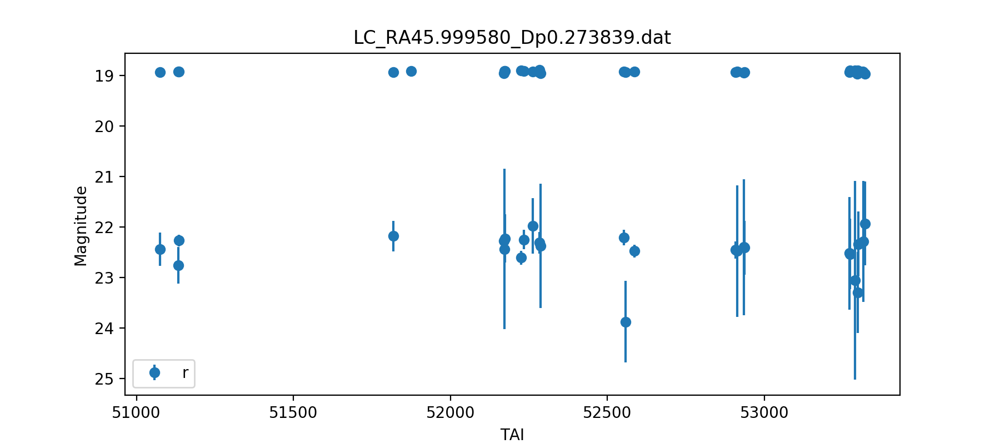

<IPython.core.display.Javascript object>


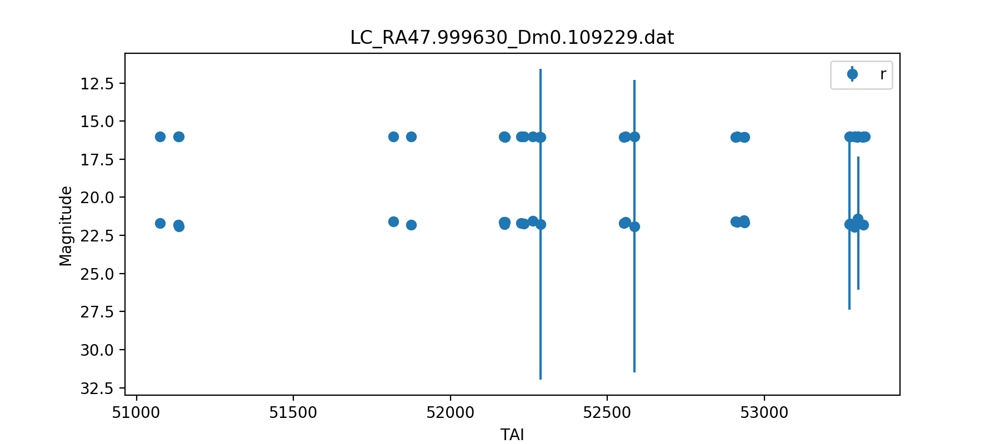

<IPython.core.display.Javascript object>


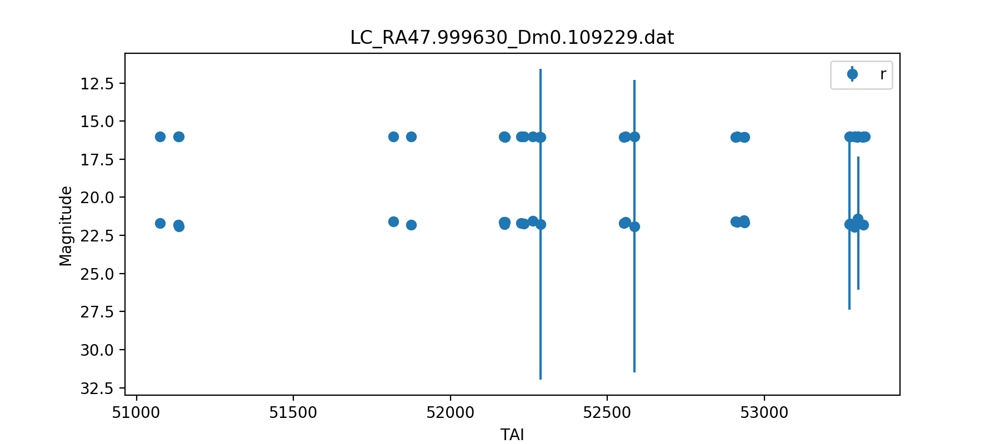

<IPython.core.display.Javascript object>


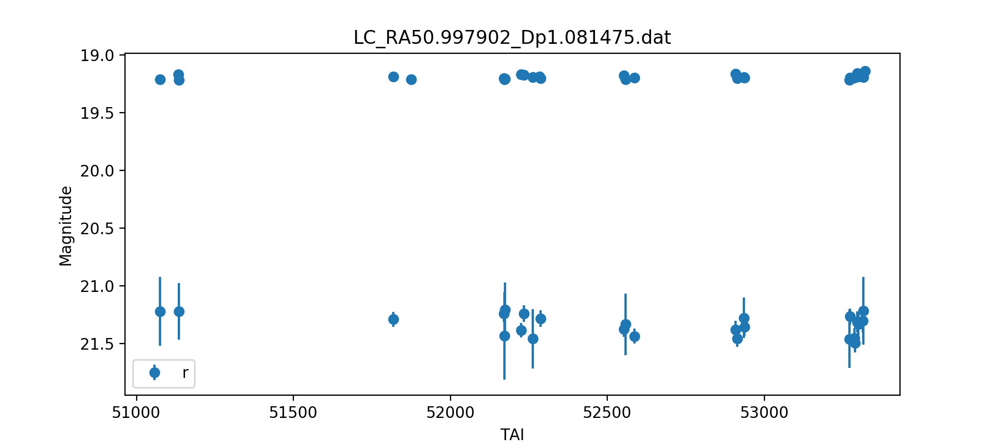

<IPython.core.display.Javascript object>


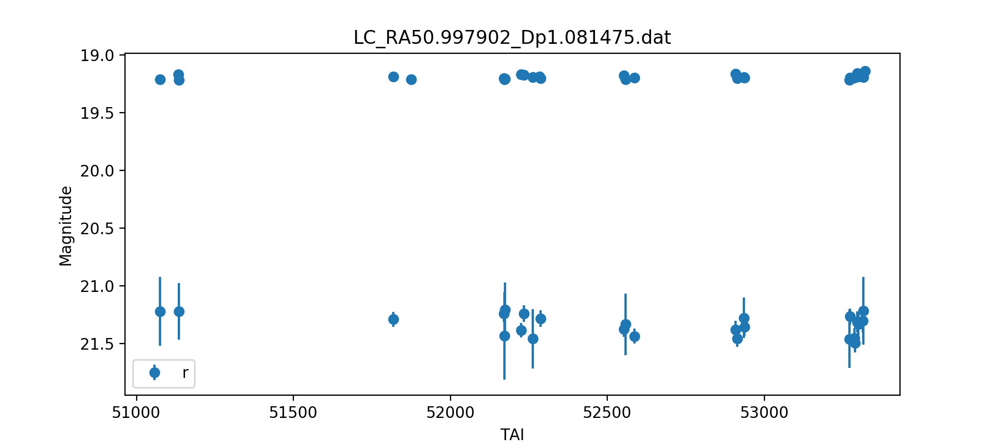

<IPython.core.display.Javascript object>


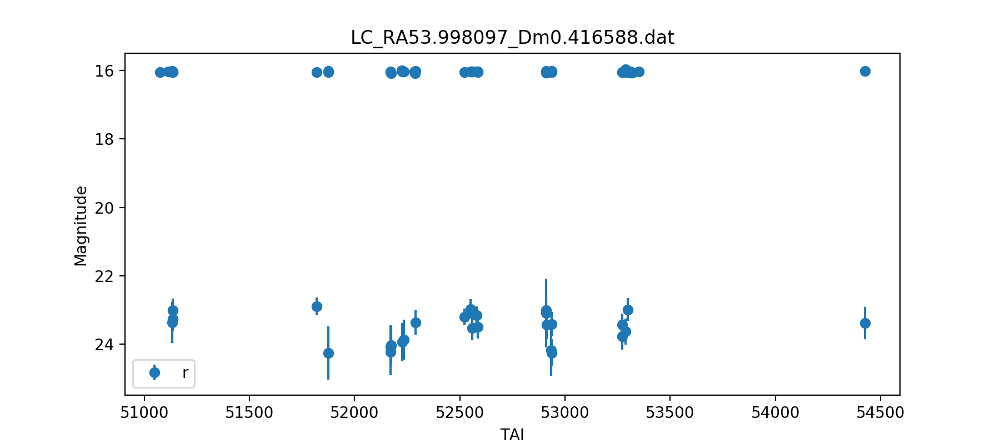

<IPython.core.display.Javascript object>


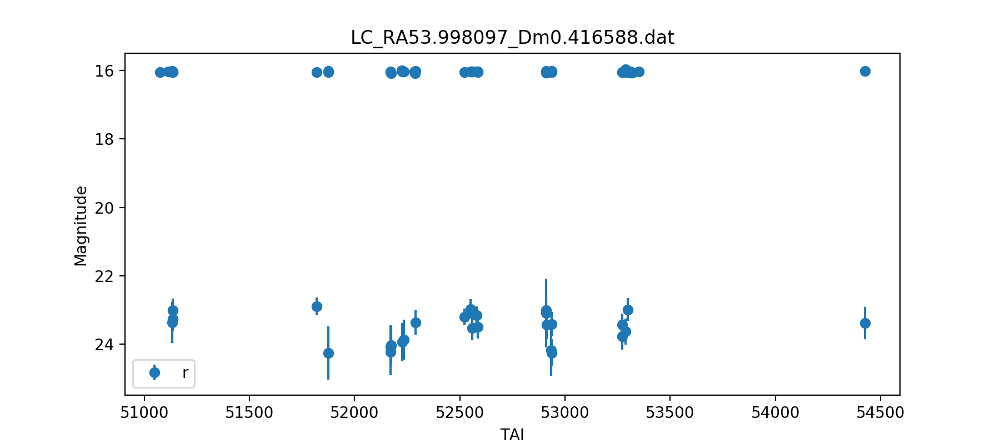

In [282]:
i = 0

for d, med, m, v, rms in zip(data_all, med_r, mean_r, var_r, rms_r):
    if (rms > 0.1) & (med < 20):
        mask = (d["r"] > 0) & (d["u"] > 0) & (d["g"]> 0) & (d["i"] > 0) & (d["z"] > 0)

        fig, ax = plt.subplots(1,1, figsize=(9,4))
        #ax.errorbar(d["tai"][:,0], d["u"], yerr=d["u_err"], fmt="o", label="u")
        #ax.errorbar(d["tai"][mask,1], d["g"][mask], yerr=d["g_err"][mask], fmt="o", label="g")
        ax.errorbar(d["tai"][mask,2], d["r"][mask], yerr=d["r_err"][mask], fmt="o", label="r")
        #ax.errorbar(d["tai"][mask,3], d["i"][mask], yerr=d["i_err"][mask], fmt="o", label="i")
        #ax.errorbar(d["tai"][mask,4], d["z"][mask], yerr=d["z_err"][mask], fmt="o", label="z")
        ax.set_ylim(ax.get_ylim()[::-1])
        ax.set_xlabel("TAI")
        ax.set_ylabel("Magnitude")
        ax.set_title(d["filename"])
        ax.legend()


So these are weird. I can't tell if something is going on with them, so I'm going to exclude them for now.

In [283]:
data_good, data_weird = [], []

for d, med, m, v, rms in zip(data_all, med_r, mean_r, var_r, rms_r):
    if (rms > 0.1):
        data_weird.append(d)
    else:
        data_good.append(d)



In [284]:
mean_u, mean_g, mean_r, mean_i, mean_z = [], [], [], [], []
var_u, var_g, var_r, var_i, var_z = [], [], [], [], []
rms_u, rms_g, rms_r, rms_i, rms_z = [], [], [], [], []
med_u, med_g, med_r, med_i, med_z = [], [], [], [], []

for i,d in enumerate(data_good):
    mask = (d["r"] > 0) & (d["u"] > 0) & (d["g"]> 0) & (d["i"] > 0) & (d["z"] > 0)
    mean_u.append(np.mean(d["u"][mask]))
    var_u.append(np.var(d["u"][mask]))
    
    mean_g.append(np.mean(d["g"][mask]))
    var_g.append(np.var(d["g"][mask]))
    
    mean_r.append(np.mean(d["r"][mask]))
    var_r.append(np.var(d["r"][mask]))
    
    mean_i.append(np.mean(d["i"][mask]))
    var_i.append(np.var(d["i"][mask]))

    mean_z.append(np.mean(d["z"][mask]))
    var_z.append(np.var(d["z"][mask]))
    
    rms_u.append(0.7413*(np.percentile(d["u"][mask], 75)-np.percentile(d["u"][mask], 25)))
    rms_g.append(0.7413*(np.percentile(d["g"][mask], 75)-np.percentile(d["g"][mask], 25)))
    rms_r.append(0.7413*(np.percentile(d["r"][mask], 75)-np.percentile(d["r"][mask], 25)))
    rms_i.append(0.7413*(np.percentile(d["i"][mask], 75)-np.percentile(d["i"][mask], 25)))
    rms_z.append(0.7413*(np.percentile(d["z"][mask], 75)-np.percentile(d["z"][mask], 25)))
    
    med_u.append(np.median(d["u"][mask]))
    med_g.append(np.median(d["g"][mask]))
    med_r.append(np.median(d["r"][mask]))
    med_i.append(np.median(d["i"][mask]))
    med_z.append(np.median(d["z"][mask]))

In [285]:
mean_u = np.array(mean_u)
mean_g = np.array(mean_g)
mean_r = np.array(mean_r)
mean_i = np.array(mean_i)
mean_z = np.array(mean_z)

med_u = np.array(med_u)
med_g = np.array(med_g)
med_r = np.array(med_r)
med_i = np.array(med_i)
med_z = np.array(med_z)

var_u = np.array(var_u)
var_g = np.array(var_g)
var_r = np.array(var_r)
var_i = np.array(var_i)
var_z = np.array(var_z)

rms_u = np.array(rms_u)
rms_g = np.array(rms_g)
rms_r = np.array(rms_r)
rms_i = np.array(rms_i)
rms_z = np.array(rms_z)

/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


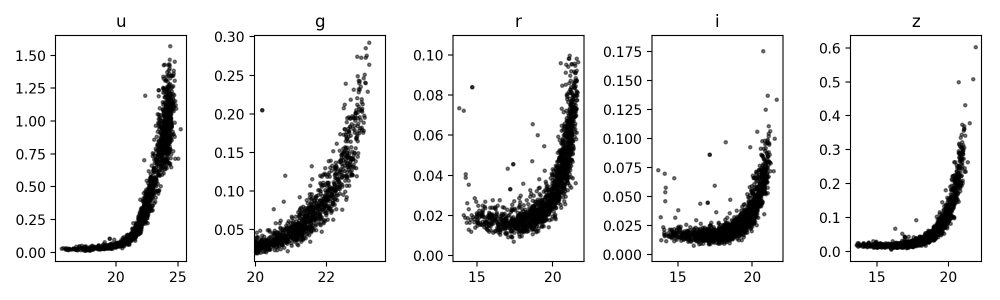

In [288]:
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize=(10,3))

ax1.scatter(med_u, rms_u, s=5, c="black", alpha=0.5)
ax1.set_title("u")

ax2.scatter(med_g, rms_g, s=5, c="black", alpha=0.5)
ax2.set_title("g")

ax3.scatter(med_r, rms_r, s=5, c="black", alpha=0.5)
ax3.set_title("r")

ax4.scatter(med_i, rms_i, s=5, c="black", alpha=0.5)
ax4.set_title("i")

ax5.scatter(med_z, rms_z, s=5, c="black", alpha=0.5)
ax5.set_title("z")

plt.tight_layout()

Let's focus on the r-band magnitudes:

In [487]:
1/24.

0.041666666666666664

/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


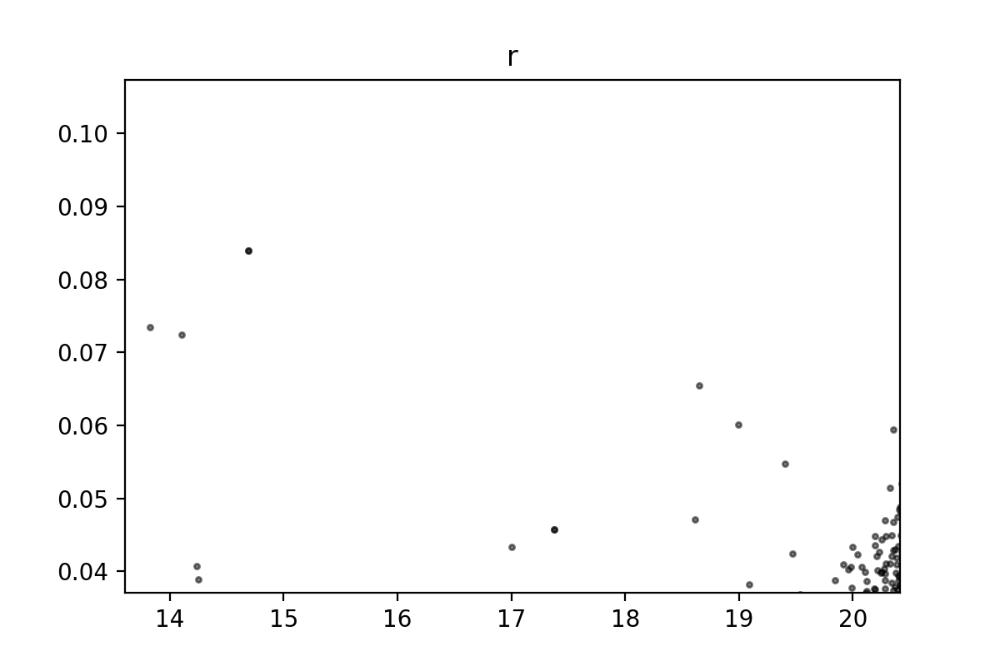

Text(0.5,1,'r')

In [289]:
fig, ax = plt.subplots(1, 1, figsize=(6,4))

ax.scatter(med_r, rms_r, s=5, c="black", alpha=0.5)
ax.set_title("r")



Cool, what about things that are brighter than 20 and have a rms larger than 0.04?

In [295]:
data_tosearch = []

/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


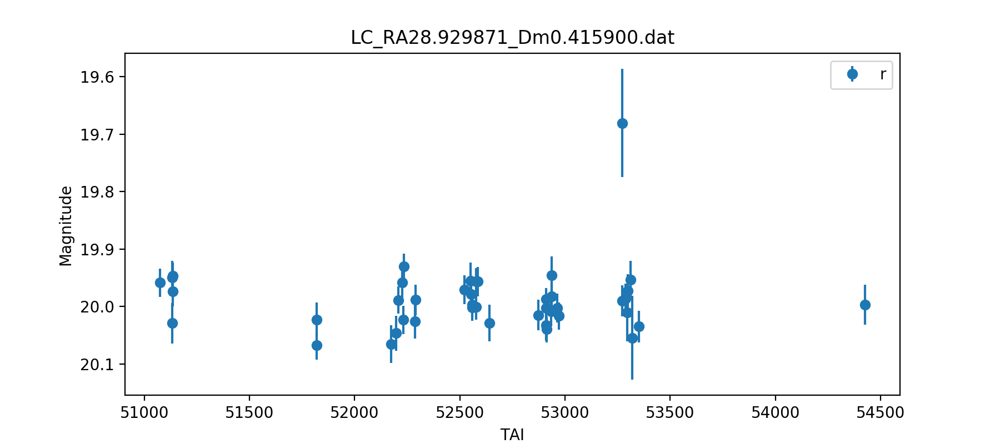

<IPython.core.display.Javascript object>


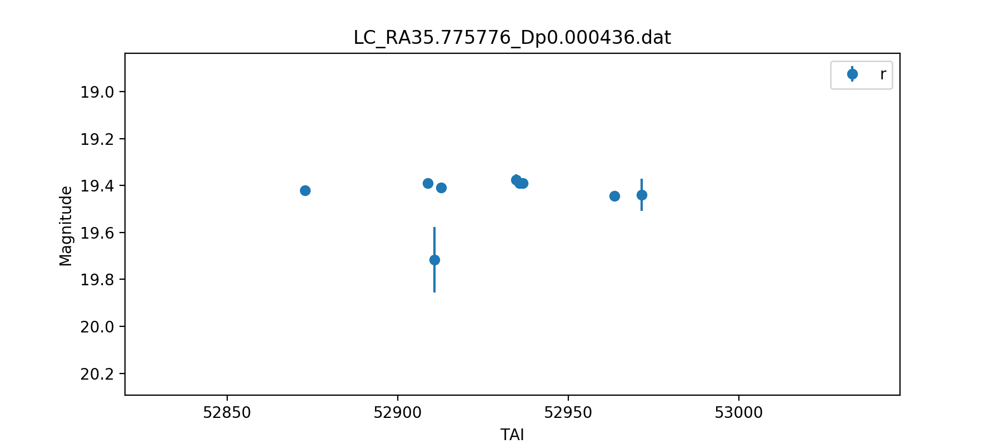

<IPython.core.display.Javascript object>


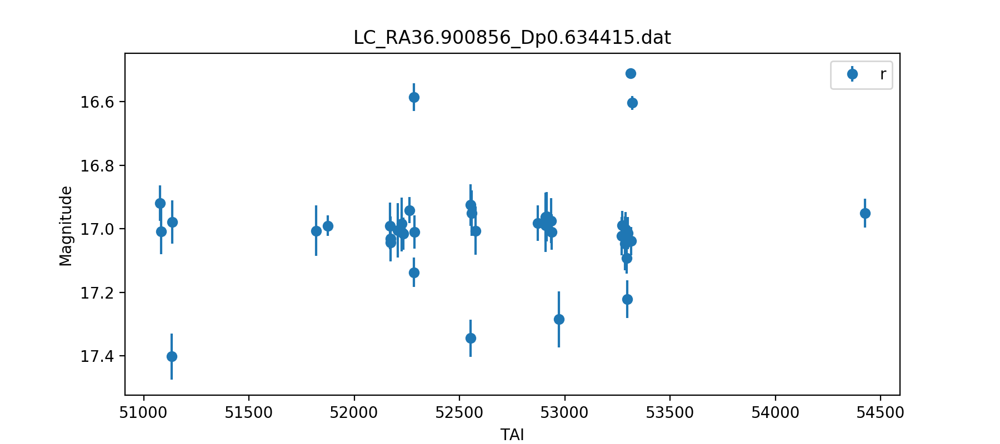

<IPython.core.display.Javascript object>


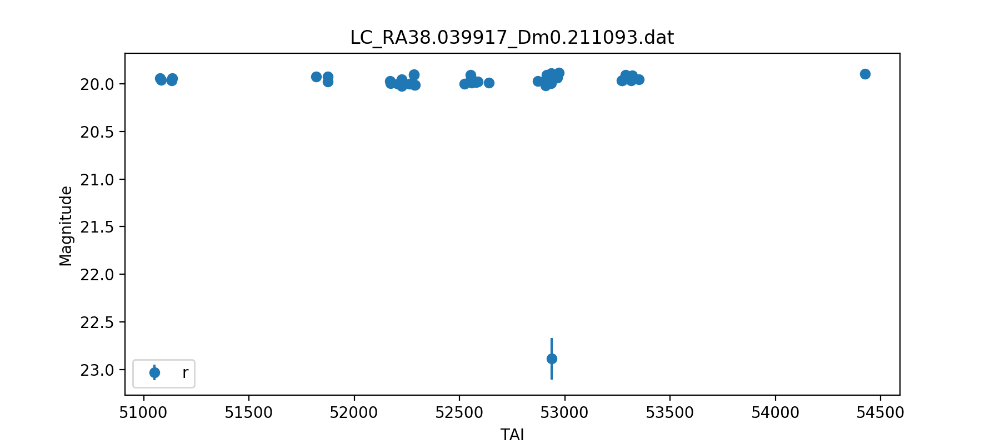

<IPython.core.display.Javascript object>


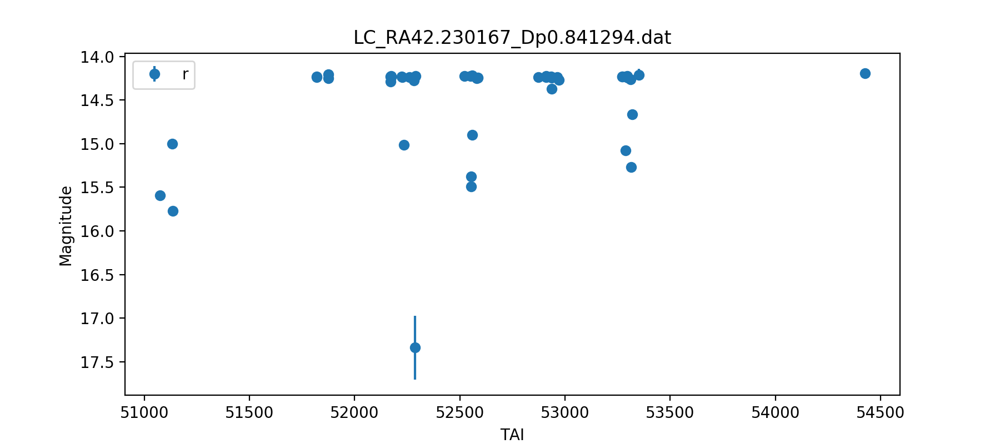

<IPython.core.display.Javascript object>


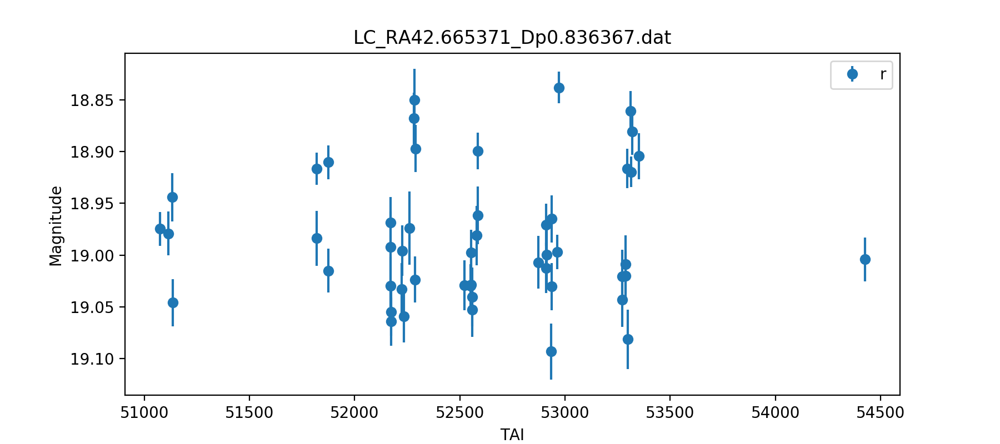

<IPython.core.display.Javascript object>


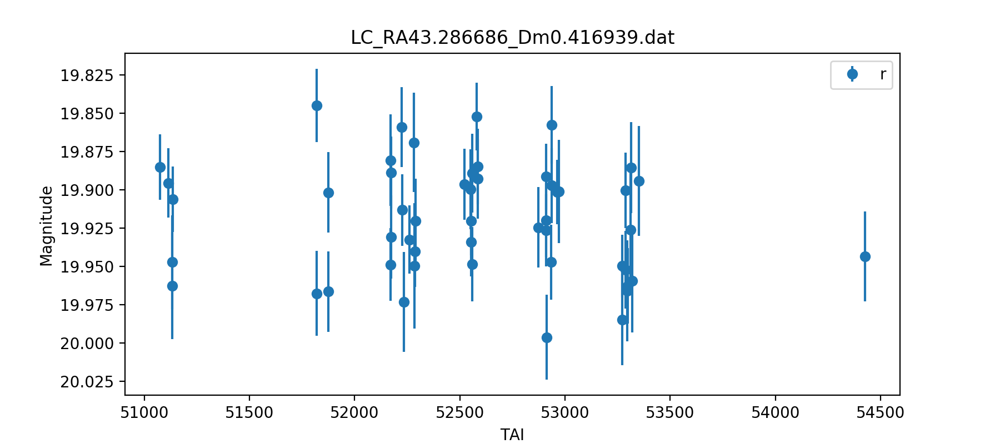

<IPython.core.display.Javascript object>


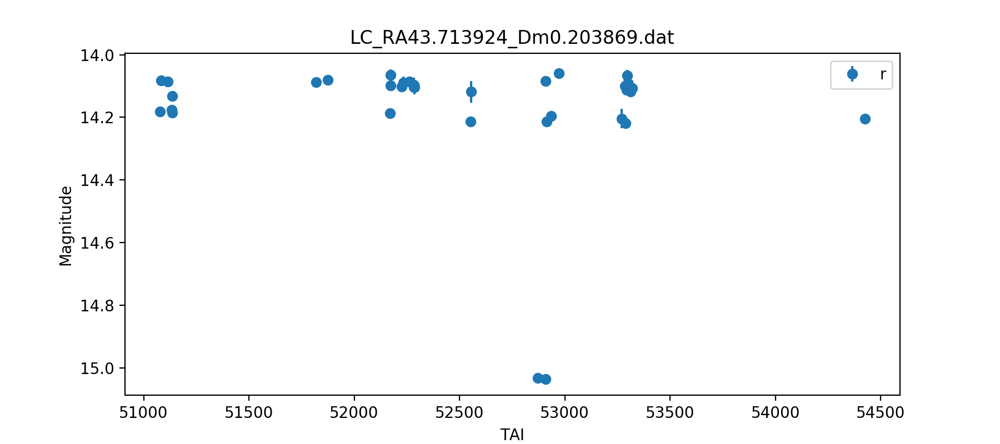

<IPython.core.display.Javascript object>


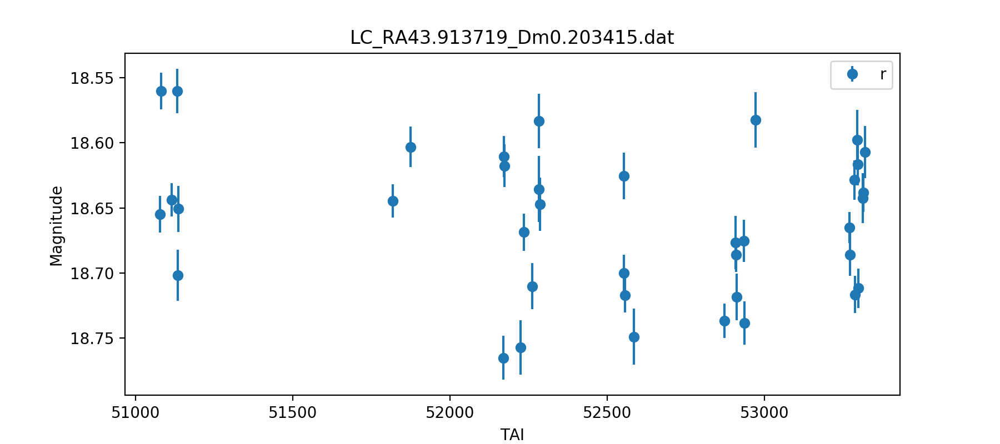

<IPython.core.display.Javascript object>


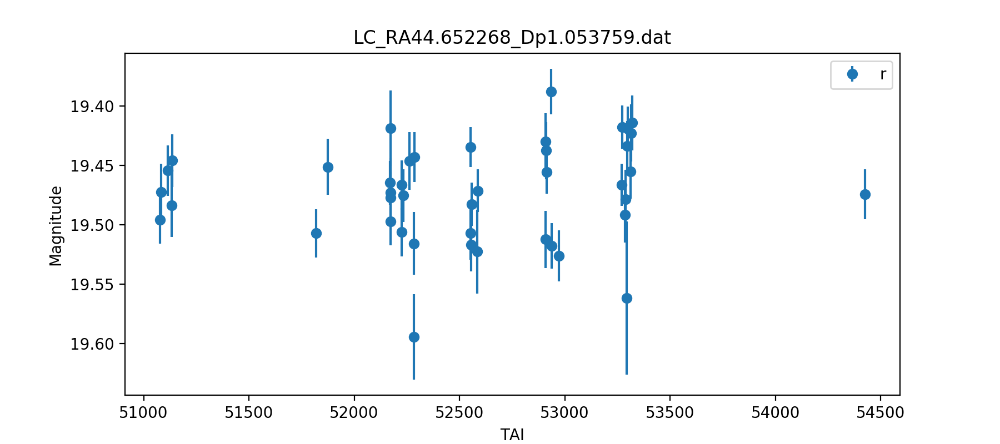

<IPython.core.display.Javascript object>


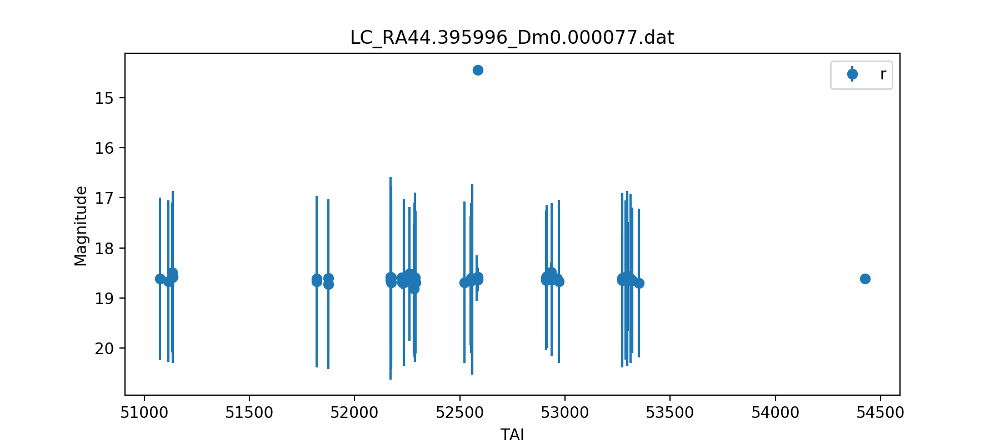

<IPython.core.display.Javascript object>


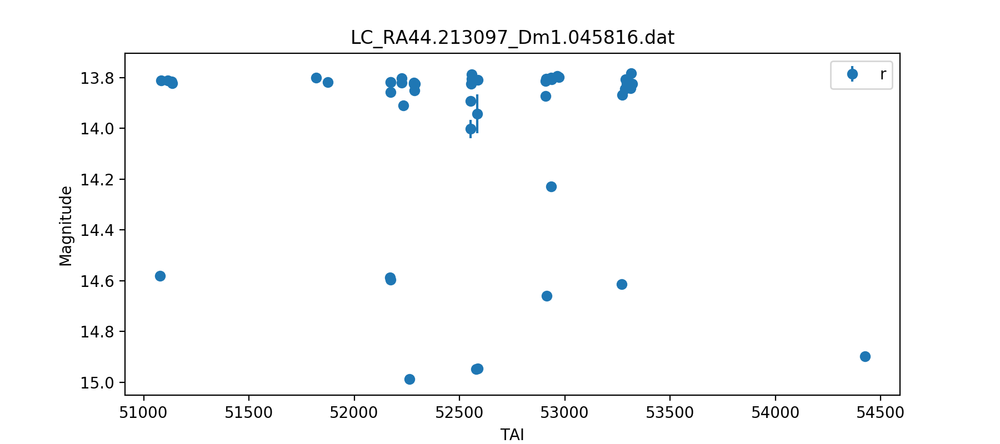

<IPython.core.display.Javascript object>


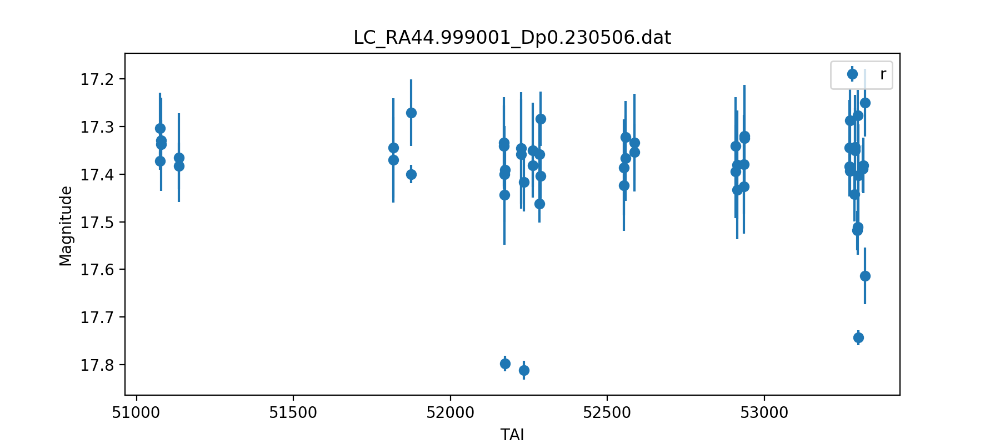

<IPython.core.display.Javascript object>


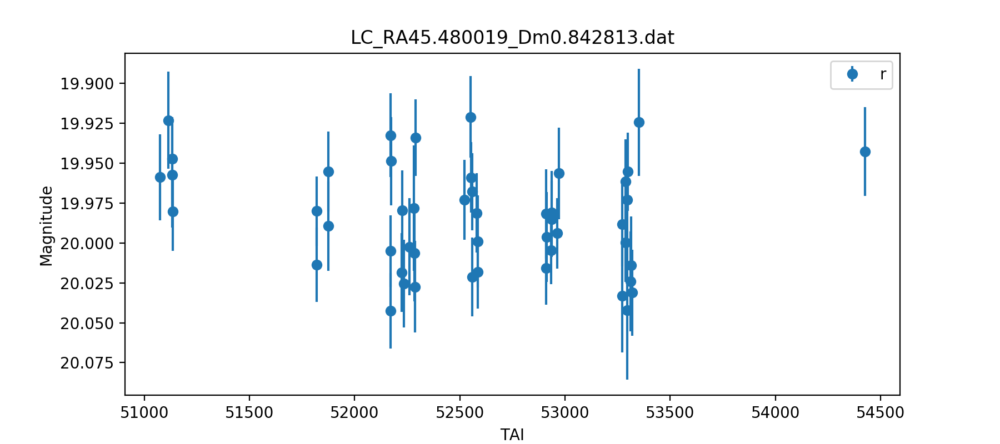

<IPython.core.display.Javascript object>


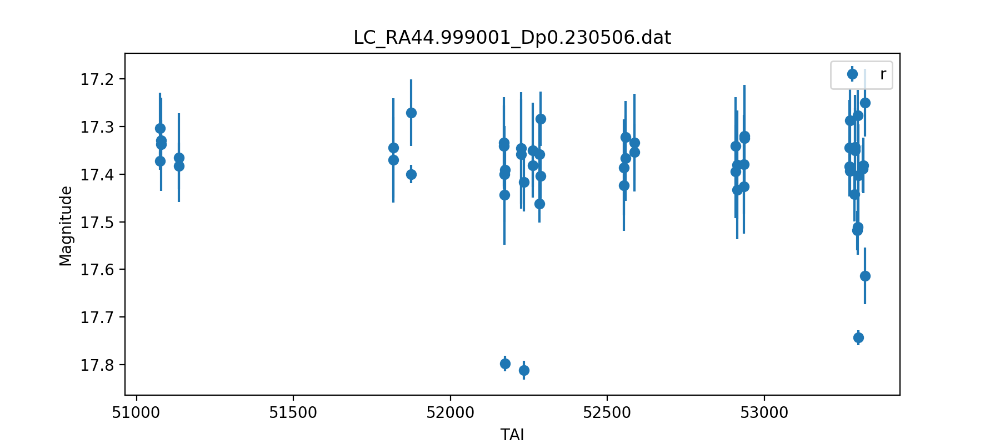

<IPython.core.display.Javascript object>


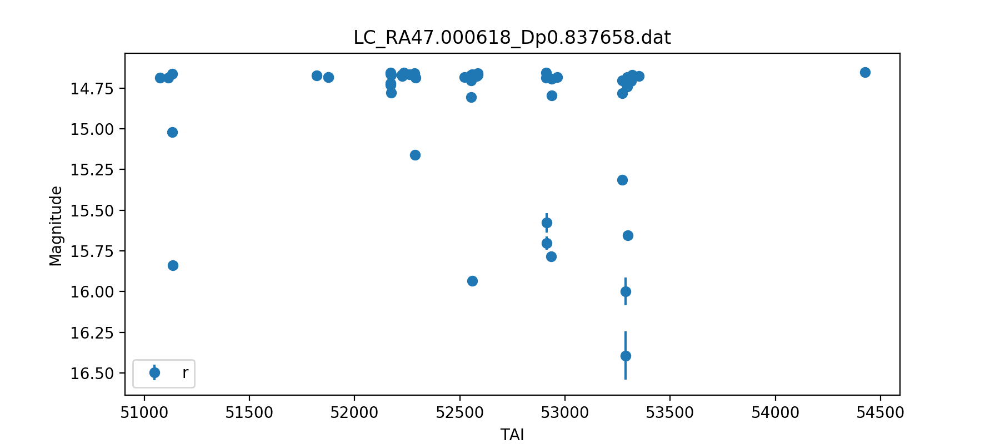

<IPython.core.display.Javascript object>


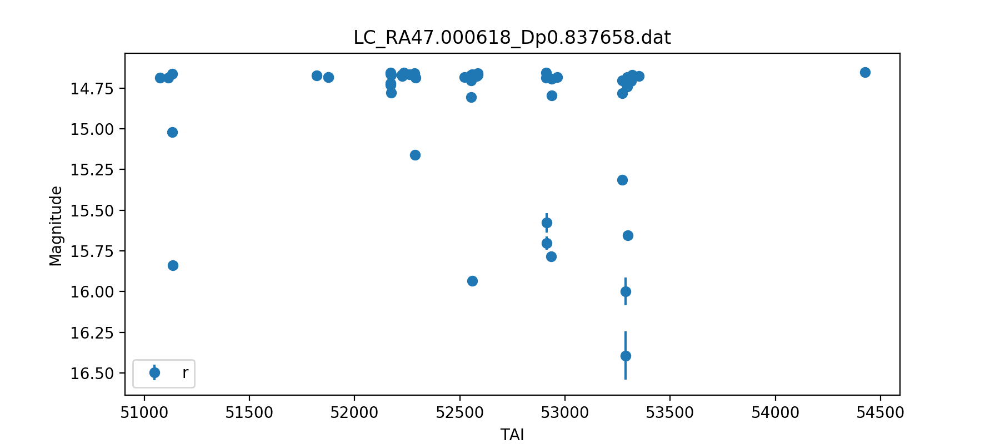

In [296]:
i = 0

for d, med, m, v, rms in zip(data_good, med_r, mean_r, var_r, rms_r):
    if (rms > 0.04) & (med < 20):
        mask = (d["r"] > 0) & (d["u"] > 0) & (d["g"]> 0) & (d["i"] > 0) & (d["z"] > 0)

        fig, ax = plt.subplots(1,1, figsize=(9,4))
        #ax.errorbar(d["tai"][:,0], d["u"], yerr=d["u_err"], fmt="o", label="u")
        #ax.errorbar(d["tai"][mask,1], d["g"][mask], yerr=d["g_err"][mask], fmt="o", label="g")
        ax.errorbar(d["tai"][mask,2], d["r"][mask], yerr=d["r_err"][mask], fmt="o", label="r")
        #ax.errorbar(d["tai"][mask,3], d["i"][mask], yerr=d["i_err"][mask], fmt="o", label="i")
        #ax.errorbar(d["tai"][mask,4], d["z"][mask], yerr=d["z_err"][mask], fmt="o", label="z")
        ax.set_ylim(ax.get_ylim()[::-1])
        ax.set_xlabel("TAI")
        ax.set_ylabel("Magnitude")
        ax.set_title(d["filename"])
        ax.legend()
        
        data_tosearch.append(d)



Some of those light curves look a bit crappy, but in some of those might be real eclipses?

Let's do a Lomb-Scargle periodogram:

In [293]:
from gatspy import periodic

In [397]:
d = data_tosearch[0]

mask = (d["r"] > 0) & (d["u"] > 0) & (d["g"]> 0) & (d["i"] > 0) & (d["z"] > 0)
tai = d["tai"][mask,2]
rmag = d["r"][mask]
rerr = d["r_err"][mask]

In [398]:
p_min = 1.0
p_max = tai[-1]-tai[0]

In [399]:
p_max

2198.983600000007

In [400]:
model = periodic.LombScargle(fit_period=True)
model.optimizer.period_range = (p_min, p_max)
%timeit model.fit(tai, rmag, rerr)

Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 2.2e+03
 - Computing periods at 16738 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 2.2e+03
 - Computing periods at 16738 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 2.2e+03
 - Computing periods at 16738 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 2.2e+03
 - Computing periods at 16738 steps
Zooming-in on 5 candidate peaks

2

In [324]:
model.best_period

1.8444819671769401

In [325]:
periods = np.linspace(p_min, p_max, 10000)

import warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    scores = model.score(periods)


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


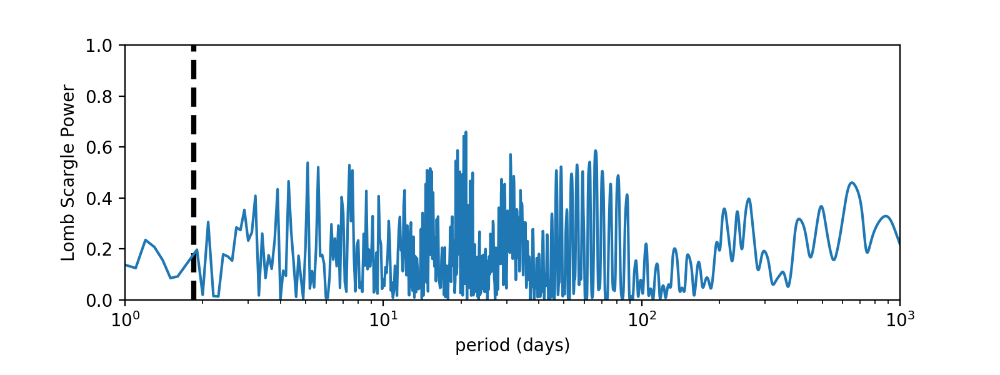

In [327]:
fig, ax = plt.subplots(figsize=(8, 3))
fig.subplots_adjust(bottom=0.2)
ax.plot(periods, scores)
ax.set(xlabel='period (days)', ylabel='Lomb Scargle Power',
       xlim=(p_min, p_max), ylim=(0, 1))
ax.set_xscale("log")
ax.vlines(model.best_period, 0, 1.0, lw=3, linestyle="dashed", color="black")

Let's try for the rest of them:

In [406]:
d["filename"][:-4]

'LC_RA28.929871_Dm0.415900'

i: 0
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16728 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 2.0040942048291313


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


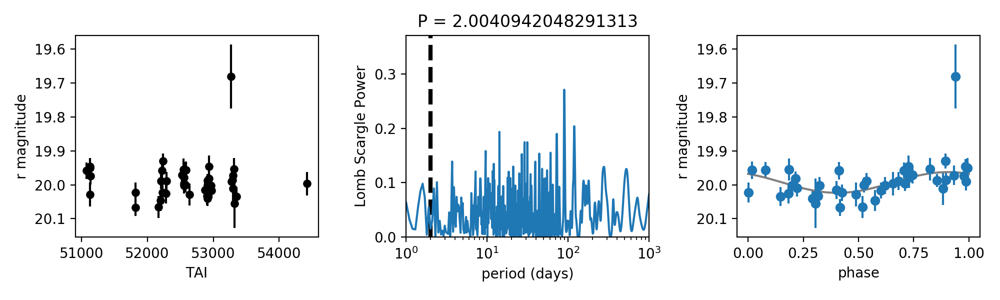



i: 1
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16728 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 1.9877418387044368


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


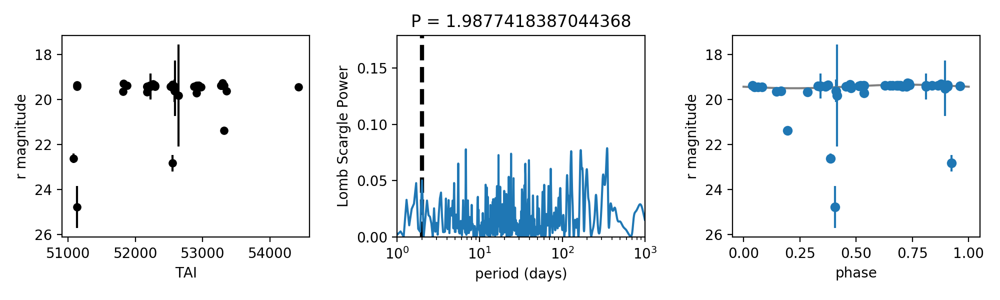



i: 2
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000376
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16714 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 2.142747703239008


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


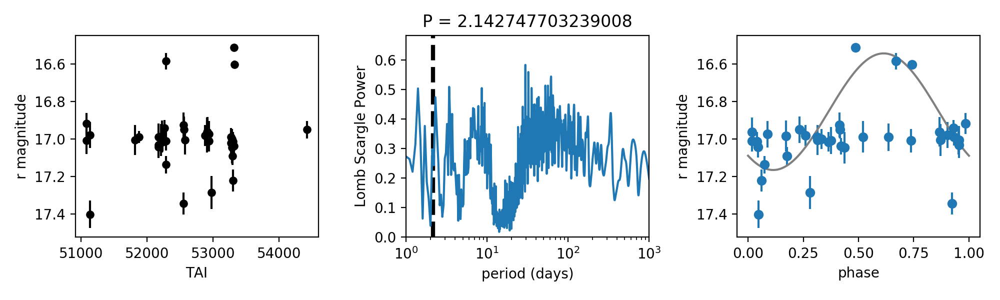



i: 3
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000376
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16714 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Best period estimate: 8.73954682163518


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


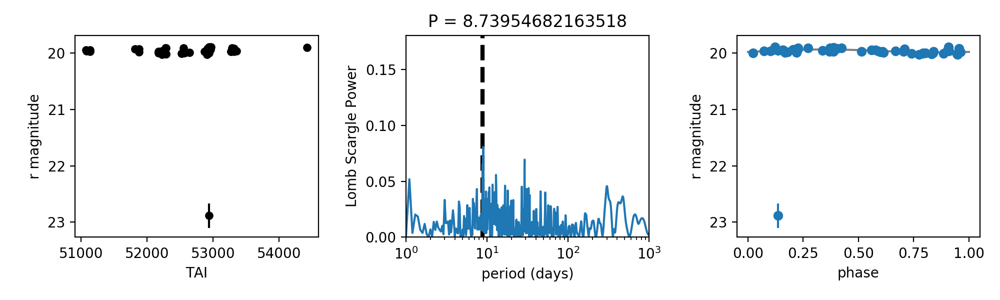



i: 4
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16728 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 6.506420218571693


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


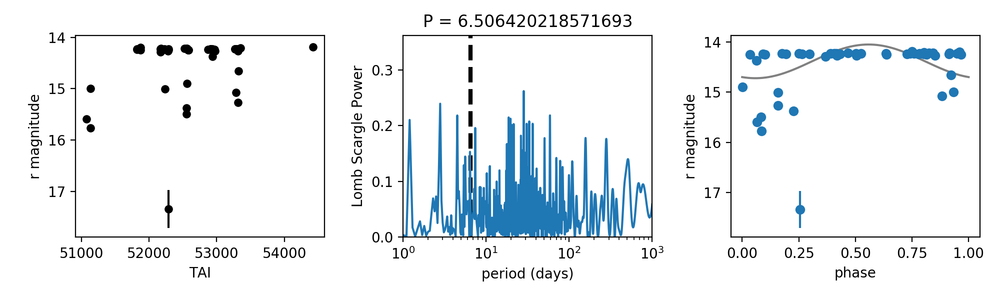



i: 5
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16728 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 7.575572968776285


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


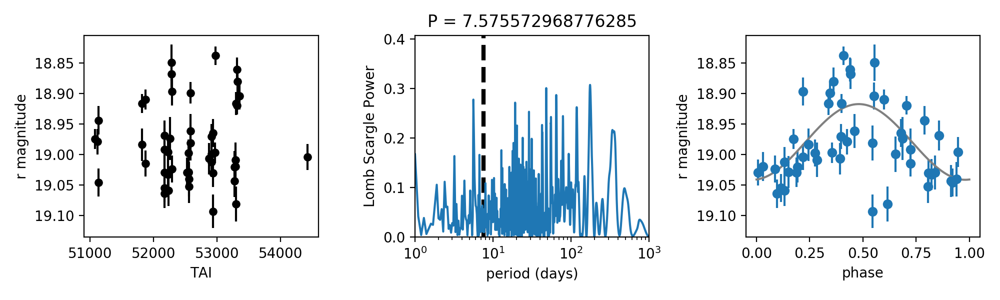



i: 6
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16728 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 2.1327441453105322


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


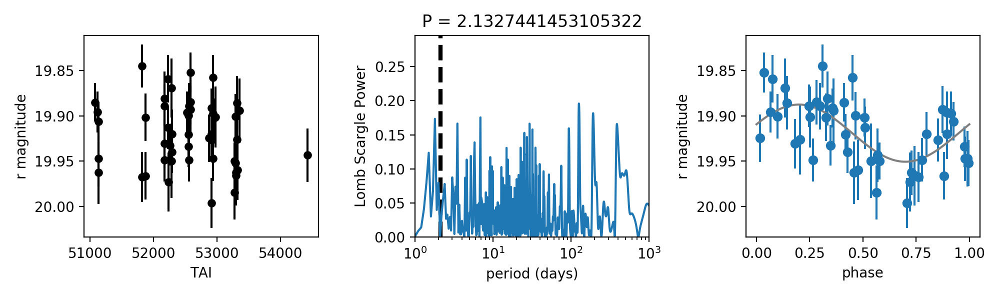



i: 7
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000376
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16714 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Best period estimate: 1.1167866435584783


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


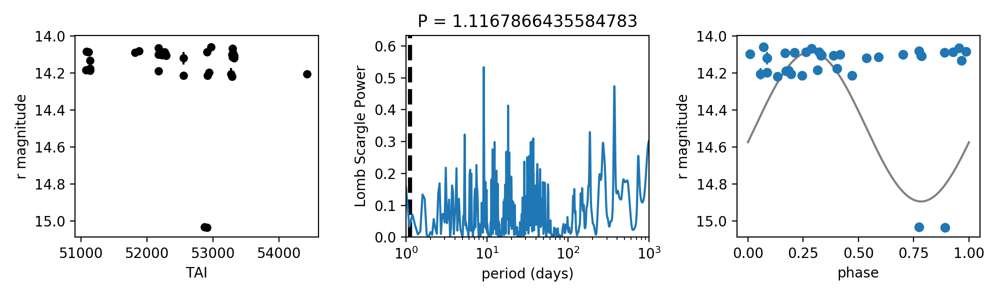



i: 8
Finding optimal frequency:
 - Estimated peak width = 0.0028
 - Using 5 steps per peak; omega_step = 0.000561
 - User-specified period range:  1 to 1e+03
 - Computing periods at 11194 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 1.1209560674556736


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


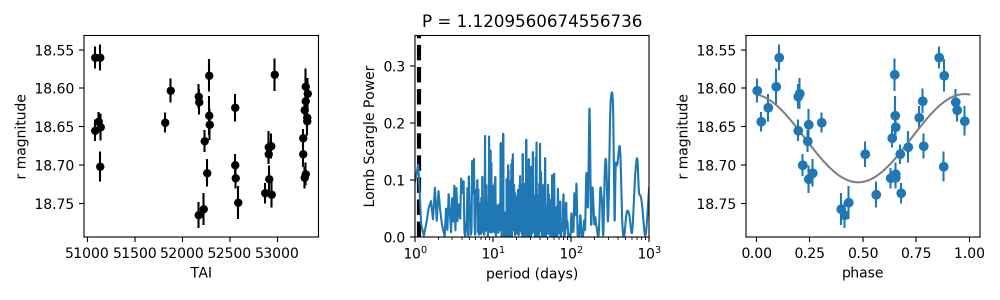



i: 9
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000376
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16714 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 2.9152167694820625


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


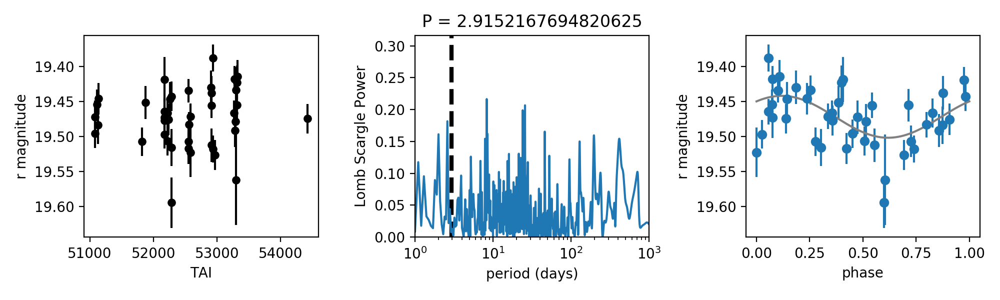



i: 10
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16728 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 2.4548470883450544


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


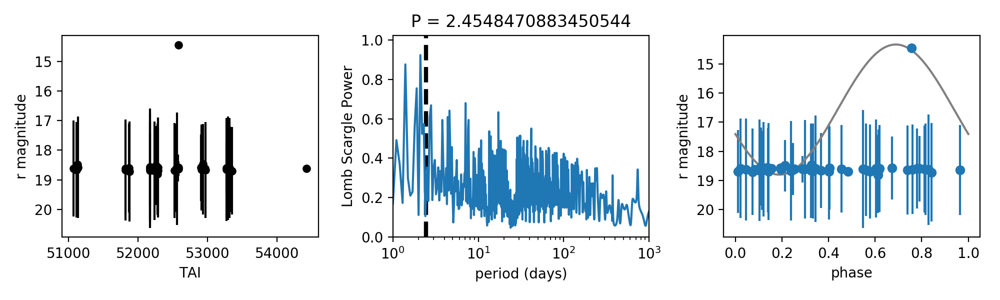



i: 11
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000376
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16714 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 3.7413052605136348


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


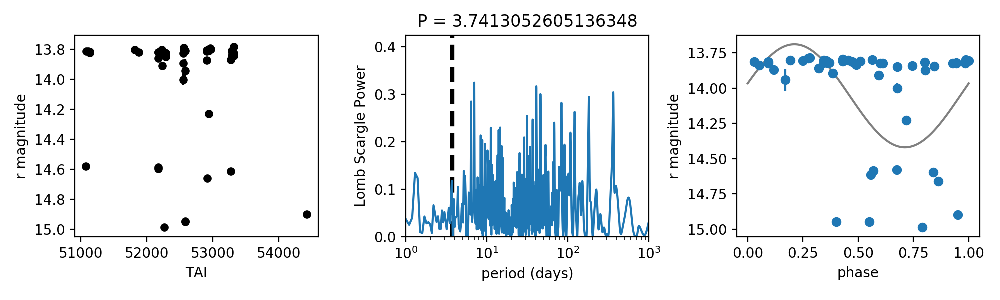



i: 12
Finding optimal frequency:
 - Estimated peak width = 0.0028
 - Using 5 steps per peak; omega_step = 0.00056
 - User-specified period range:  1 to 1e+03
 - Computing periods at 11209 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 1.8444819671769401


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


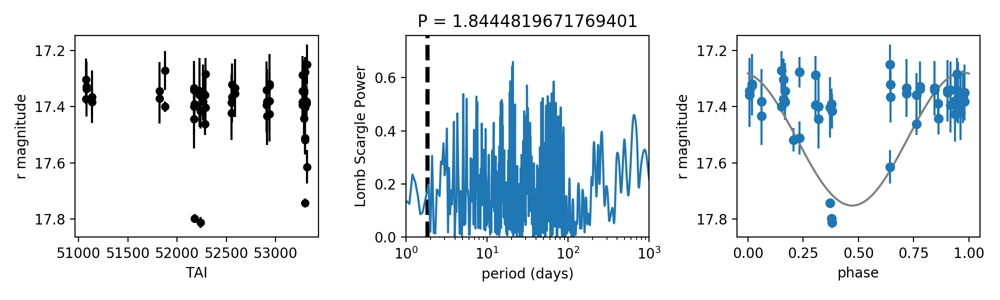



i: 13
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16728 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 1.8179365072112503


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


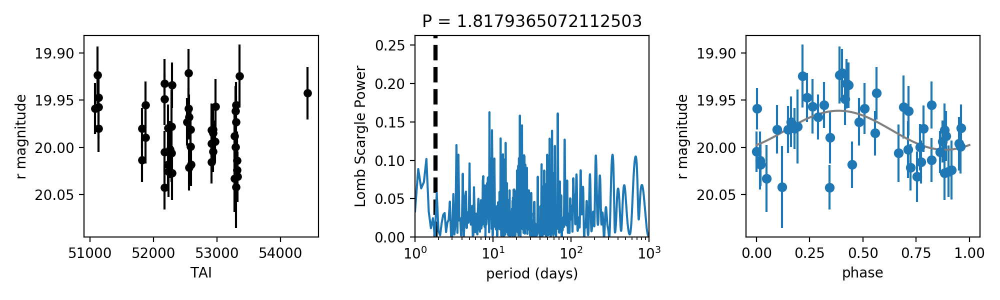



i: 14
Finding optimal frequency:
 - Estimated peak width = 0.0028
 - Using 5 steps per peak; omega_step = 0.00056
 - User-specified period range:  1 to 1e+03
 - Computing periods at 11209 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Best period estimate: 1.8444819671769401


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


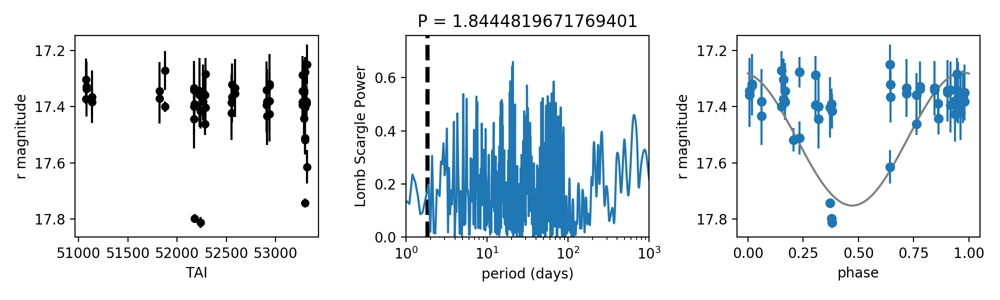



i: 15
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16728 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Best period estimate: 1.1064367536813575


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


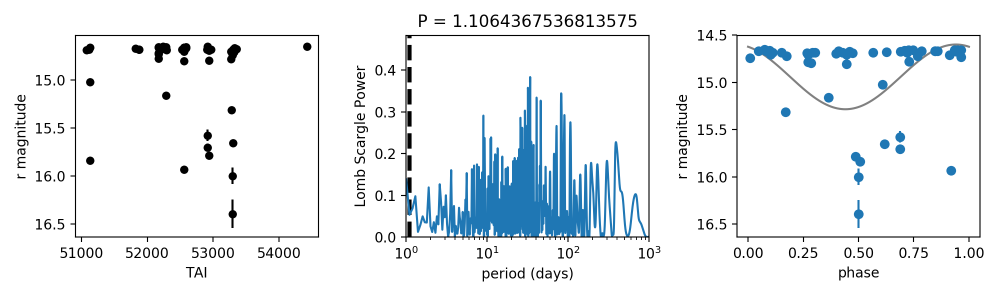



i: 16
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16728 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Best period estimate: 1.1064367536813575


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


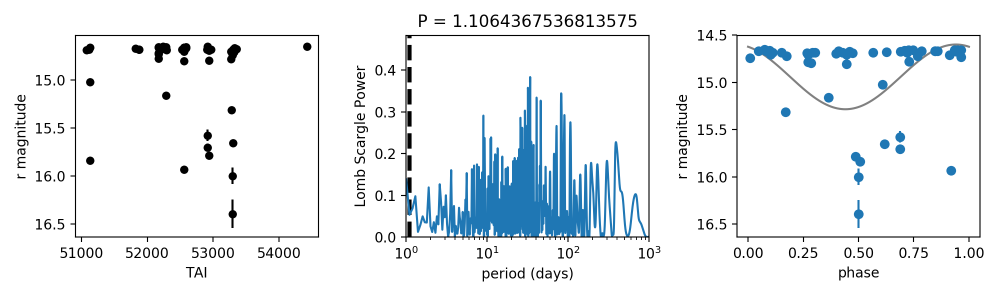

In [339]:
for i,d in enumerate(data_tosearch):
    print("i: " + str(i))
    mask = (d["r"] > 0) & (d["u"] > 0) & (d["g"]> 0) & (d["i"] > 0) & (d["z"] > 0)
    tai = d["tai"][mask,2]
    rmag = d["r"][mask]
    rerr = d["r_err"][mask]

    model = periodic.LombScargle(fit_period=True)
    model.optimizer.period_range = (p_min, p_max)
    model.fit(tai, rmag, rerr)
    print("Best period estimate: " + str(model.best_period))
    
    periods = np.linspace(p_min, p_max, 10000)

    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        scores = model.score(periods)

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10, 3))
    ax1.errorbar(tai, rmag, yerr=rerr, fmt="o", markersize=5, c="black")
    ax1.invert_yaxis()
    ax1.set_xlabel("TAI")
    ax1.set_ylabel("r magnitude")
    
    ax2.plot(periods, scores)
    ax2.set(xlabel='period (days)', ylabel='Lomb Scargle Power',
           xlim=(p_min, p_max), ylim=(0, np.max(scores)+0.1))
    ax2.set_xscale("log")
    ax2.vlines(model.best_period, 0, np.max(scores)+0.1, lw=3, linestyle="dashed", color="black")
    ax2.set_title("P = " + str(model.best_period))
    
    period = model.best_period

    tfit = np.linspace(0, period, 1000)
    magfit = model.predict(tfit)

    # Plot the results
    phase = (tai / period) % 1
    phasefit = (tfit / period)

    ax3.errorbar(phase, rmag, rerr, fmt='o')
    ax3.plot(phasefit, magfit, '-', color='gray')
    ax3.set(xlabel='phase', ylabel='r magnitude')
    ax3.invert_yaxis()

    plt.tight_layout()
    print("\n")
    

Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000376
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16714 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Best period estimate: 8.738953312951406


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


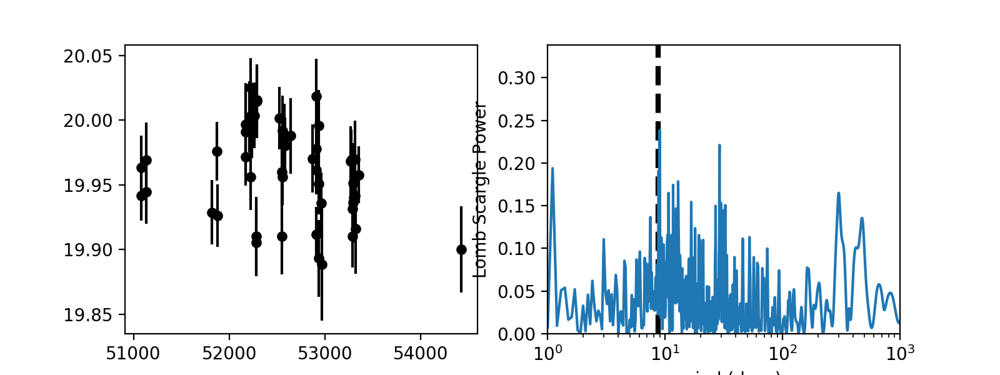

In [333]:
d = data_tosearch[3]

mask = (d["r"] > 0) & (d["r"]<22)
tai = d["tai"][mask,2]
rmag = d["r"][mask]
rerr = d["r_err"][mask]

model = periodic.LombScargle(fit_period=True)
model.optimizer.period_range = (p_min, p_max)
model.fit(tai, rmag, rerr)
print("Best period estimate: " + str(model.best_period))

periods = np.linspace(p_min, p_max, 10000)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    scores = model.score(periods)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 3))

ax1.errorbar(tai, rmag, yerr=rerr, fmt="o", markersize=5, c="black")

ax2.plot(periods, scores)
ax2.set(xlabel='period (days)', ylabel='Lomb Scargle Power',
       xlim=(p_min, p_max), ylim=(0, np.max(scores)+0.1))
ax2.set_xscale("log")
ax2.vlines(model.best_period, 0, np.max(scores)+0.1, lw=3, linestyle="dashed", color="black")



/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


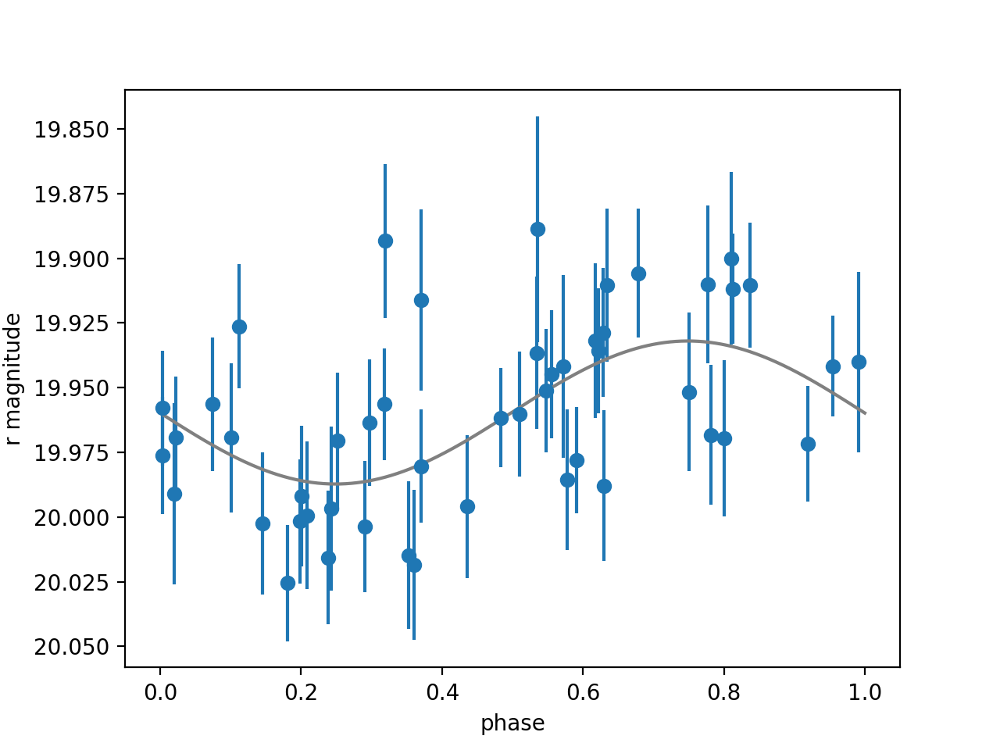

In [336]:
period = model.best_period

tfit = np.linspace(0, model.best_period, 1000)
magfit = model.predict(tfit)

# Plot the results
phase = (tai / period) % 1
phasefit = (tfit / period)

fig, ax = plt.subplots()
ax.errorbar(phase, rmag, rerr, fmt='o')
ax.plot(phasefit, magfit, '-', color='gray')
ax.set(xlabel='phase', ylabel='r magnitude')
ax.invert_yaxis()


## Multi-Band Lomb-Scargle

Let's try the multi-band Lomb-Scargle Periodogram, just for fun:

In [340]:
from gatspy import datasets, periodic

In [341]:
rrlyrae = datasets.fetch_rrlyrae()


In [342]:
lcid = rrlyrae.ids[0]

In [361]:
t, mag, dmag, filts = rrlyrae.get_lightcurve(lcid)

In [362]:
filts

array(['u', 'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r',
       'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u',
       'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i',
       'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g',
       'r', 'i', 'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u',
       'g', 'r', 'i', 'z', 'g', 'r', 'i', 'z', 'g', 'r', 'i', 'z', 'u',
       'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i',
       'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g',
       'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z',
       'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r',
       'i', 'z', 'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g',
       'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z',
       'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r', 'i', 'z', 'u', 'g', 'r',
       'i', 'z', 'u', 'g', 'r', 'i', 'u', 'g', 'r', 'i', 'z', 'u

In [407]:
np.array(list("ugriz"))

array(['u', 'g', 'r', 'i', 'z'], dtype='<U1')

i: 0
Finding optimal frequency:
 - Estimated peak width = 0.00188
 - Using 5 steps per peak; omega_step = 0.000375
 - User-specified period range:  1 to 1e+03
 - Computing periods at 16730 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Best period estimate: 2.832597465974007


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


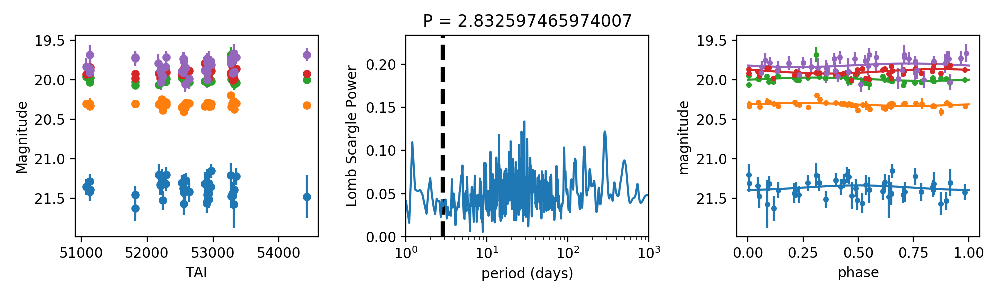

In [370]:
for i,d in enumerate(data_tosearch[:1]):
    print("i: " + str(i))
    
    # get data out of dictionary in a useful format
    mask = (d["r"] > 0) & (d["u"] > 0) & (d["g"]> 0) & (d["i"] > 0) & (d["z"] > 0)
    utai = d["tai"][mask,0]
    gtai = d["tai"][mask,1]
    rtai = d["tai"][mask,2]
    itai = d["tai"][mask,3]
    ztai = d["tai"][mask,4]

    umag = d["u"][mask]
    gmag = d["g"][mask]
    rmag = d["r"][mask]
    imag = d["i"][mask]
    zmag = d["z"][mask]
    
    ukey = np.array(["u" for u in umag])
    gkey = np.array(["g" for u in gmag])
    rkey = np.array(["r" for u in rmag])
    ikey = np.array(["i" for u in imag])
    zkey = np.array(["z" for u in zmag])
    
    uerr = d["u_err"][mask]
    gerr = d["g_err"][mask]
    rerr = d["r_err"][mask]
    ierr = d["i_err"][mask]
    zerr = d["z_err"][mask]

    # stack all the necessary measurements and filters
    mag = np.hstack([umag, gmag, rmag, imag, zmag])
    magerr = np.hstack([uerr, gerr, rerr, ierr, zerr])
    filters = np.hstack([ukey, gkey, rkey, ikey, zkey])
    time = np.hstack([utai, gtai, rtai, itai, ztai])
    
    # set up and fit multi-band Lomb-Scargle periodogram
    model = periodic.LombScargleMultiband(fit_period=True)
    model.optimizer.period_range = (p_min, p_max)
    model.fit(time, mag, magerr, filts=filters)
    print("Best period estimate: " + str(model.best_period))
    
    periods = np.linspace(p_min, p_max, 10000)

    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        scores = model.score(periods)

        
    period = model.best_period
    tfit = np.linspace(0, period, 1000)

    filtsfit = np.array(list('ugriz'))[:, np.newaxis]
    magfit = model.predict(tfit, filts=filtsfit)

    # Plot the results
    phase = (time / period) % 1
    phasefit = (tfit / period)


    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10, 3))

    ax1.errorbar(utai, umag, yerr=uerr, fmt="o", markersize=5, label="u")
    ax1.errorbar(gtai, gmag, yerr=gerr, fmt="o", markersize=5, label="g")
    ax1.errorbar(rtai, rmag, yerr=rerr, fmt="o", markersize=5, label="r")
    ax1.errorbar(itai, imag, yerr=ierr, fmt="o", markersize=5, label="i")
    ax1.errorbar(ztai, zmag, yerr=zerr, fmt="o", markersize=5, label="z")
    
    ax1.invert_yaxis()
    ax1.set_xlabel("TAI")
    ax1.set_ylabel("Magnitude")
    
    # plot Lomb-Scargle periodogram
    ax2.plot(periods, scores)
    ax2.set(xlabel='period (days)', ylabel='Lomb Scargle Power',
           xlim=(p_min, p_max), ylim=(0, np.max(scores)+0.1))
    ax2.set_xscale("log")
    ax2.vlines(model.best_period, 0, np.max(scores)+0.1, lw=3, linestyle="dashed", color="black")
    ax2.set_title("P = " + str(model.best_period))
    
    
    for i, filt in enumerate('ugriz'):
        m = (filters == filt)
        errorbar = ax3.errorbar(phase[m], mag[m], magerr[m], fmt='.')
        ax3.plot(phasefit, magfit[i], color=errorbar.lines[0].get_color())
    ax3.set(xlabel='phase', ylabel='magnitude')
    ax3.invert_yaxis()

    
    plt.tight_layout()
    print("\n")
    

Let's have some fun with the time series:

In [412]:
del data_good

In [408]:
import pickle

In [409]:
with open(datadir+"processed_lcs_20to50.dat", "rb") as f:
    data_all = pickle.load(f)

In [410]:
len(data_all)

316110

In [411]:
ndata = np.zeros(len(data_all))

for i,d in enumerate(data_all):
    ndata[i] = len(d["r"])

What's the distribution of the number of data points in this set?

/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


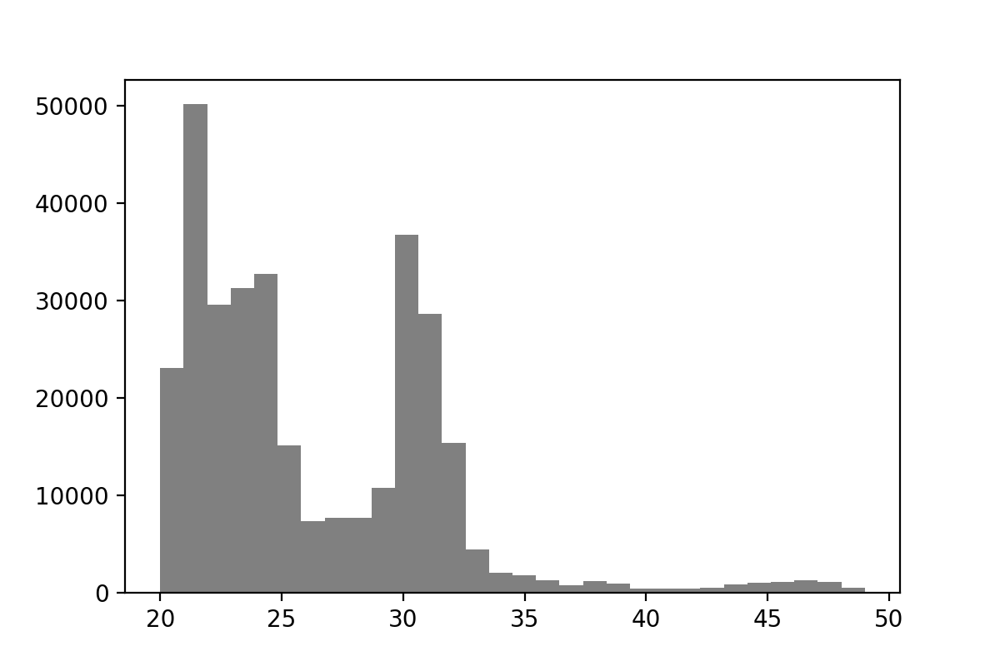

In [414]:
fig, ax = plt.subplots(1, 1, figsize=(6,4))
ax.hist(ndata, bins=30, histtype="stepfilled", color="gray");

There are some broken data points in my data: some of the magnitudes are 1000, which is clearly not true, so let's remove those:

In [459]:
for i in range(len(data_all)):
    mask = (data_all[i]["u"] < 40) & (data_all[i]["g"] < 40) & (data_all[i]["r"] < 40) & (data_all[i]["i"] < 40) & (data_all[i]["z"] < 40)
    data_all[i]["u"] = data_all[i]["u"][mask]
    data_all[i]["g"] = data_all[i]["g"][mask]
    data_all[i]["r"] = data_all[i]["r"][mask]
    data_all[i]["i"] = data_all[i]["i"][mask]
    data_all[i]["z"] = data_all[i]["z"][mask]

Now let's play around with decompositions for a bit:

In [415]:
from sklearn.decomposition import PCA

In [424]:
from sklearn.preprocessing import StandardScaler

In [469]:
u_all = np.array([d["u"][:20] for d in data_all if len(d["r"]) >= 20])
g_all = np.array([d["g"][:20] for d in data_all if len(d["r"]) >= 20])
r_all = np.array([d["r"][:20] for d in data_all if len(d["r"]) >= 20])
i_all = np.array([d["i"][:20] for d in data_all if len(d["r"]) >= 20])
z_all = np.array([d["z"][:20] for d in data_all if len(d["r"]) >= 20])

r_tai = np.array([d["tai"][:20,2] for d in data_all if len(d["r"]) >= 20])
rerr_all = np.array([d["r_err"][:20] for d in data_all if len(d["r"]) >= 20])

In [470]:
ug_color = u_all - g_all

ri_color = r_all - i_all

In [471]:
r_all.shape

(313703, 20)

In [472]:
r_scaled = StandardScaler().fit_transform(r_all)

In [473]:
pca = PCA(n_components=2)

r_pca = pca.fit_transform(r_all)

In [474]:
r_pca_scaled = pca.fit_transform(r_scaled)

/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


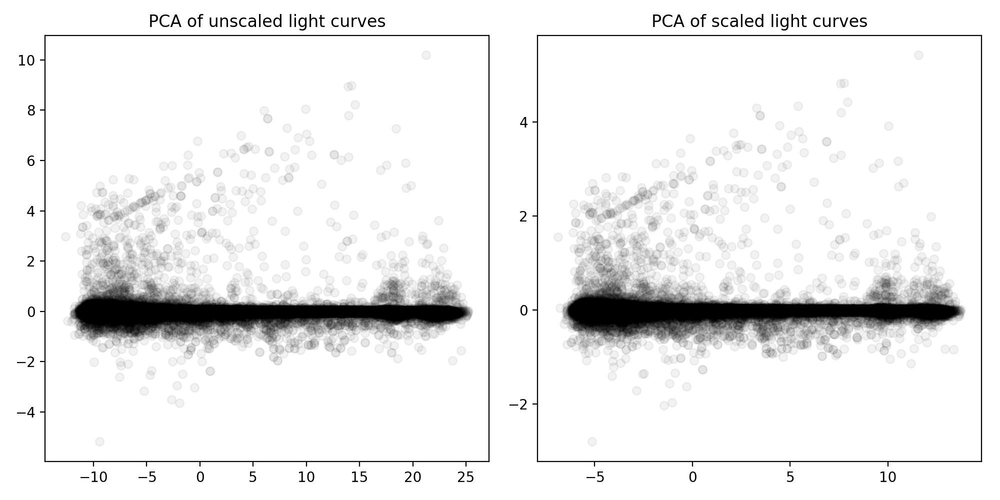

In [478]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))

ax1.scatter(r_pca[:,0], r_pca[:,1], c="black", alpha=0.05)
ax1.set_title("PCA of unscaled light curves")

ax2.scatter(r_pca_scaled[:,0], r_pca_scaled[:,1], c="black", alpha=0.05)
ax2.set_title("PCA of scaled light curves")

plt.tight_layout()


There isn't that much structure in those. Let's take a look at the ones that are far away from the zero point:

In [479]:
mask = (r_pca[:,1] > 1)

In [480]:
r_pca_masked = r_pca[mask]

Let's plot some example light curves:

In [482]:
r_tai_m = r_tai[mask]
r_mask = r_all[mask]
rerr_mask = rerr_all[mask]

re: [0.0164 0.012  0.0183 0.0146 0.0247 0.0171 0.0176 0.0191 0.0153 0.0146
 0.0217 0.0162 0.0172 0.0152 0.0165 0.0132 0.0217 0.014  0.0188 0.0187]


/Users/danielahuppenkothen/work/sw/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


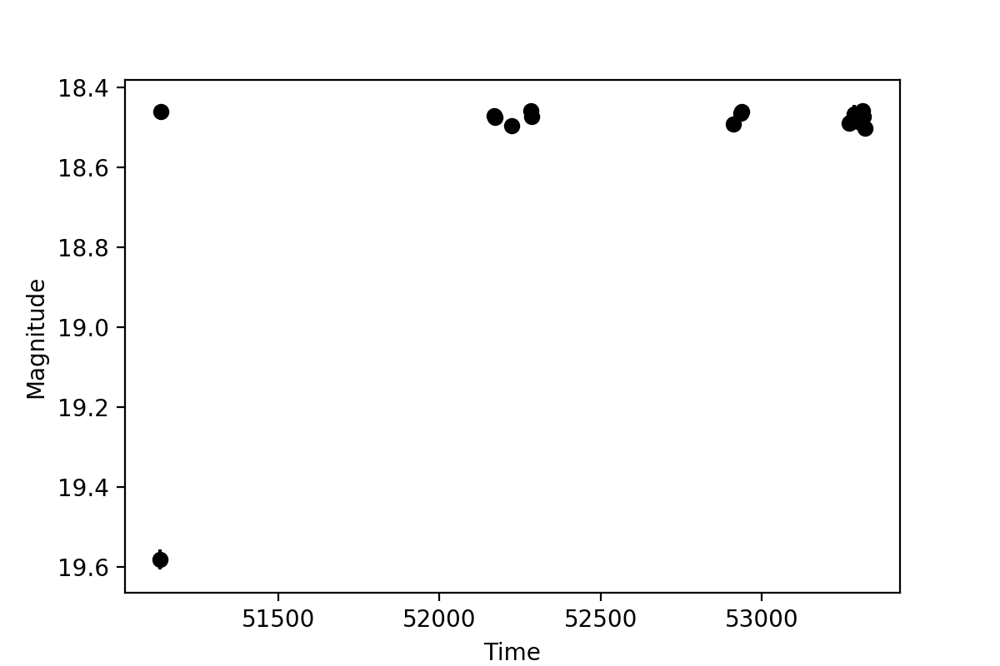

re: [8.0000e-04 1.2400e-02 8.0000e-04 3.3300e-02 1.4670e-01 1.1700e-02
 1.1200e-02 8.0000e-04 2.0000e-02 9.0000e-04 8.0000e-04 2.2300e-02
 8.0000e-04 3.0100e-02 1.3800e-02 1.9200e-02 1.0000e-03 8.8000e-03
 2.7962e+00 9.0000e-04]


<IPython.core.display.Javascript object>


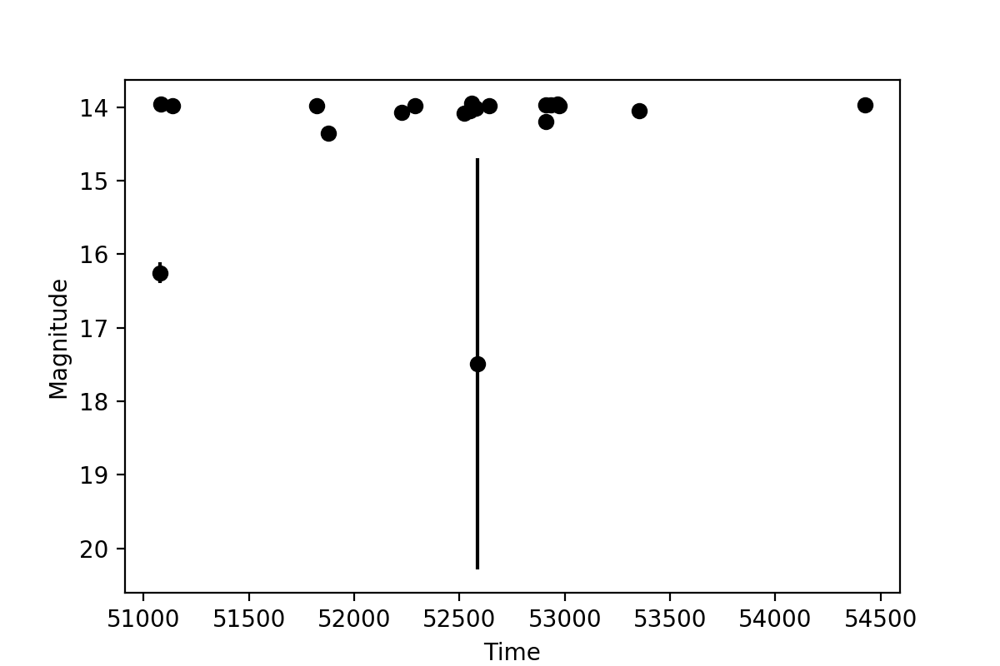

re: [0.0205 0.0172 0.0141 0.0191 0.0398 0.0159 0.0169 0.0228 0.0137 0.0254
 0.0267 0.011  0.016  0.0113 0.0178 0.0253 0.0246 0.0114 0.0177 0.0167]


<IPython.core.display.Javascript object>


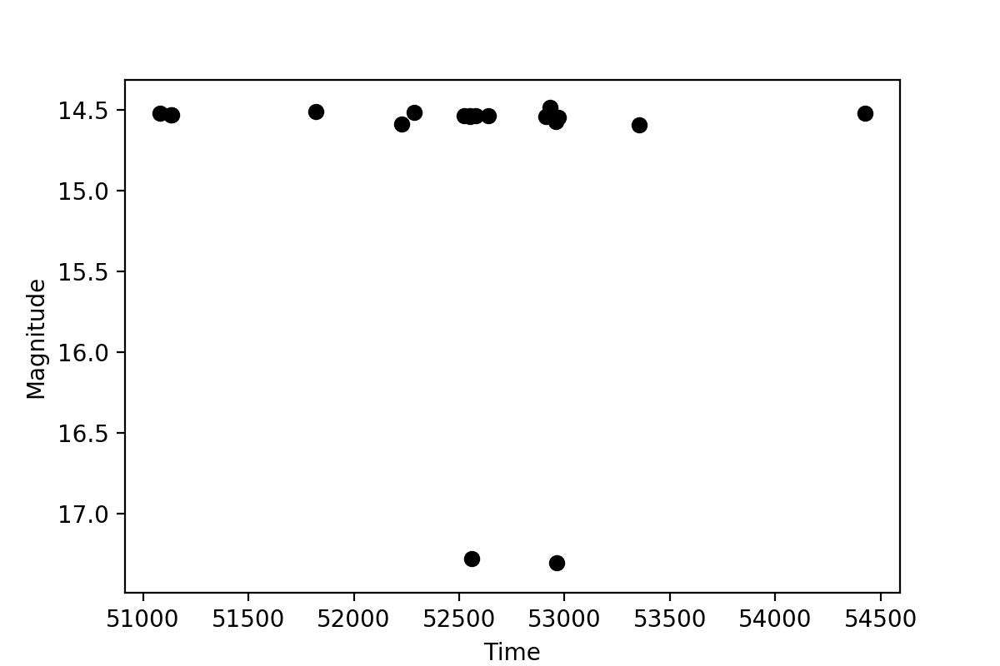

re: [0.0636 0.0446 0.0387 0.0356 0.487  0.0544 0.0352 0.0351 0.0412 0.0435
 0.0412 0.0339 0.0601 0.0663 0.0454 0.0611 0.0661 0.0449 0.0802 0.0487]


<IPython.core.display.Javascript object>


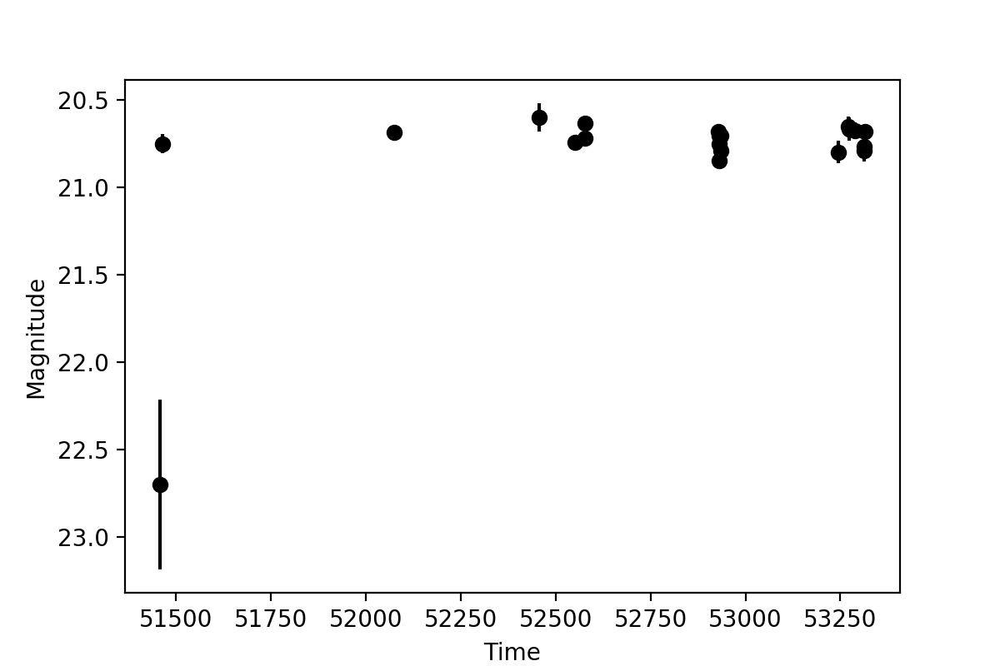

re: [0.0505 0.0533 0.0528 0.0579 0.1936 0.0779 0.0578 0.0632 0.0462 0.0487
 0.0467 0.0556 0.0581 0.0708 0.0874 0.0832 0.0874 0.0694 0.0746 0.0654]


<IPython.core.display.Javascript object>


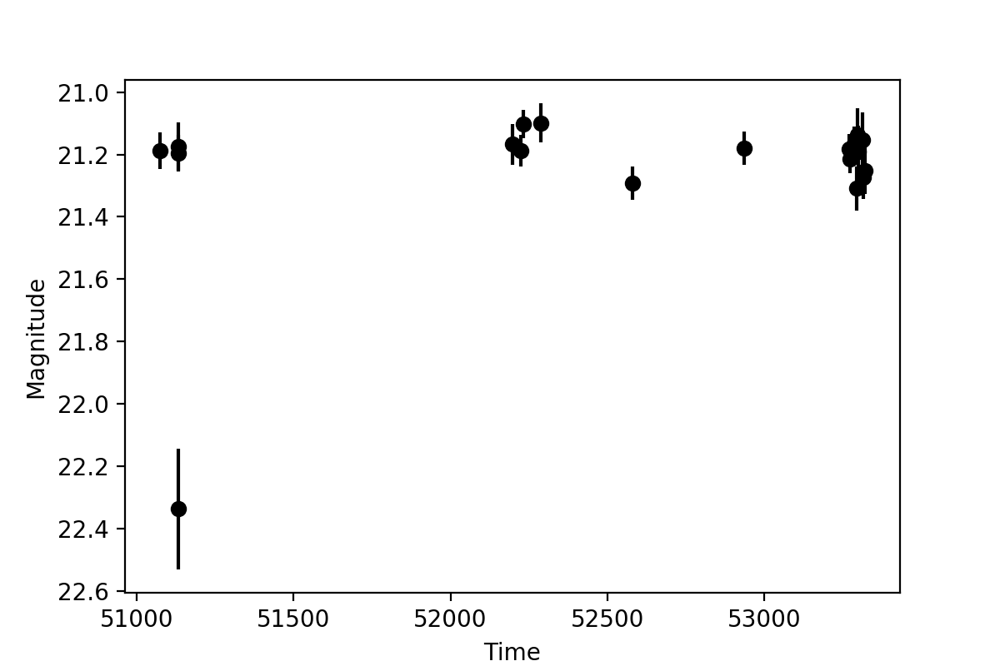

re: [0.0215 0.0163 0.0186 0.0201 0.0685 0.0148 0.018  0.019  0.0183 0.017
 0.0205 0.019  0.0182 0.0202 0.0206 0.0195 0.0228 0.0235 0.016  0.0157]


<IPython.core.display.Javascript object>


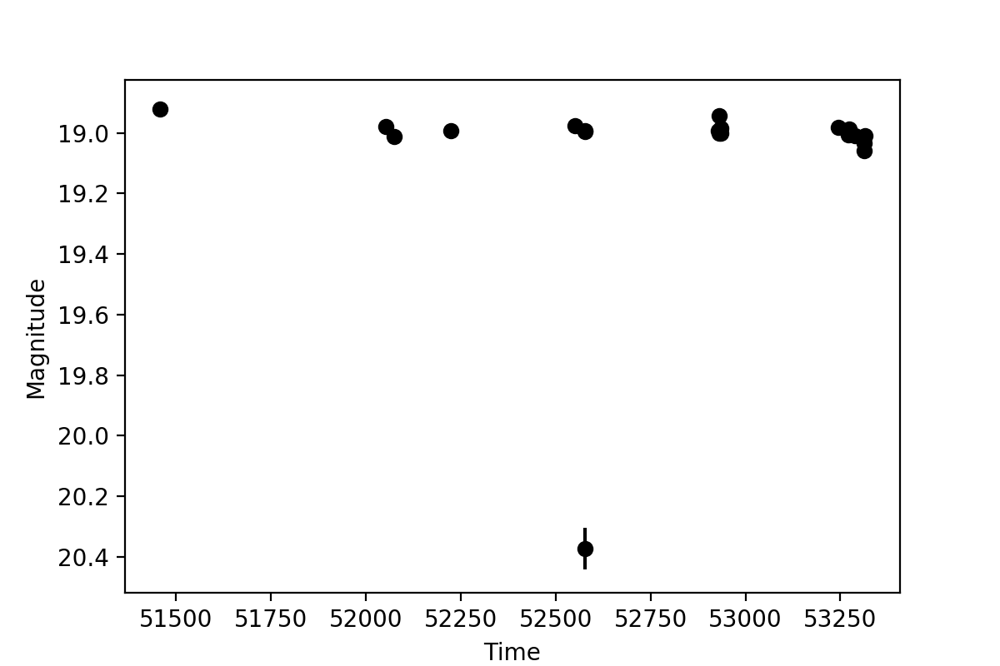

re: [0.0441 0.0697 0.0493 0.0431 0.4759 0.0653 0.0616 0.0728 0.0637 0.0739
 0.0576 0.0442 0.0513 0.0649 0.0414 0.0536 0.0519 0.0556 0.0523 0.0522]


<IPython.core.display.Javascript object>


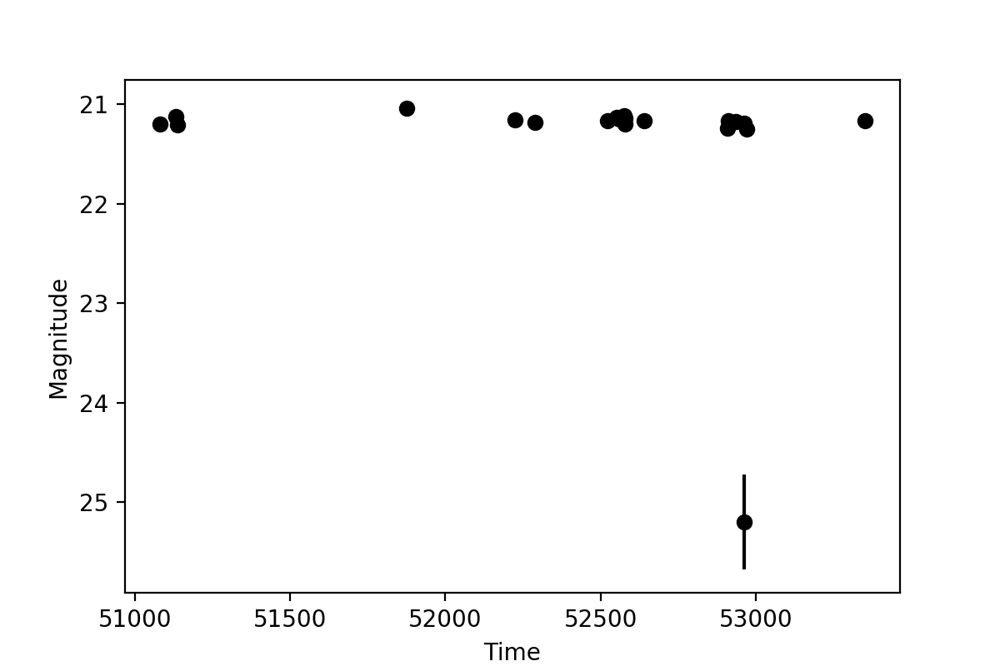

re: [0.0152 0.0226 0.0185 0.0196 0.0173 0.0363 0.0215 0.0133 0.0259 0.0164
 0.0195 0.0155 0.0192 0.0262 0.024  0.0146 0.0214 0.0123 0.0195 0.0155]


<IPython.core.display.Javascript object>


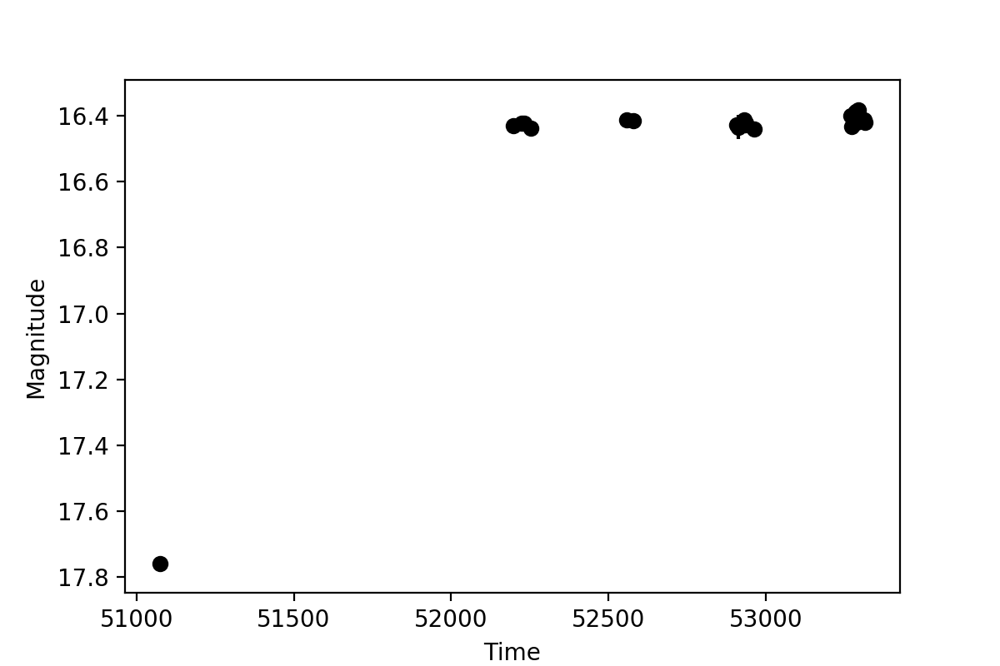

re: [0.0521 0.0447 0.0378 0.0536 0.2164 0.0547 0.0571 0.0527 0.0382 0.0551
 0.0548 0.0473 0.0404 0.0645 0.0672 0.0512 0.0467 0.0635 0.0505 0.0478]


<IPython.core.display.Javascript object>


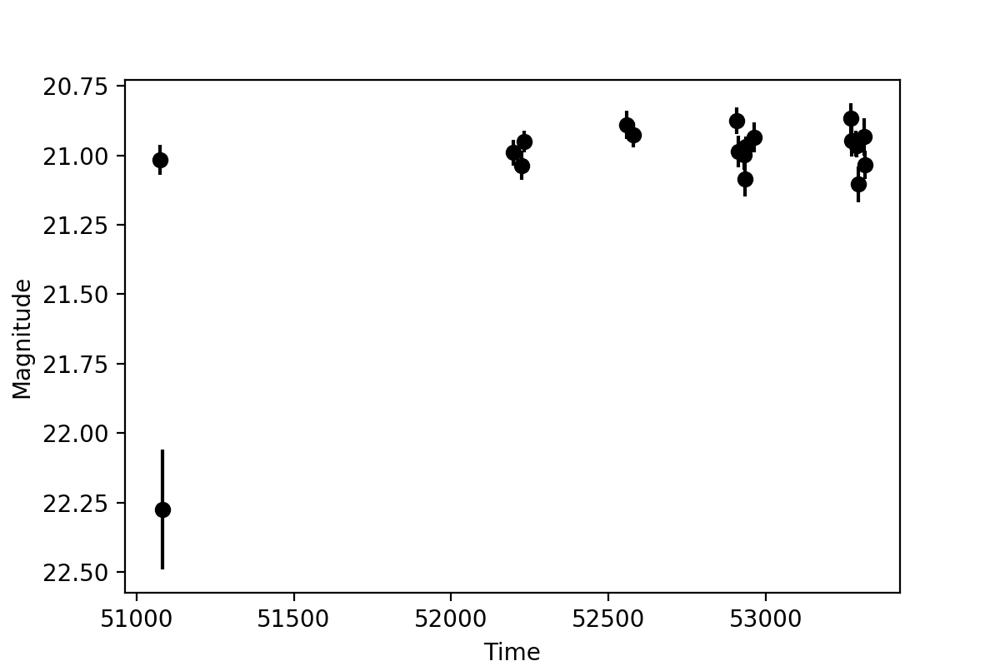

re: [0.0283 0.0273 0.0369 0.034  0.1842 0.0381 0.0273 0.0254 0.0231 0.0274
 0.0277 0.0318 4.7196 0.0229 0.0398 0.0285 0.0474 0.0285 0.0338 0.0367]


<IPython.core.display.Javascript object>


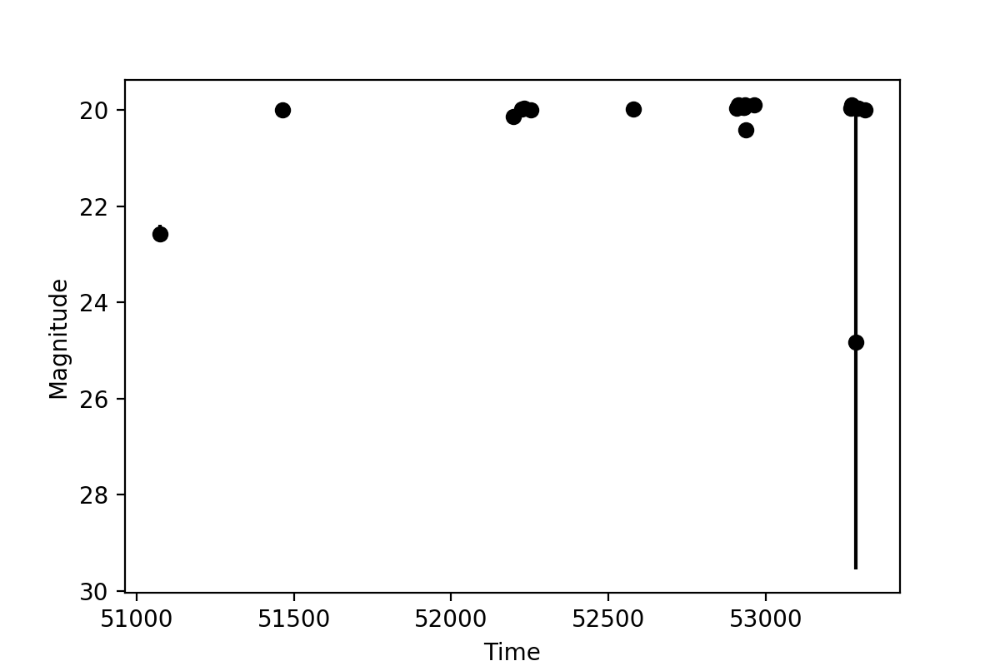

re: [0.0132 0.0091 0.0206 0.0136 1.1752 0.0121 0.0193 0.0155 0.0131 0.0126
 0.0166 0.0217 0.0169 0.0132 0.0122 0.0157 0.0232 0.0163 0.0285 0.015 ]


<IPython.core.display.Javascript object>


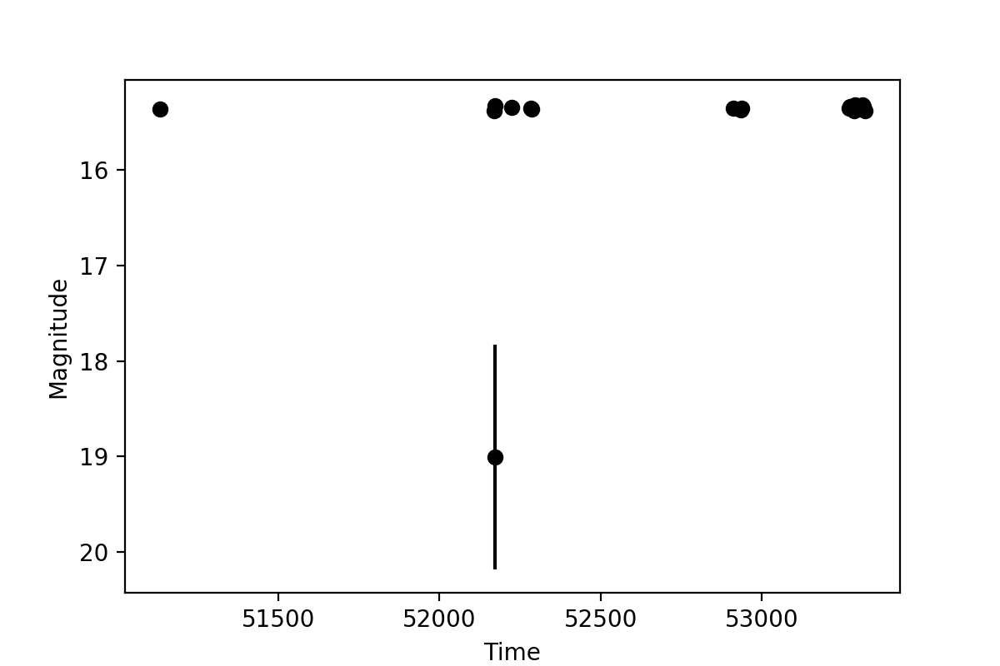

re: [0.0132 0.0072 0.0246 0.0189 0.0564 0.0265 0.0134 0.0127 0.0168 0.0172
 0.009  0.0031 0.0195 0.0141 0.0119 0.0185 0.0126 0.0148 0.0127 0.0186]


<IPython.core.display.Javascript object>


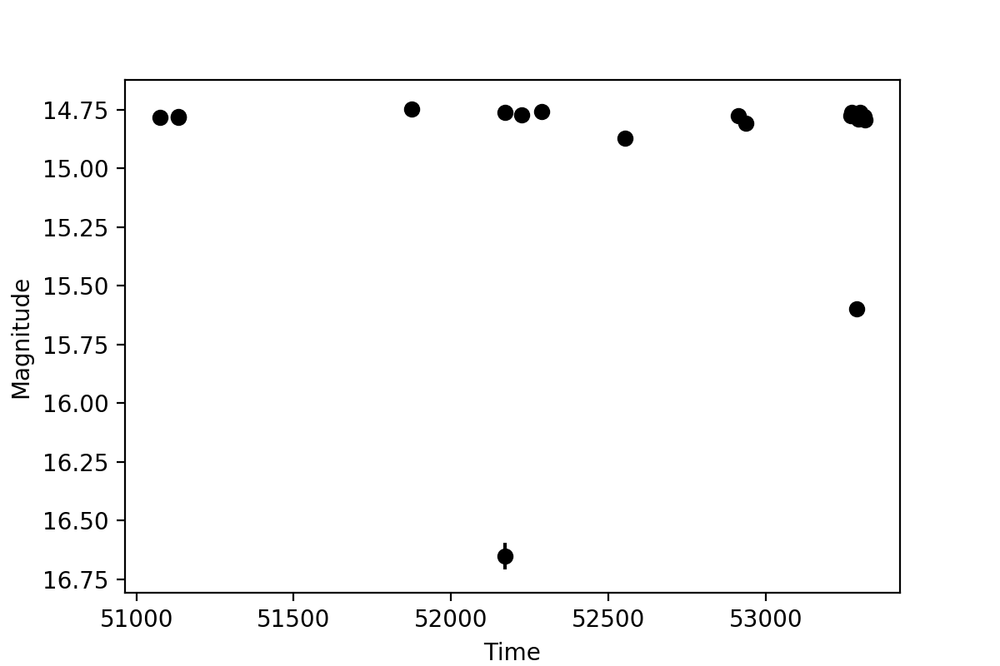

re: [0.0262 0.0293 0.0257 0.0206 0.1316 0.0242 0.0384 0.0289 0.0307 0.0272
 0.0228 0.0203 0.0326 0.0271 0.0234 0.0275 0.0325 0.024  0.0234 0.0262]


<IPython.core.display.Javascript object>


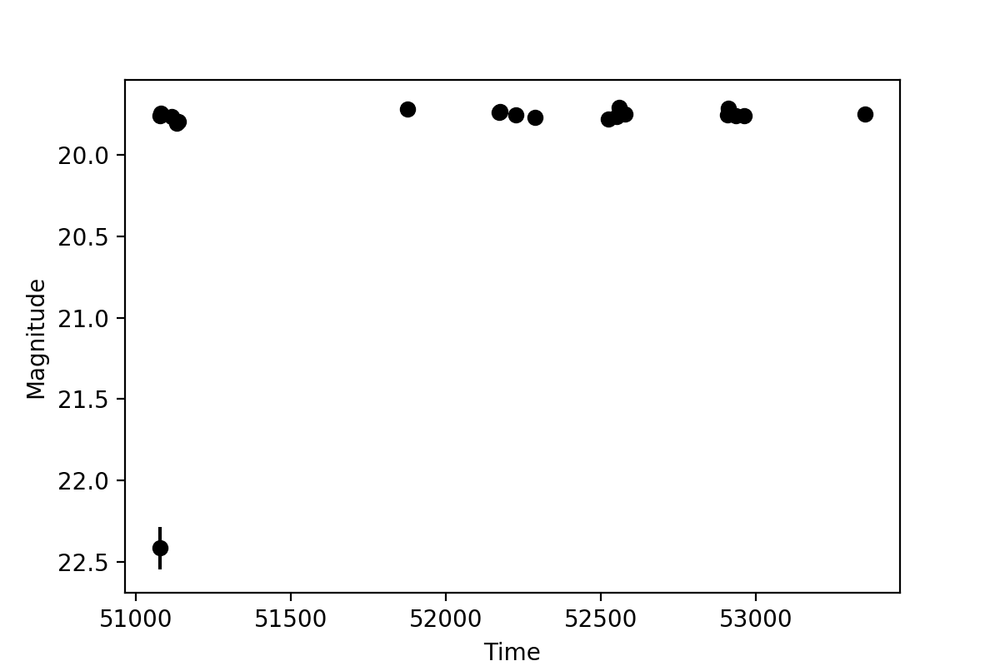

re: [0.0248 0.0244 0.0268 0.021  0.846  0.0243 0.0194 0.0261 0.0245 0.0255
 0.0294 0.0226 0.0305 0.0322 0.0278 0.0244 0.0207 0.0194 0.0235 0.0261]


<IPython.core.display.Javascript object>


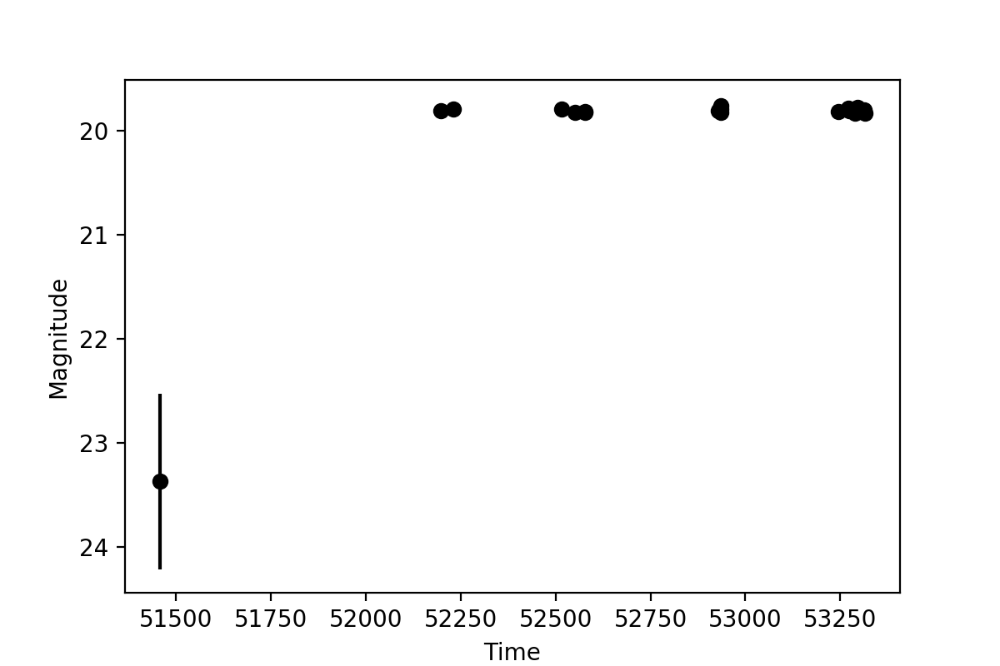

re: [0.0308 0.0321 0.0429 0.0377 0.5745 0.0481 0.0332 0.0411 0.0328 0.0329
 0.0314 0.0266 0.0317 0.0344 0.0324 0.0522 0.0502 0.0407 0.0439 0.0403]


<IPython.core.display.Javascript object>


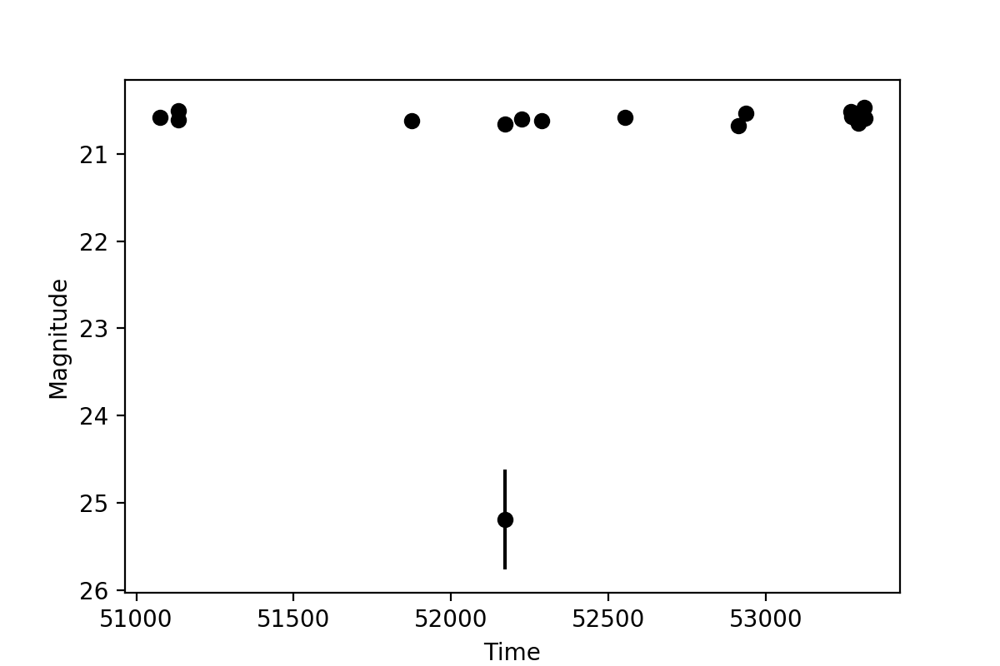

In [484]:
nexamples = 15
rand_idx = np.random.choice(np.arange(len(r_mask), dtype=int), replace=False, size=nexamples)

for i in rand_idx:
    t = r_tai_m[i]
    r = r_mask[i]
    re = rerr_mask[i]
    print("re: " + str(re))
    
    fig, ax = plt.subplots(1, 1, figsize=(6,4))
    
    ax.errorbar(t, r, yerr=re, fmt="o", color="black")
    ax.set(xlabel="Time", ylabel="Magnitude")
    ax.invert_yaxis()